# Deep Convolutional GANs

In this notebook, you'll build a GAN using convolutional layers in the generator and discriminator. This is called a Deep Convolutional GAN, or DCGAN for short. The DCGAN architecture was first explored last year and has seen impressive results in generating new images, you can read the [original paper here](https://arxiv.org/pdf/1511.06434.pdf).

You'll be training DCGAN on the [Street View House Numbers](http://ufldl.stanford.edu/housenumbers/) (SVHN) dataset. These are color images of house numbers collected from Google street view. SVHN images are in color and much more variable than MNIST. 

![SVHN Examples](assets/SVHN_examples.png)

So, we'll need a deeper and more powerful network. This is accomplished through using convolutional layers in the discriminator and generator. It's also necessary to use batch normalization to get the convolutional networks to train. The only real changes compared to what [you saw previously](https://github.com/udacity/deep-learning/tree/master/gan_mnist) are in the generator and discriminator, otherwise the rest of the implementation is the same.

In [1]:
%matplotlib inline

import pickle as pkl

import matplotlib.pyplot as plt
import numpy as np
from scipy.io import loadmat
import tensorflow as tf

In [2]:
!mkdir data

mkdir: cannot create directory 'data': File exists


## Getting the data

Here you can download the SVHN dataset. Run the cell above and it'll download to your machine.

In [3]:
from urllib.request import urlretrieve
from os.path import isfile, isdir

data_dir = 'data/'

if not isdir(data_dir):
    raise Exception("Data directory doesn't exist!")

if not isfile(data_dir + "train_32x32.mat"):
    urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/train_32x32.mat',
            data_dir + 'train_32x32.mat')

if not isfile(data_dir + "test_32x32.mat"):
    urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/test_32x32.mat',
            data_dir + 'test_32x32.mat')

These SVHN files are `.mat` files typically used with Matlab. However, we can load them in with `scipy.io.loadmat` which we imported above.

In [4]:
trainset = loadmat(data_dir + 'train_32x32.mat')
testset = loadmat(data_dir + 'test_32x32.mat')

Here I'm showing a small sample of the images. Each of these is 32x32 with 3 color channels (RGB). These are the real images we'll pass to the discriminator and what the generator will eventually fake.

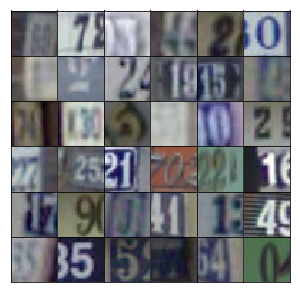

In [5]:
idx = np.random.randint(0, trainset['X'].shape[3], size=36)
fig, axes = plt.subplots(6, 6, sharex=True, sharey=True, figsize=(5,5),)
for ii, ax in zip(idx, axes.flatten()):
    ax.imshow(trainset['X'][:,:,:,ii], aspect='equal')
    ax.xaxis.set_visible(False)
    ax.yaxis.set_visible(False)
plt.subplots_adjust(wspace=0, hspace=0)

Here we need to do a bit of preprocessing and getting the images into a form where we can pass batches to the network. First off, we need to rescale the images to a range of -1 to 1, since the output of our generator is also in that range. We also have a set of test and validation images which could be used if we're trying to identify the numbers in the images.

In [6]:
def scale(x, feature_range=(-1, 1)):
    # scale to (0, 1)
    x = ((x - x.min())/(255 - x.min()))
    
    # scale to feature_range
    min, max = feature_range
    x = x * (max - min) + min
    return x

In [7]:
class Dataset:
    def __init__(self, train, test, val_frac=0.5, shuffle=False, scale_func=None):
        split_idx = int(len(test['y'])*(1 - val_frac))
        self.test_x, self.valid_x = test['X'][:,:,:,:split_idx], test['X'][:,:,:,split_idx:]
        self.test_y, self.valid_y = test['y'][:split_idx], test['y'][split_idx:]
        self.train_x, self.train_y = train['X'], train['y']
        
        self.train_x = np.rollaxis(self.train_x, 3)
        self.valid_x = np.rollaxis(self.valid_x, 3)
        self.test_x = np.rollaxis(self.test_x, 3)
        
        if scale_func is None:
            self.scaler = scale
        else:
            self.scaler = scale_func
        self.shuffle = shuffle
        
    def batches(self, batch_size):
        if self.shuffle:
            idx = np.arange(len(dataset.train_x))
            np.random.shuffle(idx)
            self.train_x = self.train_x[idx]
            self.train_y = self.train_y[idx]
        
        n_batches = len(self.train_y)//batch_size
        for ii in range(0, len(self.train_y), batch_size):
            x = self.train_x[ii:ii+batch_size]
            y = self.train_y[ii:ii+batch_size]
            
            yield self.scaler(x), y

## Network Inputs

Here, just creating some placeholders like normal.

In [8]:
def model_inputs(real_dim, z_dim):
    inputs_real = tf.placeholder(tf.float32, (None, *real_dim), name='input_real')
    inputs_z = tf.placeholder(tf.float32, (None, z_dim), name='input_z')
    
    return inputs_real, inputs_z

## Generator

Here you'll build the generator network. The input will be our noise vector `z` as before. Also as before, the output will be a $tanh$ output, but this time with size 32x32 which is the size of our SVHN images.

What's new here is we'll use convolutional layers to create our new images. The first layer is a fully connected layer which is reshaped into a deep and narrow layer, something like 4x4x1024 as in the original DCGAN paper. Then we use batch normalization and a leaky ReLU activation. Next is a transposed convolution where typically you'd halve the depth and double the width and height of the previous layer. Again, we use batch normalization and leaky ReLU. For each of these layers, the general scheme is convolution > batch norm > leaky ReLU.

You keep stacking layers up like this until you get the final transposed convolution layer with shape 32x32x3. Below is the archicture used in the original DCGAN paper:

![DCGAN Generator](assets/dcgan.png)

Note that the final layer here is 64x64x3, while for our SVHN dataset, we only want it to be 32x32x3. 

>**Exercise:** Build the transposed convolutional network for the generator in the function below. Be sure to use leaky ReLUs on all the layers except for the last tanh layer, as well as batch normalization on all the transposed convolutional layers except the last one.

In [99]:
KERNEL_SIZE = 5
STRIDE = 2

def leaky_relu(output, alpha):
    return tf.maximum(output, tf.multiply(output, alpha))

def conv2d_transpose(input_, filters, is_training, alpha):
    layer_output = tf.layers.conv2d_transpose(input_, filters=filters, kernel_size=KERNEL_SIZE, strides=STRIDE, use_bias=False, activation=None, padding='same')
    normalized_output = tf.layers.batch_normalization(layer_output, training=is_training)
    return leaky_relu(normalized_output, alpha)

def generator(z, output_dim, reuse=False, alpha=0.2, training=True):
    with tf.variable_scope('generator', reuse=reuse):
        # First fully connected layer
        fully_connected_output = tf.layers.dense(z, 4 * 4 * 512, activation=None)
        reshaped = tf.reshape(fully_connected_output, [-1, 4, 4, 512])
        normalized_fully_connected = tf.layers.batch_normalization(reshaped, training=training)
        fully_connected = leaky_relu(normalized_fully_connected, alpha)
        
        
        # Shape 4x4x512
        layer = conv2d_transpose(fully_connected, 256, training, alpha)
        # Shape 8x8x256
        layer = conv2d_transpose(layer, 128, training, alpha)
        # Shape 16x16x128
        
        # Output layer, 32x32x3
        logits = tf.layers.conv2d_transpose(layer, filters=3, kernel_size=KERNEL_SIZE, strides=STRIDE, use_bias=True, activation=None, padding='same')
        
        out = tf.tanh(logits)
        
        return out

## Discriminator

Here you'll build the discriminator. This is basically just a convolutional classifier like you've built before. The input to the discriminator are 32x32x3 tensors/images. You'll want a few convolutional layers, then a fully connected layer for the output. As before, we want a sigmoid output, and you'll need to return the logits as well. For the depths of the convolutional layers I suggest starting with 16, 32, 64 filters in the first layer, then double the depth as you add layers. Note that in the DCGAN paper, they did all the downsampling using only strided convolutional layers with no maxpool layers.

You'll also want to use batch normalization with `tf.layers.batch_normalization` on each layer except the first convolutional and output layers. Again, each layer should look something like convolution > batch norm > leaky ReLU.

Note: in this project, your batch normalization layers will always use batch statistics. (That is, always set `training` to `True`.) That's because we are only interested in using the discriminator to help train the generator. However, if you wanted to use the discriminator for inference later, then you would need to set the `training` parameter appropriately.

>**Exercise:** Build the convolutional network for the discriminator. The input is a 32x32x3 images, the output is a sigmoid plus the logits. Again, use Leaky ReLU activations and batch normalization on all the layers except the first.

In [100]:
def conv2d(input_, filters, alpha):
    layer_output = tf.layers.conv2d(input_, filters=filters, kernel_size=KERNEL_SIZE, strides=STRIDE, activation=None, use_bias=False, padding='same')
    normalized_output = tf.layers.batch_normalization(layer_output, training=True)
    return leaky_relu(normalized_output, alpha)

def discriminator(x, reuse=False, alpha=0.2):
    with tf.variable_scope('discriminator', reuse=reuse):
        # Input layer is 32x32x3
        x = tf.layers.conv2d(x, filters=64, kernel_size=KERNEL_SIZE, strides=STRIDE, activation=None, padding='same')
        layer = leaky_relu(x, alpha)
        # Shape 16x16x64
        
        layer = conv2d(layer, 128, alpha)
        # Shape 8x8x128
        
        layer = conv2d(layer, 256, alpha)
        # Shape 4x4x256
        
        reshaped = tf.reshape(layer, [-1, 4 * 4 * 256])
        # Shape 2048
        
        logits = tf.layers.dense(reshaped, 1)
        # Shape 1
        out = tf.sigmoid(logits)
        
        return out, logits

## Model Loss

Calculating the loss like before, nothing new here.

In [101]:
def model_loss(input_real, input_z, output_dim, alpha=0.2):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    g_model = generator(input_z, output_dim, alpha=alpha)
    d_model_real, d_logits_real = discriminator(input_real, alpha=alpha)
    d_model_fake, d_logits_fake = discriminator(g_model, reuse=True, alpha=alpha)

    d_loss_real = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real, labels=tf.ones_like(d_model_real)))
    d_loss_fake = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.zeros_like(d_model_fake)))
    g_loss = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.ones_like(d_model_fake)))

    d_loss = d_loss_real + d_loss_fake

    return d_loss, g_loss

## Optimizers

Not much new here, but notice how the train operations are wrapped in a `with tf.control_dependencies` block so the batch normalization layers can update their population statistics.

In [102]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    # Get weights and bias to update
    t_vars = tf.trainable_variables()
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    g_vars = [var for var in t_vars if var.name.startswith('generator')]

    # Optimize
    with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)):
        d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)
        g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(g_loss, var_list=g_vars)

    return d_train_opt, g_train_opt

## Building the model

Here we can use the functions we defined about to build the model as a class. This will make it easier to move the network around in our code since the nodes and operations in the graph are packaged in one object.

In [103]:
class GAN:
    def __init__(self, real_size, z_size, learning_rate, alpha=0.2, beta1=0.5):
        tf.reset_default_graph()
        
        self.input_real, self.input_z = model_inputs(real_size, z_size)
        
        self.d_loss, self.g_loss = model_loss(self.input_real, self.input_z,
                                              real_size[2], alpha=alpha)
        
        self.d_opt, self.g_opt = model_opt(self.d_loss, self.g_loss, learning_rate, beta1)

Here is a function for displaying generated images.

In [104]:
def view_samples(epoch, samples, nrows, ncols, figsize=(5,5)):
    fig, axes = plt.subplots(figsize=figsize, nrows=nrows, ncols=ncols, 
                             sharey=True, sharex=True)
    for ax, img in zip(axes.flatten(), samples[epoch]):
        ax.axis('off')
        img = ((img - img.min())*255 / (img.max() - img.min())).astype(np.uint8)
        ax.set_adjustable('box-forced')
        im = ax.imshow(img, aspect='equal')
   
    plt.subplots_adjust(wspace=0, hspace=0)
    return fig, axes

And another function we can use to train our network. Notice when we call `generator` to create the samples to display, we set `training` to `False`. That's so the batch normalization layers will use the population statistics rather than the batch statistics. Also notice that we set the `net.input_real` placeholder when we run the generator's optimizer. The generator doesn't actually use it, but we'd get an error without it because of the `tf.control_dependencies` block we created in `model_opt`. 

In [105]:
def train(net, dataset, epochs, batch_size, print_every=10, show_every=100, figsize=(5,5)):
    saver = tf.train.Saver()
    sample_z = np.random.uniform(-1, 1, size=(72, z_size))

    samples, losses = [], []
    steps = 0

    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for e in range(epochs):
            for x, y in dataset.batches(batch_size):
                steps += 1

                # Sample random noise for G
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_size))

                # Run optimizers
                _ = sess.run(net.d_opt, feed_dict={net.input_real: x, net.input_z: batch_z})
                _ = sess.run(net.g_opt, feed_dict={net.input_z: batch_z, net.input_real: x})

                if steps % print_every == 0:
                    # At the end of each epoch, get the losses and print them out
                    train_loss_d = net.d_loss.eval({net.input_z: batch_z, net.input_real: x})
                    train_loss_g = net.g_loss.eval({net.input_z: batch_z})

                    print("Epoch {}/{}...".format(e+1, epochs),
                          "Discriminator Loss: {:.4f}...".format(train_loss_d),
                          "Generator Loss: {:.4f}".format(train_loss_g))
                    # Save losses to view after training
                    losses.append((train_loss_d, train_loss_g))

                if steps % show_every == 0:
                    gen_samples = sess.run(
                                   generator(net.input_z, 3, reuse=True, training=False),
                                   feed_dict={net.input_z: sample_z})
                    samples.append(gen_samples)
                    _ = view_samples(-1, samples, 6, 12, figsize=figsize)
                    plt.show()

        saver.save(sess, './checkpoints/generator.ckpt')

    with open('samples.pkl', 'wb') as f:
        pkl.dump(samples, f)
    
    return losses, samples

## Hyperparameters

GANs are very sensitive to hyperparameters. A lot of experimentation goes into finding the best hyperparameters such that the generator and discriminator don't overpower each other. Try out your own hyperparameters or read [the DCGAN paper](https://arxiv.org/pdf/1511.06434.pdf) to see what worked for them.

>**Exercise:** Find hyperparameters to train this GAN. The values found in the DCGAN paper work well, or you can experiment on your own. In general, you want the discriminator loss to be around 0.3, this means it is correctly classifying images as fake or real about 50% of the time.

In [106]:
real_size = (32,32,3)
z_size = 100
learning_rate = 0.0002
batch_size = 128
epochs = 25
alpha = 0.2
beta1 = 0.5

# Create the network
net = GAN(real_size, z_size, learning_rate, alpha=alpha, beta1=beta1)

Epoch 1/25... Discriminator Loss: 1.1992... Generator Loss: 0.8939
Epoch 1/25... Discriminator Loss: 0.2915... Generator Loss: 5.0465
Epoch 1/25... Discriminator Loss: 0.3279... Generator Loss: 1.6166
Epoch 1/25... Discriminator Loss: 0.2038... Generator Loss: 2.2185
Epoch 1/25... Discriminator Loss: 0.1799... Generator Loss: 2.6953
Epoch 1/25... Discriminator Loss: 0.0856... Generator Loss: 3.0919
Epoch 1/25... Discriminator Loss: 0.1569... Generator Loss: 2.4463
Epoch 1/25... Discriminator Loss: 0.2250... Generator Loss: 2.3985
Epoch 1/25... Discriminator Loss: 0.1598... Generator Loss: 3.1715
Epoch 1/25... Discriminator Loss: 0.8405... Generator Loss: 1.1940


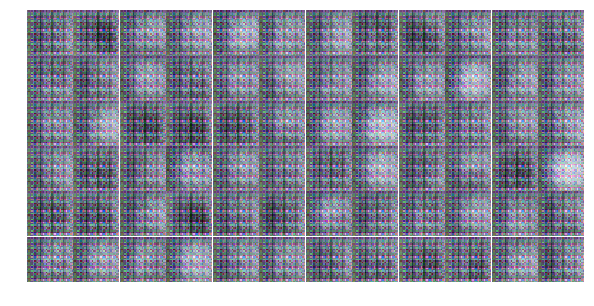

Epoch 1/25... Discriminator Loss: 0.5689... Generator Loss: 1.4442
Epoch 1/25... Discriminator Loss: 0.3526... Generator Loss: 1.9976
Epoch 1/25... Discriminator Loss: 0.5854... Generator Loss: 1.2657
Epoch 1/25... Discriminator Loss: 0.3098... Generator Loss: 2.5710
Epoch 1/25... Discriminator Loss: 0.5754... Generator Loss: 1.4468
Epoch 1/25... Discriminator Loss: 0.7256... Generator Loss: 0.8464
Epoch 1/25... Discriminator Loss: 0.7576... Generator Loss: 1.3177
Epoch 1/25... Discriminator Loss: 0.8845... Generator Loss: 0.7621
Epoch 1/25... Discriminator Loss: 0.3322... Generator Loss: 2.7785
Epoch 1/25... Discriminator Loss: 0.4804... Generator Loss: 2.0651


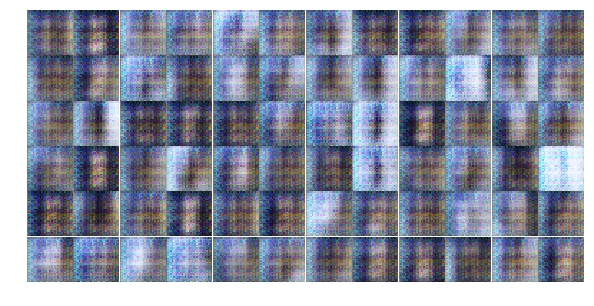

Epoch 1/25... Discriminator Loss: 0.6275... Generator Loss: 3.8415
Epoch 1/25... Discriminator Loss: 0.5992... Generator Loss: 1.9464
Epoch 1/25... Discriminator Loss: 0.8037... Generator Loss: 0.8011
Epoch 1/25... Discriminator Loss: 0.4816... Generator Loss: 2.9726
Epoch 1/25... Discriminator Loss: 0.4236... Generator Loss: 2.4667
Epoch 1/25... Discriminator Loss: 0.9318... Generator Loss: 1.1329
Epoch 1/25... Discriminator Loss: 0.5043... Generator Loss: 1.8738
Epoch 1/25... Discriminator Loss: 0.9546... Generator Loss: 1.1276
Epoch 1/25... Discriminator Loss: 0.8867... Generator Loss: 1.4520
Epoch 1/25... Discriminator Loss: 0.7001... Generator Loss: 1.0722


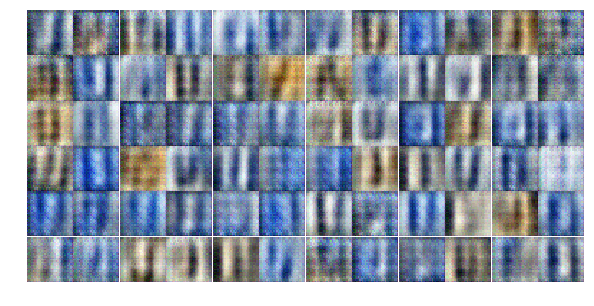

Epoch 1/25... Discriminator Loss: 0.8268... Generator Loss: 1.3526
Epoch 1/25... Discriminator Loss: 1.2226... Generator Loss: 0.8002
Epoch 1/25... Discriminator Loss: 0.8375... Generator Loss: 0.9618
Epoch 1/25... Discriminator Loss: 0.4291... Generator Loss: 1.9172
Epoch 1/25... Discriminator Loss: 0.6678... Generator Loss: 1.2788
Epoch 1/25... Discriminator Loss: 0.4114... Generator Loss: 1.8575
Epoch 1/25... Discriminator Loss: 0.4585... Generator Loss: 1.3992
Epoch 1/25... Discriminator Loss: 0.7057... Generator Loss: 1.4402
Epoch 1/25... Discriminator Loss: 0.3340... Generator Loss: 2.4951
Epoch 1/25... Discriminator Loss: 1.1675... Generator Loss: 0.6211


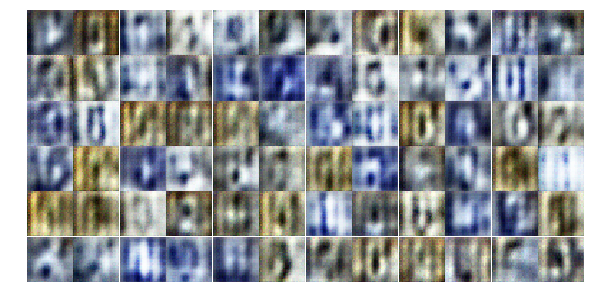

Epoch 1/25... Discriminator Loss: 0.4724... Generator Loss: 1.8333
Epoch 1/25... Discriminator Loss: 0.3245... Generator Loss: 2.4206
Epoch 1/25... Discriminator Loss: 0.2603... Generator Loss: 2.6854
Epoch 1/25... Discriminator Loss: 0.5355... Generator Loss: 4.2451
Epoch 1/25... Discriminator Loss: 0.7340... Generator Loss: 1.2439
Epoch 1/25... Discriminator Loss: 0.5450... Generator Loss: 1.2305
Epoch 1/25... Discriminator Loss: 0.3412... Generator Loss: 2.3811
Epoch 1/25... Discriminator Loss: 0.5715... Generator Loss: 1.2653
Epoch 1/25... Discriminator Loss: 0.4212... Generator Loss: 1.6509
Epoch 1/25... Discriminator Loss: 2.3201... Generator Loss: 0.2988


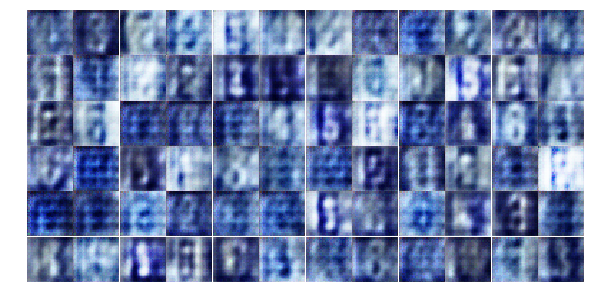

Epoch 1/25... Discriminator Loss: 1.0474... Generator Loss: 1.0341
Epoch 1/25... Discriminator Loss: 0.6676... Generator Loss: 1.3111
Epoch 1/25... Discriminator Loss: 0.5522... Generator Loss: 1.4666
Epoch 1/25... Discriminator Loss: 0.8782... Generator Loss: 0.9745
Epoch 1/25... Discriminator Loss: 0.6094... Generator Loss: 1.3589
Epoch 1/25... Discriminator Loss: 0.5014... Generator Loss: 1.5369
Epoch 1/25... Discriminator Loss: 0.5469... Generator Loss: 1.7014
Epoch 2/25... Discriminator Loss: 0.6616... Generator Loss: 1.3045
Epoch 2/25... Discriminator Loss: 0.7367... Generator Loss: 2.0602
Epoch 2/25... Discriminator Loss: 1.1272... Generator Loss: 0.9823


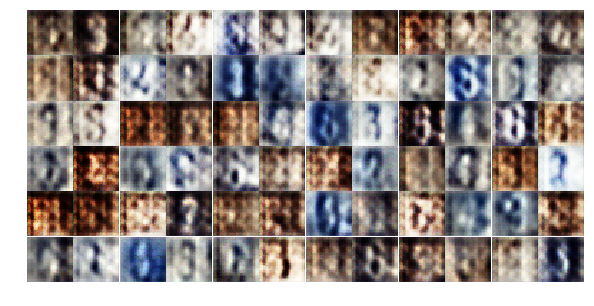

Epoch 2/25... Discriminator Loss: 1.0474... Generator Loss: 1.1655
Epoch 2/25... Discriminator Loss: 0.6408... Generator Loss: 1.3395
Epoch 2/25... Discriminator Loss: 1.2668... Generator Loss: 1.0599
Epoch 2/25... Discriminator Loss: 0.7581... Generator Loss: 1.4275
Epoch 2/25... Discriminator Loss: 1.0753... Generator Loss: 1.0155
Epoch 2/25... Discriminator Loss: 0.9751... Generator Loss: 1.5219
Epoch 2/25... Discriminator Loss: 0.8656... Generator Loss: 1.1153
Epoch 2/25... Discriminator Loss: 0.8031... Generator Loss: 1.4370
Epoch 2/25... Discriminator Loss: 0.8948... Generator Loss: 1.5114
Epoch 2/25... Discriminator Loss: 0.8545... Generator Loss: 1.1363


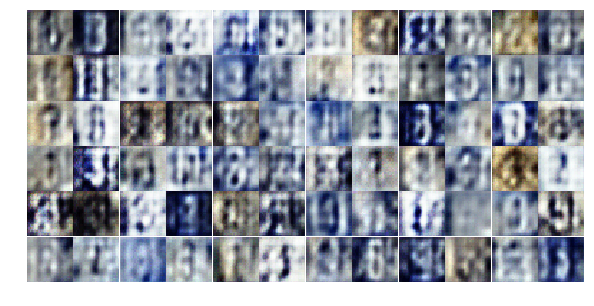

Epoch 2/25... Discriminator Loss: 0.6744... Generator Loss: 1.2224
Epoch 2/25... Discriminator Loss: 0.9735... Generator Loss: 1.1801
Epoch 2/25... Discriminator Loss: 0.9073... Generator Loss: 1.1709
Epoch 2/25... Discriminator Loss: 0.7729... Generator Loss: 1.2402
Epoch 2/25... Discriminator Loss: 1.0100... Generator Loss: 1.0290
Epoch 2/25... Discriminator Loss: 0.9802... Generator Loss: 1.0427
Epoch 2/25... Discriminator Loss: 1.0533... Generator Loss: 1.2898
Epoch 2/25... Discriminator Loss: 1.0792... Generator Loss: 0.8402
Epoch 2/25... Discriminator Loss: 1.1279... Generator Loss: 0.9050
Epoch 2/25... Discriminator Loss: 1.4252... Generator Loss: 0.5010


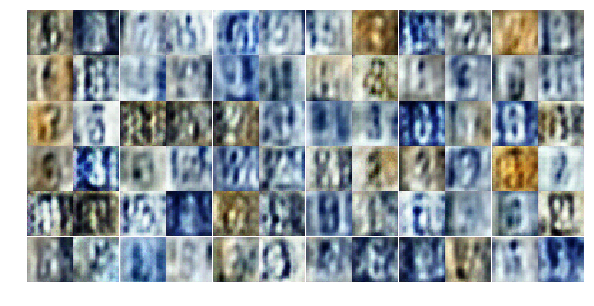

Epoch 2/25... Discriminator Loss: 1.2776... Generator Loss: 0.8244
Epoch 2/25... Discriminator Loss: 1.2738... Generator Loss: 0.8457
Epoch 2/25... Discriminator Loss: 0.6745... Generator Loss: 1.3415
Epoch 2/25... Discriminator Loss: 1.0172... Generator Loss: 1.5864
Epoch 2/25... Discriminator Loss: 0.9429... Generator Loss: 1.0324
Epoch 2/25... Discriminator Loss: 0.6955... Generator Loss: 1.2305
Epoch 2/25... Discriminator Loss: 0.9883... Generator Loss: 1.0702
Epoch 2/25... Discriminator Loss: 1.3562... Generator Loss: 0.5394
Epoch 2/25... Discriminator Loss: 0.9931... Generator Loss: 1.1845
Epoch 2/25... Discriminator Loss: 1.0498... Generator Loss: 1.0549


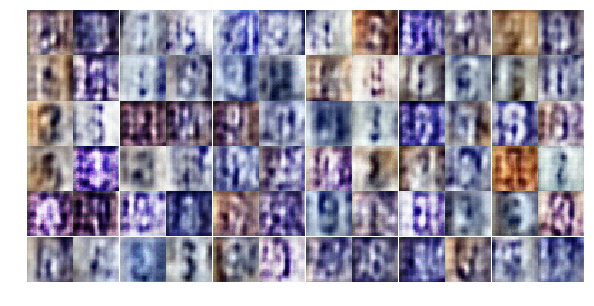

Epoch 2/25... Discriminator Loss: 0.9464... Generator Loss: 1.0434
Epoch 2/25... Discriminator Loss: 0.9753... Generator Loss: 1.3186
Epoch 2/25... Discriminator Loss: 1.2173... Generator Loss: 0.7046
Epoch 2/25... Discriminator Loss: 0.9971... Generator Loss: 1.0106
Epoch 2/25... Discriminator Loss: 0.9701... Generator Loss: 1.6578
Epoch 2/25... Discriminator Loss: 1.3761... Generator Loss: 0.6918
Epoch 2/25... Discriminator Loss: 1.2435... Generator Loss: 0.8709
Epoch 2/25... Discriminator Loss: 0.8378... Generator Loss: 1.7714
Epoch 2/25... Discriminator Loss: 1.0150... Generator Loss: 0.9729
Epoch 2/25... Discriminator Loss: 0.9228... Generator Loss: 1.0846


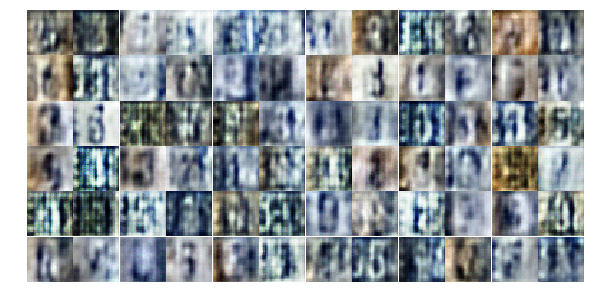

Epoch 2/25... Discriminator Loss: 0.9465... Generator Loss: 1.1140
Epoch 2/25... Discriminator Loss: 1.2481... Generator Loss: 0.7705
Epoch 2/25... Discriminator Loss: 0.8420... Generator Loss: 1.5110
Epoch 2/25... Discriminator Loss: 1.0343... Generator Loss: 0.9724
Epoch 2/25... Discriminator Loss: 1.0170... Generator Loss: 1.1749
Epoch 2/25... Discriminator Loss: 1.5619... Generator Loss: 0.5120
Epoch 2/25... Discriminator Loss: 1.3394... Generator Loss: 1.9226
Epoch 2/25... Discriminator Loss: 0.7992... Generator Loss: 1.0657
Epoch 2/25... Discriminator Loss: 0.8927... Generator Loss: 1.2233
Epoch 2/25... Discriminator Loss: 0.9095... Generator Loss: 1.3036


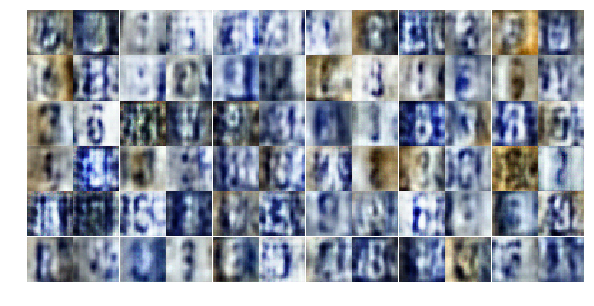

Epoch 2/25... Discriminator Loss: 0.8241... Generator Loss: 1.1672
Epoch 2/25... Discriminator Loss: 0.9322... Generator Loss: 0.9677
Epoch 2/25... Discriminator Loss: 0.9933... Generator Loss: 0.8198
Epoch 2/25... Discriminator Loss: 1.0856... Generator Loss: 0.9275
Epoch 3/25... Discriminator Loss: 0.7709... Generator Loss: 1.6317
Epoch 3/25... Discriminator Loss: 0.7918... Generator Loss: 1.0262
Epoch 3/25... Discriminator Loss: 0.6097... Generator Loss: 1.8970
Epoch 3/25... Discriminator Loss: 1.0449... Generator Loss: 0.7787
Epoch 3/25... Discriminator Loss: 0.5368... Generator Loss: 1.5525
Epoch 3/25... Discriminator Loss: 0.7414... Generator Loss: 1.2565


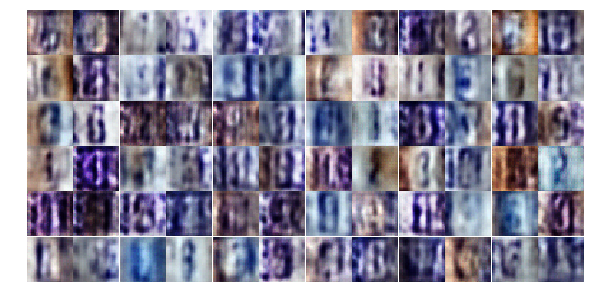

Epoch 3/25... Discriminator Loss: 0.6881... Generator Loss: 1.3783
Epoch 3/25... Discriminator Loss: 0.7040... Generator Loss: 1.3560
Epoch 3/25... Discriminator Loss: 0.8175... Generator Loss: 1.3295
Epoch 3/25... Discriminator Loss: 1.0997... Generator Loss: 0.7107
Epoch 3/25... Discriminator Loss: 0.9712... Generator Loss: 1.2984
Epoch 3/25... Discriminator Loss: 1.0312... Generator Loss: 0.8120
Epoch 3/25... Discriminator Loss: 0.7728... Generator Loss: 1.0611
Epoch 3/25... Discriminator Loss: 0.6650... Generator Loss: 1.8373
Epoch 3/25... Discriminator Loss: 0.8277... Generator Loss: 0.9276
Epoch 3/25... Discriminator Loss: 1.0557... Generator Loss: 0.8581


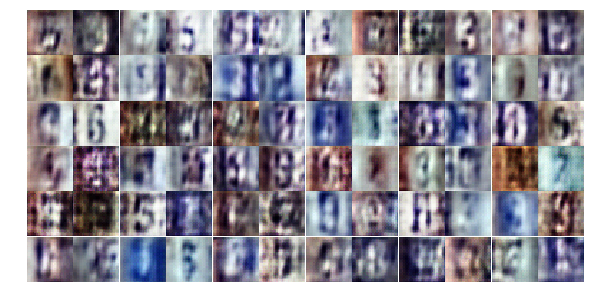

Epoch 3/25... Discriminator Loss: 0.8422... Generator Loss: 1.2253
Epoch 3/25... Discriminator Loss: 0.8300... Generator Loss: 0.9996
Epoch 3/25... Discriminator Loss: 1.2428... Generator Loss: 0.5482
Epoch 3/25... Discriminator Loss: 1.7969... Generator Loss: 0.2829
Epoch 3/25... Discriminator Loss: 0.7625... Generator Loss: 1.1913
Epoch 3/25... Discriminator Loss: 0.5249... Generator Loss: 1.7858
Epoch 3/25... Discriminator Loss: 0.9041... Generator Loss: 0.7633
Epoch 3/25... Discriminator Loss: 0.6782... Generator Loss: 1.7475
Epoch 3/25... Discriminator Loss: 0.5383... Generator Loss: 1.6714
Epoch 3/25... Discriminator Loss: 0.9160... Generator Loss: 0.9040


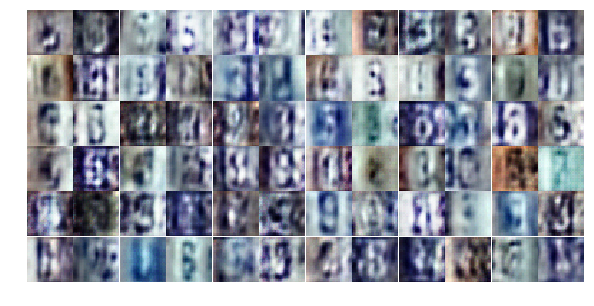

Epoch 3/25... Discriminator Loss: 0.9143... Generator Loss: 1.3390
Epoch 3/25... Discriminator Loss: 0.4890... Generator Loss: 2.2328
Epoch 3/25... Discriminator Loss: 0.6713... Generator Loss: 1.3477
Epoch 3/25... Discriminator Loss: 0.6746... Generator Loss: 1.2897
Epoch 3/25... Discriminator Loss: 0.7271... Generator Loss: 1.1340
Epoch 3/25... Discriminator Loss: 1.1404... Generator Loss: 0.6266
Epoch 3/25... Discriminator Loss: 0.7643... Generator Loss: 1.3782
Epoch 3/25... Discriminator Loss: 0.7620... Generator Loss: 1.4457
Epoch 3/25... Discriminator Loss: 0.9477... Generator Loss: 1.5530
Epoch 3/25... Discriminator Loss: 0.8221... Generator Loss: 0.8301


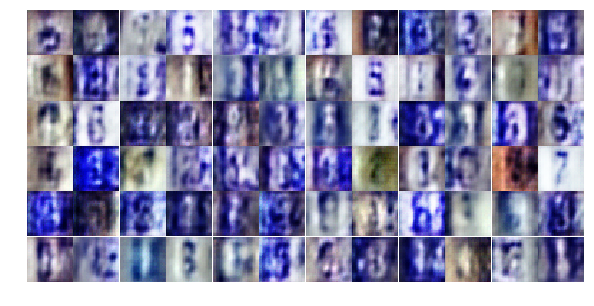

Epoch 3/25... Discriminator Loss: 0.7719... Generator Loss: 2.6574
Epoch 3/25... Discriminator Loss: 0.6468... Generator Loss: 1.3697
Epoch 3/25... Discriminator Loss: 1.1822... Generator Loss: 0.8601
Epoch 3/25... Discriminator Loss: 1.0697... Generator Loss: 0.6847
Epoch 3/25... Discriminator Loss: 0.5378... Generator Loss: 1.9960
Epoch 3/25... Discriminator Loss: 1.7480... Generator Loss: 3.4617
Epoch 3/25... Discriminator Loss: 0.7167... Generator Loss: 1.2588
Epoch 3/25... Discriminator Loss: 0.7162... Generator Loss: 1.2356
Epoch 3/25... Discriminator Loss: 0.6028... Generator Loss: 1.6424
Epoch 3/25... Discriminator Loss: 0.8546... Generator Loss: 1.5400


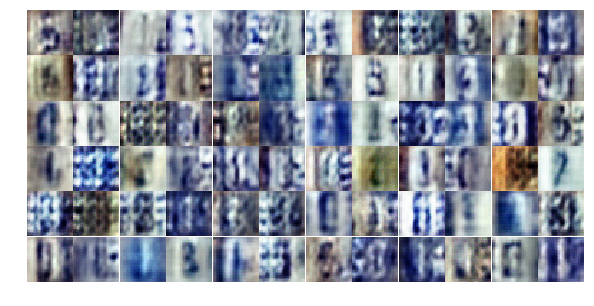

Epoch 3/25... Discriminator Loss: 0.6625... Generator Loss: 1.1539
Epoch 3/25... Discriminator Loss: 0.9851... Generator Loss: 1.7500
Epoch 3/25... Discriminator Loss: 0.6952... Generator Loss: 1.1787
Epoch 3/25... Discriminator Loss: 0.5602... Generator Loss: 1.5848
Epoch 3/25... Discriminator Loss: 0.6449... Generator Loss: 1.9814
Epoch 3/25... Discriminator Loss: 0.4300... Generator Loss: 1.7710
Epoch 3/25... Discriminator Loss: 0.4873... Generator Loss: 1.8217
Epoch 3/25... Discriminator Loss: 0.6858... Generator Loss: 1.7477
Epoch 3/25... Discriminator Loss: 0.6450... Generator Loss: 1.9237
Epoch 3/25... Discriminator Loss: 0.8145... Generator Loss: 1.6703


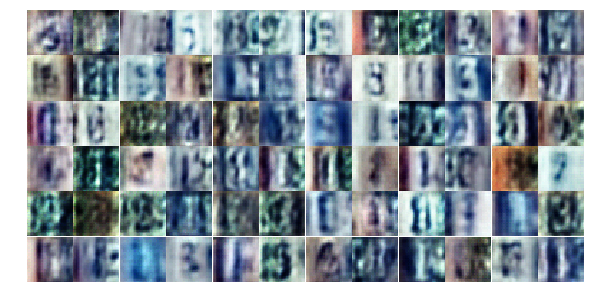

Epoch 3/25... Discriminator Loss: 0.8672... Generator Loss: 0.9013
Epoch 4/25... Discriminator Loss: 0.7669... Generator Loss: 1.1403
Epoch 4/25... Discriminator Loss: 0.7948... Generator Loss: 1.1940
Epoch 4/25... Discriminator Loss: 1.0661... Generator Loss: 0.5848
Epoch 4/25... Discriminator Loss: 0.6830... Generator Loss: 2.3142
Epoch 4/25... Discriminator Loss: 0.6428... Generator Loss: 1.2181
Epoch 4/25... Discriminator Loss: 0.6002... Generator Loss: 1.9163
Epoch 4/25... Discriminator Loss: 0.6992... Generator Loss: 1.4940
Epoch 4/25... Discriminator Loss: 0.4744... Generator Loss: 2.1919
Epoch 4/25... Discriminator Loss: 0.6281... Generator Loss: 2.1329


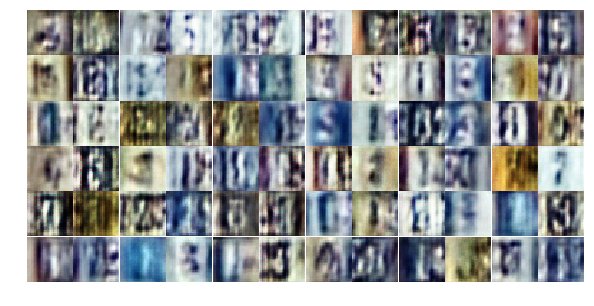

Epoch 4/25... Discriminator Loss: 0.6165... Generator Loss: 1.3989
Epoch 4/25... Discriminator Loss: 1.3121... Generator Loss: 3.0848
Epoch 4/25... Discriminator Loss: 0.8547... Generator Loss: 1.2923
Epoch 4/25... Discriminator Loss: 0.6196... Generator Loss: 2.3911
Epoch 4/25... Discriminator Loss: 0.7951... Generator Loss: 1.0983
Epoch 4/25... Discriminator Loss: 0.7918... Generator Loss: 0.9461
Epoch 4/25... Discriminator Loss: 1.2325... Generator Loss: 0.5555
Epoch 4/25... Discriminator Loss: 0.5035... Generator Loss: 1.9493
Epoch 4/25... Discriminator Loss: 0.7061... Generator Loss: 1.6619
Epoch 4/25... Discriminator Loss: 0.4818... Generator Loss: 2.0169


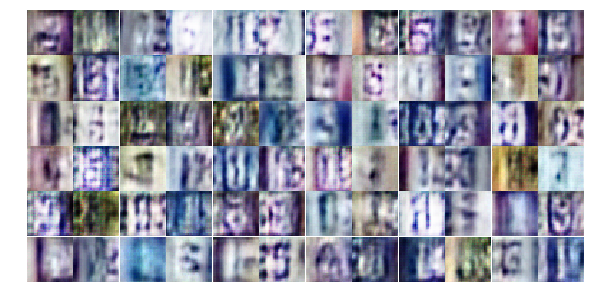

Epoch 4/25... Discriminator Loss: 0.6262... Generator Loss: 1.3894
Epoch 4/25... Discriminator Loss: 0.6719... Generator Loss: 1.0664
Epoch 4/25... Discriminator Loss: 0.6257... Generator Loss: 1.0908
Epoch 4/25... Discriminator Loss: 0.5739... Generator Loss: 1.2530
Epoch 4/25... Discriminator Loss: 0.4001... Generator Loss: 1.6010
Epoch 4/25... Discriminator Loss: 0.6988... Generator Loss: 3.0476
Epoch 4/25... Discriminator Loss: 0.5134... Generator Loss: 1.3803
Epoch 4/25... Discriminator Loss: 0.5512... Generator Loss: 1.3360
Epoch 4/25... Discriminator Loss: 0.5012... Generator Loss: 2.1440
Epoch 4/25... Discriminator Loss: 0.6853... Generator Loss: 3.4869


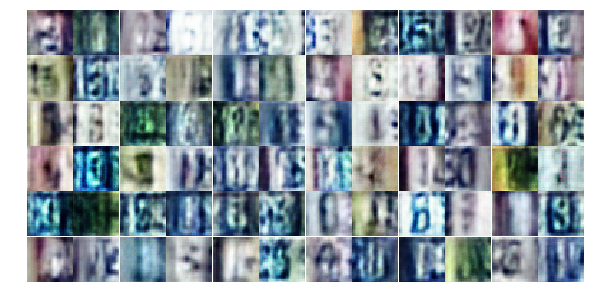

Epoch 4/25... Discriminator Loss: 0.5383... Generator Loss: 1.4956
Epoch 4/25... Discriminator Loss: 0.6485... Generator Loss: 1.2460
Epoch 4/25... Discriminator Loss: 0.7117... Generator Loss: 0.9057
Epoch 4/25... Discriminator Loss: 0.4295... Generator Loss: 1.4552
Epoch 4/25... Discriminator Loss: 0.3836... Generator Loss: 2.6765
Epoch 4/25... Discriminator Loss: 0.4476... Generator Loss: 2.5304
Epoch 4/25... Discriminator Loss: 0.5107... Generator Loss: 1.8926
Epoch 4/25... Discriminator Loss: 1.7904... Generator Loss: 0.2487
Epoch 4/25... Discriminator Loss: 0.3935... Generator Loss: 2.2931
Epoch 4/25... Discriminator Loss: 0.7729... Generator Loss: 0.9149


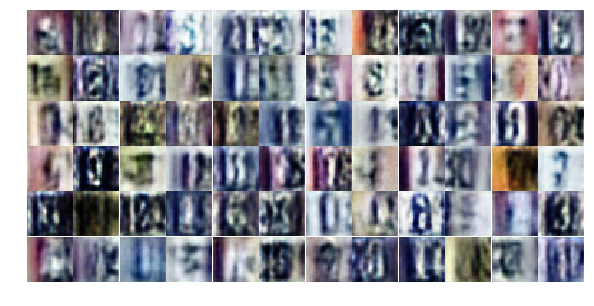

Epoch 4/25... Discriminator Loss: 0.4549... Generator Loss: 1.4581
Epoch 4/25... Discriminator Loss: 0.2478... Generator Loss: 2.2912
Epoch 4/25... Discriminator Loss: 0.4658... Generator Loss: 1.2989
Epoch 4/25... Discriminator Loss: 0.3464... Generator Loss: 2.0142
Epoch 4/25... Discriminator Loss: 0.4382... Generator Loss: 2.5224
Epoch 4/25... Discriminator Loss: 0.3388... Generator Loss: 1.9664
Epoch 4/25... Discriminator Loss: 2.0652... Generator Loss: 0.1864
Epoch 4/25... Discriminator Loss: 0.7098... Generator Loss: 1.3893
Epoch 4/25... Discriminator Loss: 0.3842... Generator Loss: 1.5615
Epoch 4/25... Discriminator Loss: 0.4223... Generator Loss: 1.8880


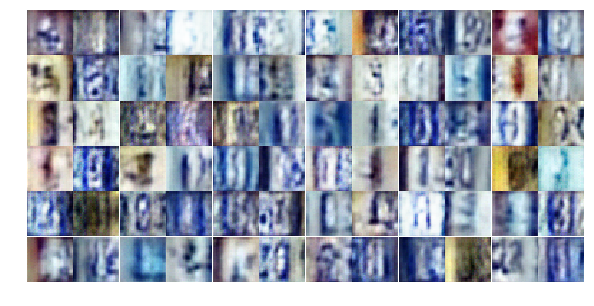

Epoch 4/25... Discriminator Loss: 0.5054... Generator Loss: 1.3098
Epoch 4/25... Discriminator Loss: 0.3309... Generator Loss: 1.8438
Epoch 4/25... Discriminator Loss: 0.2717... Generator Loss: 3.2857
Epoch 4/25... Discriminator Loss: 0.3775... Generator Loss: 2.0245
Epoch 4/25... Discriminator Loss: 0.8134... Generator Loss: 0.8534
Epoch 4/25... Discriminator Loss: 1.0390... Generator Loss: 3.1657
Epoch 4/25... Discriminator Loss: 0.4819... Generator Loss: 1.3629
Epoch 4/25... Discriminator Loss: 1.1967... Generator Loss: 0.5077
Epoch 4/25... Discriminator Loss: 0.4105... Generator Loss: 1.9364
Epoch 5/25... Discriminator Loss: 0.3976... Generator Loss: 1.8429


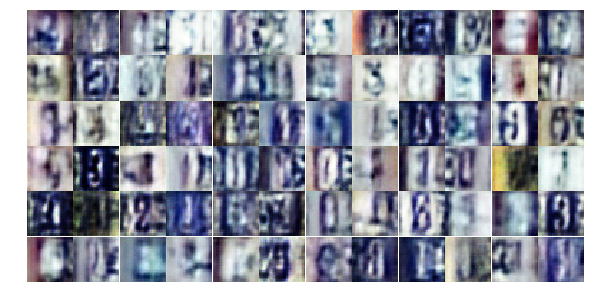

Epoch 5/25... Discriminator Loss: 0.3801... Generator Loss: 2.3721
Epoch 5/25... Discriminator Loss: 0.3718... Generator Loss: 1.5633
Epoch 5/25... Discriminator Loss: 0.4528... Generator Loss: 1.3707
Epoch 5/25... Discriminator Loss: 0.2734... Generator Loss: 1.8514
Epoch 5/25... Discriminator Loss: 0.2581... Generator Loss: 2.1305
Epoch 5/25... Discriminator Loss: 0.7932... Generator Loss: 0.8965
Epoch 5/25... Discriminator Loss: 1.8109... Generator Loss: 0.3365
Epoch 5/25... Discriminator Loss: 0.9618... Generator Loss: 0.8924
Epoch 5/25... Discriminator Loss: 0.6663... Generator Loss: 1.2326
Epoch 5/25... Discriminator Loss: 0.7241... Generator Loss: 1.1324


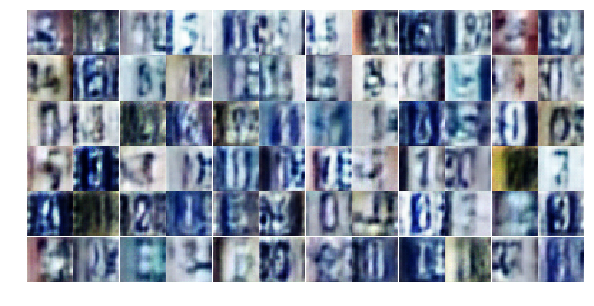

Epoch 5/25... Discriminator Loss: 0.4554... Generator Loss: 1.6245
Epoch 5/25... Discriminator Loss: 0.2688... Generator Loss: 2.0859
Epoch 5/25... Discriminator Loss: 0.3843... Generator Loss: 2.2164
Epoch 5/25... Discriminator Loss: 0.6108... Generator Loss: 1.0671
Epoch 5/25... Discriminator Loss: 0.5379... Generator Loss: 2.2508
Epoch 5/25... Discriminator Loss: 0.8432... Generator Loss: 0.8725
Epoch 5/25... Discriminator Loss: 0.8403... Generator Loss: 0.7764
Epoch 5/25... Discriminator Loss: 0.4483... Generator Loss: 1.8619
Epoch 5/25... Discriminator Loss: 1.7232... Generator Loss: 0.2818
Epoch 5/25... Discriminator Loss: 0.7450... Generator Loss: 0.9826


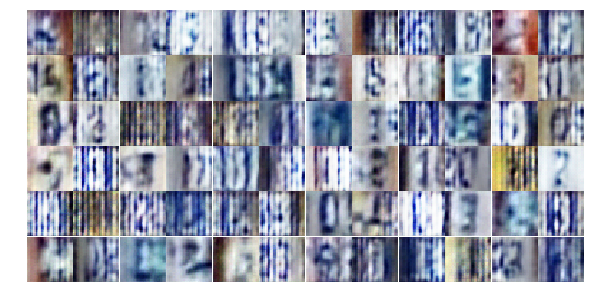

Epoch 5/25... Discriminator Loss: 0.4994... Generator Loss: 1.7062
Epoch 5/25... Discriminator Loss: 0.5751... Generator Loss: 1.5231
Epoch 5/25... Discriminator Loss: 0.6108... Generator Loss: 1.0812
Epoch 5/25... Discriminator Loss: 0.4888... Generator Loss: 1.3446
Epoch 5/25... Discriminator Loss: 0.5668... Generator Loss: 1.1417
Epoch 5/25... Discriminator Loss: 0.6594... Generator Loss: 1.0328
Epoch 5/25... Discriminator Loss: 0.8029... Generator Loss: 0.7588
Epoch 5/25... Discriminator Loss: 0.4621... Generator Loss: 1.4222
Epoch 5/25... Discriminator Loss: 1.6334... Generator Loss: 0.3693
Epoch 5/25... Discriminator Loss: 0.4831... Generator Loss: 1.7812


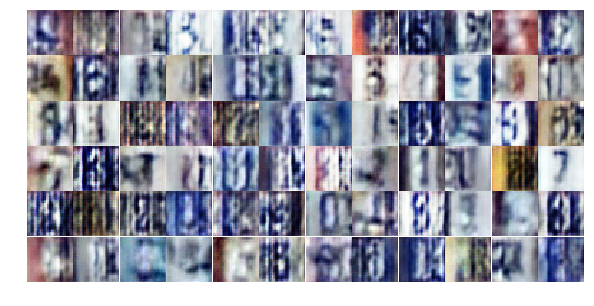

Epoch 5/25... Discriminator Loss: 0.4591... Generator Loss: 1.6897
Epoch 5/25... Discriminator Loss: 0.4792... Generator Loss: 1.7826
Epoch 5/25... Discriminator Loss: 0.4959... Generator Loss: 1.5574
Epoch 5/25... Discriminator Loss: 0.3946... Generator Loss: 1.5505
Epoch 5/25... Discriminator Loss: 1.0032... Generator Loss: 0.6392
Epoch 5/25... Discriminator Loss: 0.3268... Generator Loss: 2.3035
Epoch 5/25... Discriminator Loss: 0.6206... Generator Loss: 1.0164
Epoch 5/25... Discriminator Loss: 0.7800... Generator Loss: 0.8523
Epoch 5/25... Discriminator Loss: 1.0390... Generator Loss: 0.6286
Epoch 5/25... Discriminator Loss: 0.3967... Generator Loss: 1.7871


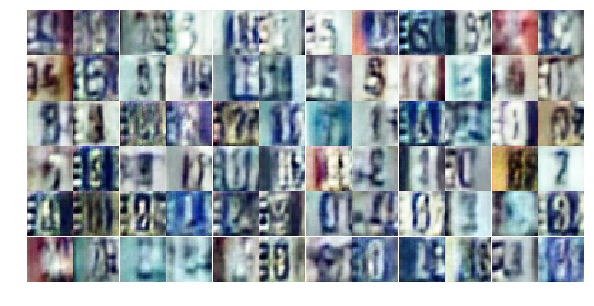

Epoch 5/25... Discriminator Loss: 0.7759... Generator Loss: 0.8978
Epoch 5/25... Discriminator Loss: 0.6078... Generator Loss: 1.1246
Epoch 5/25... Discriminator Loss: 0.7722... Generator Loss: 0.8222
Epoch 5/25... Discriminator Loss: 0.3968... Generator Loss: 2.4845
Epoch 5/25... Discriminator Loss: 0.8033... Generator Loss: 2.5543
Epoch 5/25... Discriminator Loss: 1.0025... Generator Loss: 0.6798
Epoch 5/25... Discriminator Loss: 0.6123... Generator Loss: 2.1351
Epoch 5/25... Discriminator Loss: 0.5076... Generator Loss: 1.2076
Epoch 5/25... Discriminator Loss: 0.3987... Generator Loss: 1.5396
Epoch 5/25... Discriminator Loss: 0.4733... Generator Loss: 1.8065


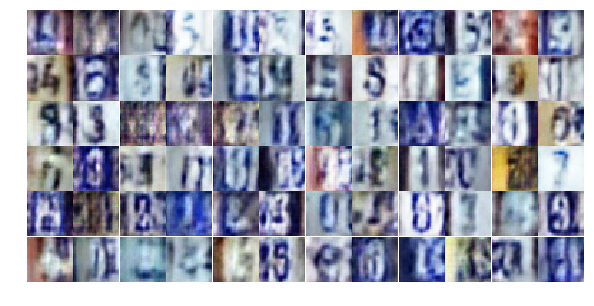

Epoch 5/25... Discriminator Loss: 0.9653... Generator Loss: 0.6415
Epoch 5/25... Discriminator Loss: 0.5358... Generator Loss: 1.4285
Epoch 5/25... Discriminator Loss: 1.3164... Generator Loss: 0.4502
Epoch 5/25... Discriminator Loss: 0.7126... Generator Loss: 0.9171
Epoch 5/25... Discriminator Loss: 0.3837... Generator Loss: 1.6513
Epoch 5/25... Discriminator Loss: 0.5073... Generator Loss: 1.6074
Epoch 6/25... Discriminator Loss: 0.5283... Generator Loss: 1.8004
Epoch 6/25... Discriminator Loss: 0.5554... Generator Loss: 1.3122
Epoch 6/25... Discriminator Loss: 0.3851... Generator Loss: 1.9950
Epoch 6/25... Discriminator Loss: 0.6330... Generator Loss: 1.4372


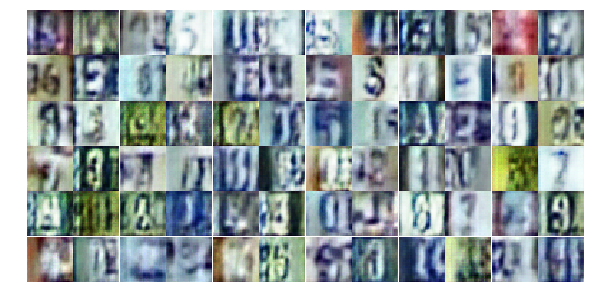

Epoch 6/25... Discriminator Loss: 0.4485... Generator Loss: 1.4549
Epoch 6/25... Discriminator Loss: 1.0706... Generator Loss: 0.7514
Epoch 6/25... Discriminator Loss: 0.9716... Generator Loss: 3.0821
Epoch 6/25... Discriminator Loss: 1.0204... Generator Loss: 0.6011
Epoch 6/25... Discriminator Loss: 0.7665... Generator Loss: 0.8899
Epoch 6/25... Discriminator Loss: 0.4837... Generator Loss: 1.3120
Epoch 6/25... Discriminator Loss: 0.3592... Generator Loss: 1.9679
Epoch 6/25... Discriminator Loss: 0.5145... Generator Loss: 1.9754
Epoch 6/25... Discriminator Loss: 0.9970... Generator Loss: 0.6599
Epoch 6/25... Discriminator Loss: 0.4083... Generator Loss: 1.7121


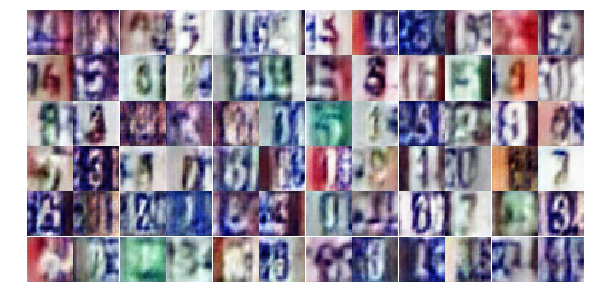

Epoch 6/25... Discriminator Loss: 0.6321... Generator Loss: 1.0429
Epoch 6/25... Discriminator Loss: 2.0260... Generator Loss: 0.2757
Epoch 6/25... Discriminator Loss: 0.7839... Generator Loss: 1.2903
Epoch 6/25... Discriminator Loss: 0.4560... Generator Loss: 1.6423
Epoch 6/25... Discriminator Loss: 0.4379... Generator Loss: 1.7829
Epoch 6/25... Discriminator Loss: 0.5236... Generator Loss: 1.3152
Epoch 6/25... Discriminator Loss: 0.4422... Generator Loss: 1.5467
Epoch 6/25... Discriminator Loss: 0.6290... Generator Loss: 1.1644
Epoch 6/25... Discriminator Loss: 0.4660... Generator Loss: 2.2872
Epoch 6/25... Discriminator Loss: 0.8902... Generator Loss: 0.7644


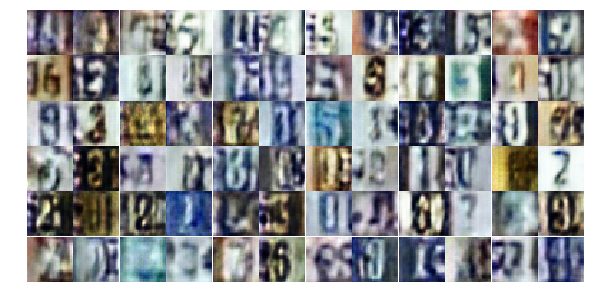

Epoch 6/25... Discriminator Loss: 0.8656... Generator Loss: 0.7230
Epoch 6/25... Discriminator Loss: 0.6235... Generator Loss: 1.0858
Epoch 6/25... Discriminator Loss: 0.6139... Generator Loss: 1.2979
Epoch 6/25... Discriminator Loss: 0.5942... Generator Loss: 1.3292
Epoch 6/25... Discriminator Loss: 0.5733... Generator Loss: 2.5704
Epoch 6/25... Discriminator Loss: 1.0130... Generator Loss: 0.7128
Epoch 6/25... Discriminator Loss: 0.5144... Generator Loss: 1.6528
Epoch 6/25... Discriminator Loss: 0.4039... Generator Loss: 1.4552
Epoch 6/25... Discriminator Loss: 0.5829... Generator Loss: 1.1323
Epoch 6/25... Discriminator Loss: 0.5364... Generator Loss: 1.3949


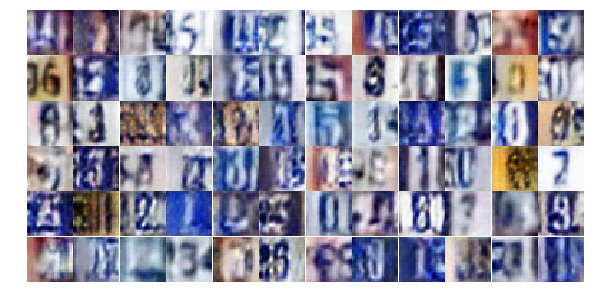

Epoch 6/25... Discriminator Loss: 1.0273... Generator Loss: 2.4188
Epoch 6/25... Discriminator Loss: 0.5357... Generator Loss: 1.3302
Epoch 6/25... Discriminator Loss: 0.7031... Generator Loss: 1.3057
Epoch 6/25... Discriminator Loss: 0.5744... Generator Loss: 1.1843
Epoch 6/25... Discriminator Loss: 0.5860... Generator Loss: 1.3233
Epoch 6/25... Discriminator Loss: 0.1419... Generator Loss: 2.9693
Epoch 6/25... Discriminator Loss: 0.3636... Generator Loss: 2.1028
Epoch 6/25... Discriminator Loss: 0.5089... Generator Loss: 1.6491
Epoch 6/25... Discriminator Loss: 0.6151... Generator Loss: 1.3006
Epoch 6/25... Discriminator Loss: 0.3966... Generator Loss: 1.5323


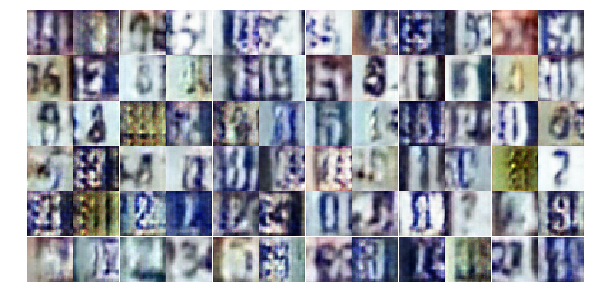

Epoch 6/25... Discriminator Loss: 1.4470... Generator Loss: 3.7709
Epoch 6/25... Discriminator Loss: 0.9241... Generator Loss: 0.6965
Epoch 6/25... Discriminator Loss: 0.8707... Generator Loss: 0.8767
Epoch 6/25... Discriminator Loss: 0.5114... Generator Loss: 1.6813
Epoch 6/25... Discriminator Loss: 0.6621... Generator Loss: 1.1014
Epoch 6/25... Discriminator Loss: 0.5232... Generator Loss: 1.3153
Epoch 6/25... Discriminator Loss: 0.8170... Generator Loss: 0.8025
Epoch 6/25... Discriminator Loss: 1.3653... Generator Loss: 0.4031
Epoch 6/25... Discriminator Loss: 0.7672... Generator Loss: 1.8750
Epoch 6/25... Discriminator Loss: 1.1562... Generator Loss: 0.6438


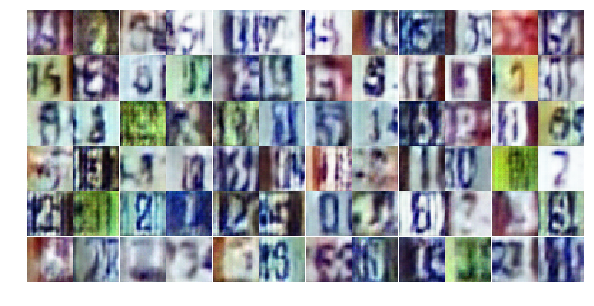

Epoch 6/25... Discriminator Loss: 0.5009... Generator Loss: 1.5356
Epoch 6/25... Discriminator Loss: 0.7350... Generator Loss: 0.9609
Epoch 6/25... Discriminator Loss: 0.5601... Generator Loss: 1.2238
Epoch 7/25... Discriminator Loss: 0.6869... Generator Loss: 1.8231
Epoch 7/25... Discriminator Loss: 0.4707... Generator Loss: 1.4506
Epoch 7/25... Discriminator Loss: 0.9736... Generator Loss: 0.7386
Epoch 7/25... Discriminator Loss: 0.4322... Generator Loss: 2.0317
Epoch 7/25... Discriminator Loss: 0.4445... Generator Loss: 1.5182
Epoch 7/25... Discriminator Loss: 0.3596... Generator Loss: 1.7345
Epoch 7/25... Discriminator Loss: 0.7782... Generator Loss: 0.8652


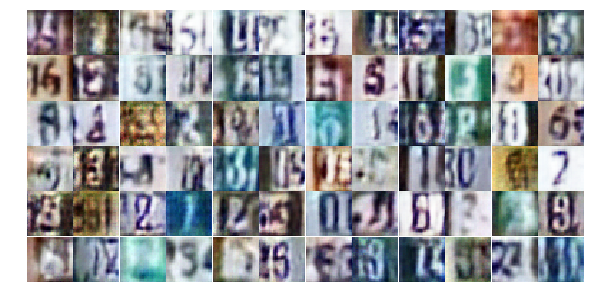

Epoch 7/25... Discriminator Loss: 0.4747... Generator Loss: 1.5191
Epoch 7/25... Discriminator Loss: 0.6040... Generator Loss: 2.1126
Epoch 7/25... Discriminator Loss: 0.7422... Generator Loss: 0.9999
Epoch 7/25... Discriminator Loss: 0.6819... Generator Loss: 1.0818
Epoch 7/25... Discriminator Loss: 0.4673... Generator Loss: 1.9959
Epoch 7/25... Discriminator Loss: 0.6121... Generator Loss: 1.0503
Epoch 7/25... Discriminator Loss: 0.6197... Generator Loss: 2.5320
Epoch 7/25... Discriminator Loss: 0.7433... Generator Loss: 2.4052
Epoch 7/25... Discriminator Loss: 0.8986... Generator Loss: 2.8770
Epoch 7/25... Discriminator Loss: 0.6371... Generator Loss: 1.2411


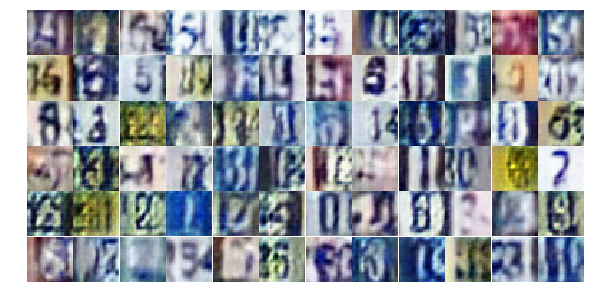

Epoch 7/25... Discriminator Loss: 0.5561... Generator Loss: 1.3738
Epoch 7/25... Discriminator Loss: 0.4756... Generator Loss: 1.7051
Epoch 7/25... Discriminator Loss: 1.1160... Generator Loss: 0.5454
Epoch 7/25... Discriminator Loss: 0.5650... Generator Loss: 1.3184
Epoch 7/25... Discriminator Loss: 0.4850... Generator Loss: 1.2905
Epoch 7/25... Discriminator Loss: 0.5324... Generator Loss: 1.4275
Epoch 7/25... Discriminator Loss: 0.6856... Generator Loss: 0.9309
Epoch 7/25... Discriminator Loss: 1.3449... Generator Loss: 0.4114
Epoch 7/25... Discriminator Loss: 0.3201... Generator Loss: 2.3815
Epoch 7/25... Discriminator Loss: 0.5136... Generator Loss: 1.4463


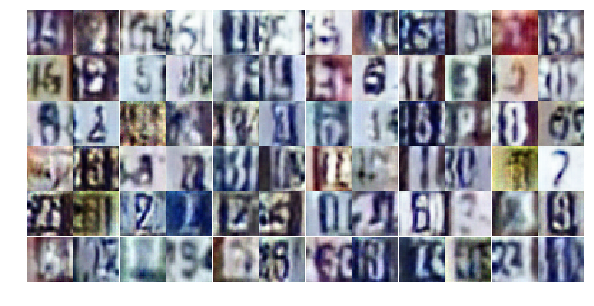

Epoch 7/25... Discriminator Loss: 0.8858... Generator Loss: 0.7094
Epoch 7/25... Discriminator Loss: 1.5328... Generator Loss: 0.3641
Epoch 7/25... Discriminator Loss: 0.4755... Generator Loss: 1.4303
Epoch 7/25... Discriminator Loss: 0.6130... Generator Loss: 1.1530
Epoch 7/25... Discriminator Loss: 1.0964... Generator Loss: 0.6183
Epoch 7/25... Discriminator Loss: 1.2329... Generator Loss: 0.4474
Epoch 7/25... Discriminator Loss: 0.6985... Generator Loss: 0.9177
Epoch 7/25... Discriminator Loss: 1.1655... Generator Loss: 0.5657
Epoch 7/25... Discriminator Loss: 1.6693... Generator Loss: 0.2609
Epoch 7/25... Discriminator Loss: 0.5225... Generator Loss: 1.8315


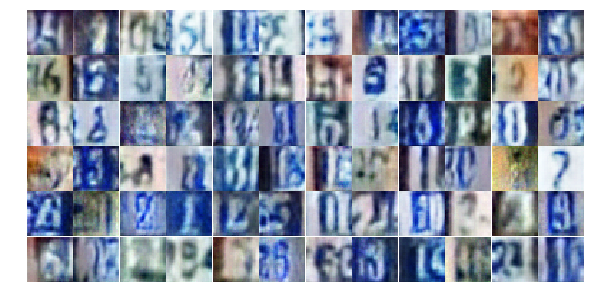

Epoch 7/25... Discriminator Loss: 0.9983... Generator Loss: 0.6804
Epoch 7/25... Discriminator Loss: 0.5402... Generator Loss: 1.3504
Epoch 7/25... Discriminator Loss: 0.3970... Generator Loss: 1.9355
Epoch 7/25... Discriminator Loss: 0.6788... Generator Loss: 1.3198
Epoch 7/25... Discriminator Loss: 0.7484... Generator Loss: 0.9418
Epoch 7/25... Discriminator Loss: 0.3247... Generator Loss: 1.9874
Epoch 7/25... Discriminator Loss: 0.5680... Generator Loss: 1.1609
Epoch 7/25... Discriminator Loss: 2.5536... Generator Loss: 0.1322
Epoch 7/25... Discriminator Loss: 0.5069... Generator Loss: 2.1831
Epoch 7/25... Discriminator Loss: 0.8859... Generator Loss: 0.9834


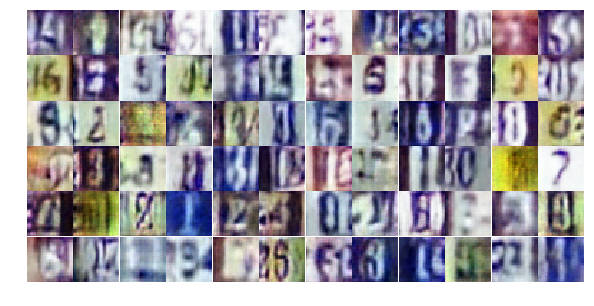

Epoch 7/25... Discriminator Loss: 0.5068... Generator Loss: 1.6631
Epoch 7/25... Discriminator Loss: 0.6710... Generator Loss: 1.0299
Epoch 7/25... Discriminator Loss: 0.8518... Generator Loss: 0.8057
Epoch 7/25... Discriminator Loss: 0.6408... Generator Loss: 1.0093
Epoch 7/25... Discriminator Loss: 0.5016... Generator Loss: 1.4925
Epoch 7/25... Discriminator Loss: 0.8019... Generator Loss: 0.9618
Epoch 7/25... Discriminator Loss: 1.0941... Generator Loss: 0.5707
Epoch 7/25... Discriminator Loss: 0.4997... Generator Loss: 1.7529
Epoch 7/25... Discriminator Loss: 0.7798... Generator Loss: 0.9996
Epoch 7/25... Discriminator Loss: 0.6528... Generator Loss: 0.9524


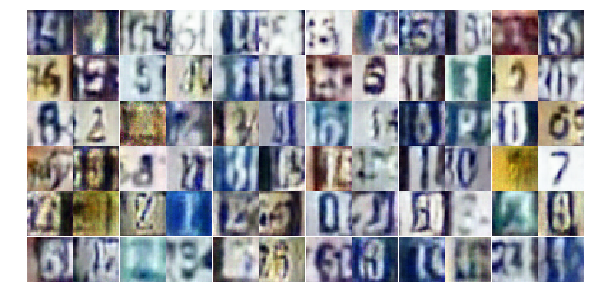

Epoch 7/25... Discriminator Loss: 0.5646... Generator Loss: 2.2713
Epoch 8/25... Discriminator Loss: 0.6560... Generator Loss: 1.0651
Epoch 8/25... Discriminator Loss: 1.0294... Generator Loss: 0.5843
Epoch 8/25... Discriminator Loss: 0.5554... Generator Loss: 1.3444
Epoch 8/25... Discriminator Loss: 0.5779... Generator Loss: 1.3074
Epoch 8/25... Discriminator Loss: 0.8804... Generator Loss: 0.8436
Epoch 8/25... Discriminator Loss: 0.5747... Generator Loss: 1.2691
Epoch 8/25... Discriminator Loss: 0.6401... Generator Loss: 1.4764
Epoch 8/25... Discriminator Loss: 0.6173... Generator Loss: 1.3224
Epoch 8/25... Discriminator Loss: 0.8534... Generator Loss: 0.8814


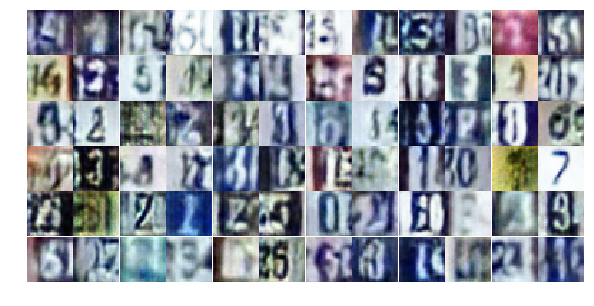

Epoch 8/25... Discriminator Loss: 0.5391... Generator Loss: 1.8312
Epoch 8/25... Discriminator Loss: 0.5086... Generator Loss: 1.7428
Epoch 8/25... Discriminator Loss: 0.7839... Generator Loss: 0.9041
Epoch 8/25... Discriminator Loss: 0.3639... Generator Loss: 1.6874
Epoch 8/25... Discriminator Loss: 0.9658... Generator Loss: 0.6987
Epoch 8/25... Discriminator Loss: 0.8523... Generator Loss: 2.5312
Epoch 8/25... Discriminator Loss: 0.4226... Generator Loss: 1.8710
Epoch 8/25... Discriminator Loss: 0.3997... Generator Loss: 1.6855
Epoch 8/25... Discriminator Loss: 1.0275... Generator Loss: 2.8668
Epoch 8/25... Discriminator Loss: 1.0075... Generator Loss: 1.0085


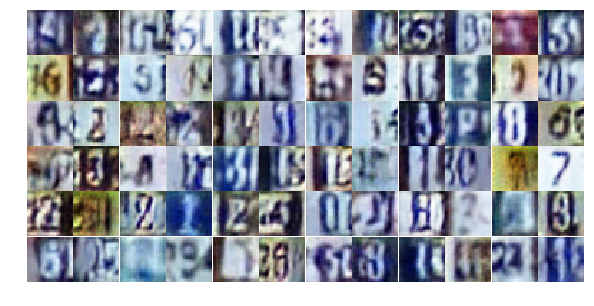

Epoch 8/25... Discriminator Loss: 0.4876... Generator Loss: 1.4739
Epoch 8/25... Discriminator Loss: 0.5515... Generator Loss: 1.2570
Epoch 8/25... Discriminator Loss: 0.6840... Generator Loss: 1.3164
Epoch 8/25... Discriminator Loss: 0.6443... Generator Loss: 1.2043
Epoch 8/25... Discriminator Loss: 0.4711... Generator Loss: 1.4981
Epoch 8/25... Discriminator Loss: 0.5669... Generator Loss: 1.1611
Epoch 8/25... Discriminator Loss: 0.6182... Generator Loss: 2.0563
Epoch 8/25... Discriminator Loss: 0.5044... Generator Loss: 1.2558
Epoch 8/25... Discriminator Loss: 0.6580... Generator Loss: 1.9595
Epoch 8/25... Discriminator Loss: 0.6553... Generator Loss: 1.0485


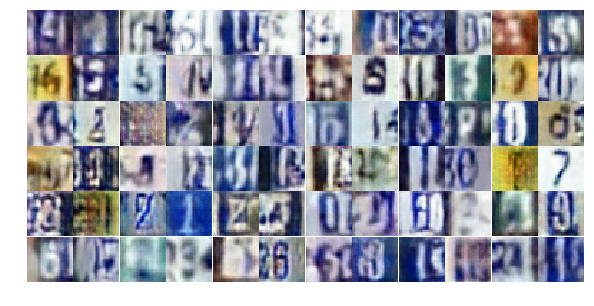

Epoch 8/25... Discriminator Loss: 0.9362... Generator Loss: 1.2219
Epoch 8/25... Discriminator Loss: 0.9762... Generator Loss: 0.6160
Epoch 8/25... Discriminator Loss: 0.8922... Generator Loss: 0.7481
Epoch 8/25... Discriminator Loss: 0.8529... Generator Loss: 0.7642
Epoch 8/25... Discriminator Loss: 0.5899... Generator Loss: 1.1160
Epoch 8/25... Discriminator Loss: 0.5042... Generator Loss: 1.3098
Epoch 8/25... Discriminator Loss: 0.8007... Generator Loss: 0.7734
Epoch 8/25... Discriminator Loss: 0.4377... Generator Loss: 1.8480
Epoch 8/25... Discriminator Loss: 0.6898... Generator Loss: 1.4117
Epoch 8/25... Discriminator Loss: 0.5696... Generator Loss: 1.1549


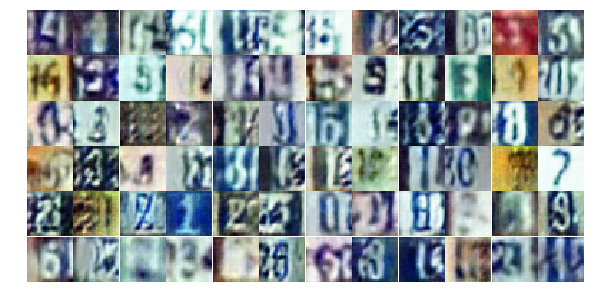

Epoch 8/25... Discriminator Loss: 0.3932... Generator Loss: 2.0275
Epoch 8/25... Discriminator Loss: 0.6598... Generator Loss: 1.4440
Epoch 8/25... Discriminator Loss: 0.9088... Generator Loss: 0.6921
Epoch 8/25... Discriminator Loss: 0.5413... Generator Loss: 2.6964
Epoch 8/25... Discriminator Loss: 1.7242... Generator Loss: 3.1344
Epoch 8/25... Discriminator Loss: 1.0379... Generator Loss: 0.7356
Epoch 8/25... Discriminator Loss: 0.4473... Generator Loss: 1.7257
Epoch 8/25... Discriminator Loss: 0.5341... Generator Loss: 1.2778
Epoch 8/25... Discriminator Loss: 0.6629... Generator Loss: 1.1044
Epoch 8/25... Discriminator Loss: 0.7960... Generator Loss: 0.9266


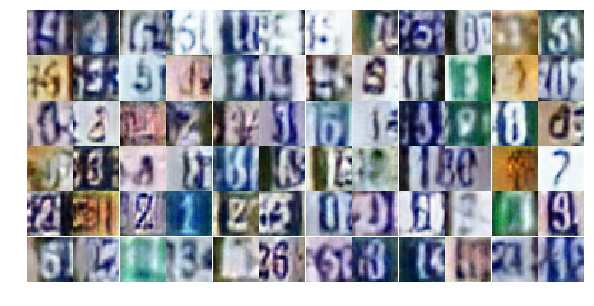

Epoch 8/25... Discriminator Loss: 0.5494... Generator Loss: 1.2498
Epoch 8/25... Discriminator Loss: 0.7138... Generator Loss: 1.0360
Epoch 8/25... Discriminator Loss: 0.9025... Generator Loss: 2.8701
Epoch 8/25... Discriminator Loss: 0.8286... Generator Loss: 0.8140
Epoch 8/25... Discriminator Loss: 0.4415... Generator Loss: 1.8687
Epoch 8/25... Discriminator Loss: 0.7249... Generator Loss: 1.0826
Epoch 8/25... Discriminator Loss: 0.6508... Generator Loss: 1.2056
Epoch 8/25... Discriminator Loss: 0.4738... Generator Loss: 1.4263
Epoch 9/25... Discriminator Loss: 0.8948... Generator Loss: 1.0584
Epoch 9/25... Discriminator Loss: 0.7985... Generator Loss: 0.8222


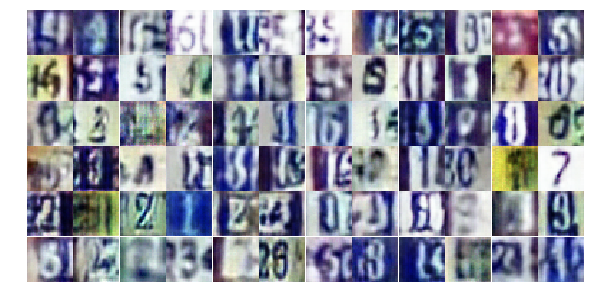

Epoch 9/25... Discriminator Loss: 0.6726... Generator Loss: 1.0503
Epoch 9/25... Discriminator Loss: 0.5948... Generator Loss: 1.5565
Epoch 9/25... Discriminator Loss: 1.3480... Generator Loss: 0.4505
Epoch 9/25... Discriminator Loss: 0.4267... Generator Loss: 1.4950
Epoch 9/25... Discriminator Loss: 1.3538... Generator Loss: 0.4331
Epoch 9/25... Discriminator Loss: 0.5148... Generator Loss: 1.9932
Epoch 9/25... Discriminator Loss: 1.0020... Generator Loss: 3.3471
Epoch 9/25... Discriminator Loss: 0.5385... Generator Loss: 1.2591
Epoch 9/25... Discriminator Loss: 0.9683... Generator Loss: 0.6831
Epoch 9/25... Discriminator Loss: 0.6842... Generator Loss: 2.3281


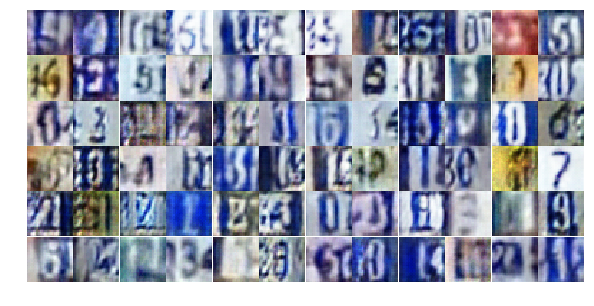

Epoch 9/25... Discriminator Loss: 0.6523... Generator Loss: 1.2555
Epoch 9/25... Discriminator Loss: 0.9303... Generator Loss: 0.7053
Epoch 9/25... Discriminator Loss: 0.6225... Generator Loss: 1.1790
Epoch 9/25... Discriminator Loss: 0.8644... Generator Loss: 0.7553
Epoch 9/25... Discriminator Loss: 0.5082... Generator Loss: 1.9608
Epoch 9/25... Discriminator Loss: 0.7067... Generator Loss: 1.7199
Epoch 9/25... Discriminator Loss: 1.2130... Generator Loss: 0.4821
Epoch 9/25... Discriminator Loss: 0.5747... Generator Loss: 1.2370
Epoch 9/25... Discriminator Loss: 1.4145... Generator Loss: 0.3656
Epoch 9/25... Discriminator Loss: 1.0177... Generator Loss: 0.6348


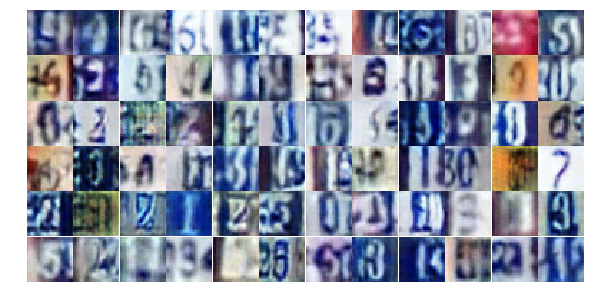

Epoch 9/25... Discriminator Loss: 0.9254... Generator Loss: 0.8232
Epoch 9/25... Discriminator Loss: 0.4462... Generator Loss: 1.9416
Epoch 9/25... Discriminator Loss: 0.6114... Generator Loss: 1.1786
Epoch 9/25... Discriminator Loss: 0.8924... Generator Loss: 0.7292
Epoch 9/25... Discriminator Loss: 0.8243... Generator Loss: 3.3123
Epoch 9/25... Discriminator Loss: 5.4361... Generator Loss: 0.0095
Epoch 9/25... Discriminator Loss: 1.3633... Generator Loss: 0.4739
Epoch 9/25... Discriminator Loss: 0.8167... Generator Loss: 1.4226
Epoch 9/25... Discriminator Loss: 0.5620... Generator Loss: 1.2415
Epoch 9/25... Discriminator Loss: 0.6202... Generator Loss: 1.0994


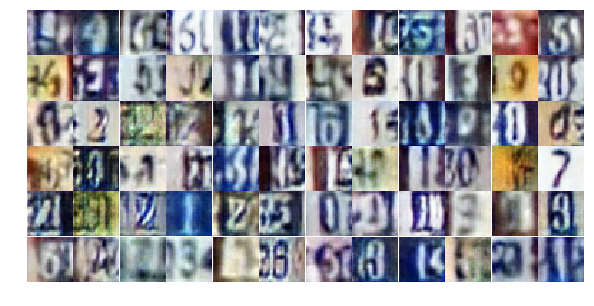

Epoch 9/25... Discriminator Loss: 0.6987... Generator Loss: 1.1190
Epoch 9/25... Discriminator Loss: 0.4479... Generator Loss: 1.6108
Epoch 9/25... Discriminator Loss: 1.1852... Generator Loss: 0.5196
Epoch 9/25... Discriminator Loss: 0.7031... Generator Loss: 1.9130
Epoch 9/25... Discriminator Loss: 0.7391... Generator Loss: 1.0206
Epoch 9/25... Discriminator Loss: 0.7582... Generator Loss: 0.9741
Epoch 9/25... Discriminator Loss: 0.6047... Generator Loss: 1.1909
Epoch 9/25... Discriminator Loss: 0.5445... Generator Loss: 1.1605
Epoch 9/25... Discriminator Loss: 0.7678... Generator Loss: 0.8834
Epoch 9/25... Discriminator Loss: 0.6031... Generator Loss: 1.1934


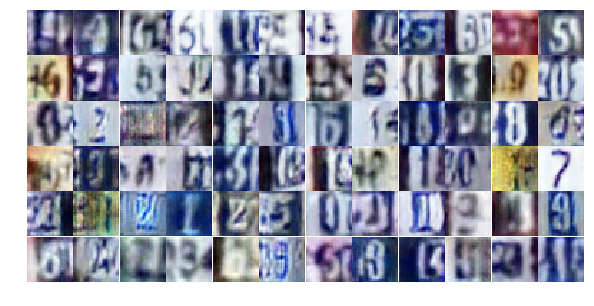

Epoch 9/25... Discriminator Loss: 0.5621... Generator Loss: 1.6308
Epoch 9/25... Discriminator Loss: 0.6276... Generator Loss: 1.0513
Epoch 9/25... Discriminator Loss: 0.4032... Generator Loss: 1.8830
Epoch 9/25... Discriminator Loss: 0.7488... Generator Loss: 1.7079
Epoch 9/25... Discriminator Loss: 0.7744... Generator Loss: 2.5651
Epoch 9/25... Discriminator Loss: 1.3125... Generator Loss: 0.4571
Epoch 9/25... Discriminator Loss: 0.9162... Generator Loss: 0.7314
Epoch 9/25... Discriminator Loss: 0.7389... Generator Loss: 0.9120
Epoch 9/25... Discriminator Loss: 0.6482... Generator Loss: 1.0816
Epoch 9/25... Discriminator Loss: 0.5098... Generator Loss: 1.9752


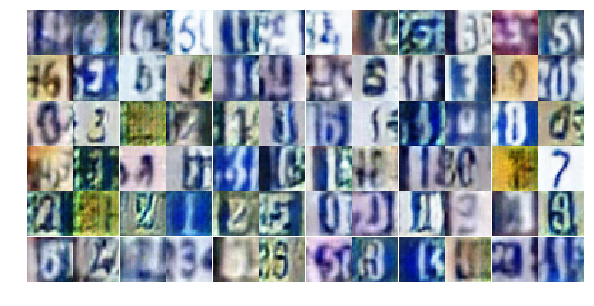

Epoch 9/25... Discriminator Loss: 0.8178... Generator Loss: 0.7902
Epoch 9/25... Discriminator Loss: 1.4750... Generator Loss: 3.0726
Epoch 9/25... Discriminator Loss: 0.8593... Generator Loss: 0.7693
Epoch 9/25... Discriminator Loss: 0.8675... Generator Loss: 0.8034
Epoch 9/25... Discriminator Loss: 0.5605... Generator Loss: 1.4962
Epoch 10/25... Discriminator Loss: 0.7057... Generator Loss: 0.9363
Epoch 10/25... Discriminator Loss: 0.5923... Generator Loss: 1.4179
Epoch 10/25... Discriminator Loss: 0.5262... Generator Loss: 1.3124
Epoch 10/25... Discriminator Loss: 0.9313... Generator Loss: 0.7145
Epoch 10/25... Discriminator Loss: 1.1469... Generator Loss: 0.5403


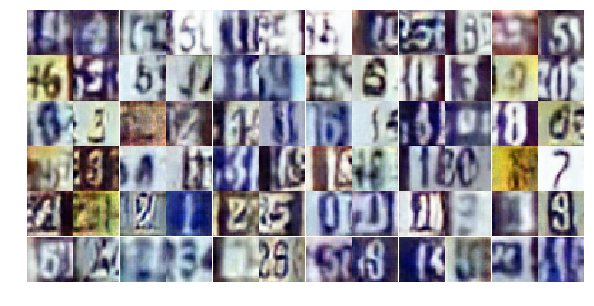

Epoch 10/25... Discriminator Loss: 1.1929... Generator Loss: 0.5351
Epoch 10/25... Discriminator Loss: 0.4471... Generator Loss: 1.4584
Epoch 10/25... Discriminator Loss: 1.0451... Generator Loss: 0.6804
Epoch 10/25... Discriminator Loss: 0.6944... Generator Loss: 1.1755
Epoch 10/25... Discriminator Loss: 0.6524... Generator Loss: 1.5659
Epoch 10/25... Discriminator Loss: 0.5442... Generator Loss: 1.4222
Epoch 10/25... Discriminator Loss: 0.4658... Generator Loss: 1.3658
Epoch 10/25... Discriminator Loss: 1.3189... Generator Loss: 0.4463
Epoch 10/25... Discriminator Loss: 0.8112... Generator Loss: 0.9796
Epoch 10/25... Discriminator Loss: 0.8719... Generator Loss: 1.7812


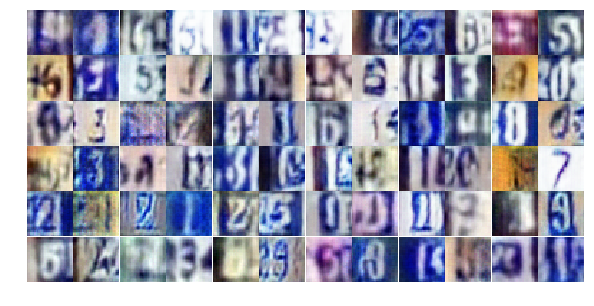

Epoch 10/25... Discriminator Loss: 0.5929... Generator Loss: 1.4862
Epoch 10/25... Discriminator Loss: 0.8244... Generator Loss: 0.9402
Epoch 10/25... Discriminator Loss: 0.9031... Generator Loss: 0.7589
Epoch 10/25... Discriminator Loss: 1.3701... Generator Loss: 0.4156
Epoch 10/25... Discriminator Loss: 0.5861... Generator Loss: 1.1731
Epoch 10/25... Discriminator Loss: 0.5429... Generator Loss: 1.2918
Epoch 10/25... Discriminator Loss: 0.6215... Generator Loss: 1.2262
Epoch 10/25... Discriminator Loss: 0.5377... Generator Loss: 1.3522
Epoch 10/25... Discriminator Loss: 0.6405... Generator Loss: 1.1222
Epoch 10/25... Discriminator Loss: 0.4469... Generator Loss: 2.8767


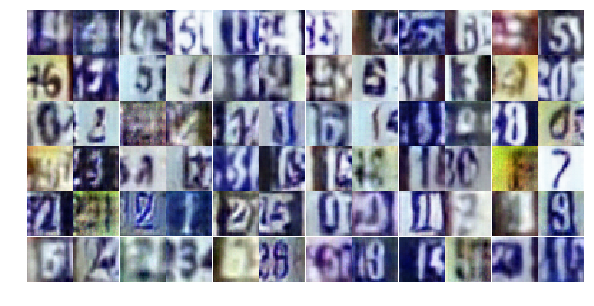

Epoch 10/25... Discriminator Loss: 0.7765... Generator Loss: 0.8967
Epoch 10/25... Discriminator Loss: 0.8006... Generator Loss: 0.8712
Epoch 10/25... Discriminator Loss: 0.4378... Generator Loss: 1.4921
Epoch 10/25... Discriminator Loss: 0.5727... Generator Loss: 1.6811
Epoch 10/25... Discriminator Loss: 1.3037... Generator Loss: 0.4211
Epoch 10/25... Discriminator Loss: 0.6870... Generator Loss: 1.0744
Epoch 10/25... Discriminator Loss: 0.3957... Generator Loss: 1.9812
Epoch 10/25... Discriminator Loss: 0.9508... Generator Loss: 0.6732
Epoch 10/25... Discriminator Loss: 0.7082... Generator Loss: 0.9481
Epoch 10/25... Discriminator Loss: 0.6603... Generator Loss: 1.0411


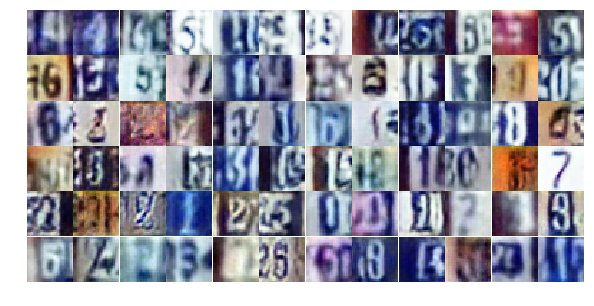

Epoch 10/25... Discriminator Loss: 0.6688... Generator Loss: 2.1191
Epoch 10/25... Discriminator Loss: 0.6218... Generator Loss: 1.2956
Epoch 10/25... Discriminator Loss: 0.4818... Generator Loss: 1.8659
Epoch 10/25... Discriminator Loss: 0.6057... Generator Loss: 1.2494
Epoch 10/25... Discriminator Loss: 1.0529... Generator Loss: 0.5698
Epoch 10/25... Discriminator Loss: 1.0250... Generator Loss: 0.5916
Epoch 10/25... Discriminator Loss: 0.6747... Generator Loss: 0.9906
Epoch 10/25... Discriminator Loss: 1.2618... Generator Loss: 0.4867
Epoch 10/25... Discriminator Loss: 0.4605... Generator Loss: 1.9757
Epoch 10/25... Discriminator Loss: 0.5206... Generator Loss: 2.0599


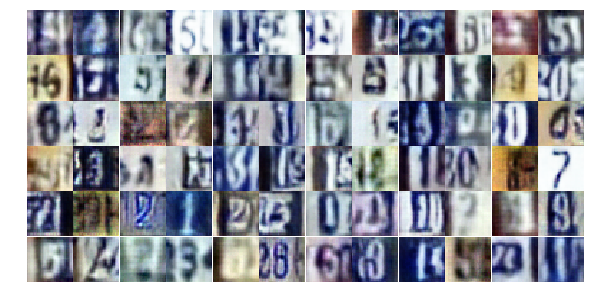

Epoch 10/25... Discriminator Loss: 1.7571... Generator Loss: 0.3826
Epoch 10/25... Discriminator Loss: 0.7658... Generator Loss: 1.5734
Epoch 10/25... Discriminator Loss: 0.6887... Generator Loss: 1.0225
Epoch 10/25... Discriminator Loss: 0.7395... Generator Loss: 1.0831
Epoch 10/25... Discriminator Loss: 0.6913... Generator Loss: 1.5702
Epoch 10/25... Discriminator Loss: 0.7789... Generator Loss: 1.1555
Epoch 10/25... Discriminator Loss: 0.5010... Generator Loss: 1.3907
Epoch 10/25... Discriminator Loss: 0.5652... Generator Loss: 1.1039
Epoch 10/25... Discriminator Loss: 0.5441... Generator Loss: 1.4370
Epoch 10/25... Discriminator Loss: 0.4643... Generator Loss: 1.5770


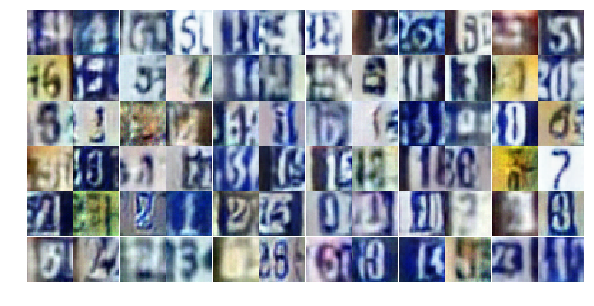

Epoch 10/25... Discriminator Loss: 1.0058... Generator Loss: 2.0007
Epoch 10/25... Discriminator Loss: 0.8040... Generator Loss: 0.8325
Epoch 10/25... Discriminator Loss: 0.6422... Generator Loss: 1.0641
Epoch 11/25... Discriminator Loss: 1.1834... Generator Loss: 0.5316
Epoch 11/25... Discriminator Loss: 0.6987... Generator Loss: 0.9474
Epoch 11/25... Discriminator Loss: 1.1779... Generator Loss: 0.5455
Epoch 11/25... Discriminator Loss: 0.4895... Generator Loss: 1.3418
Epoch 11/25... Discriminator Loss: 0.6690... Generator Loss: 1.8697
Epoch 11/25... Discriminator Loss: 1.1260... Generator Loss: 0.6421
Epoch 11/25... Discriminator Loss: 0.4952... Generator Loss: 1.5628


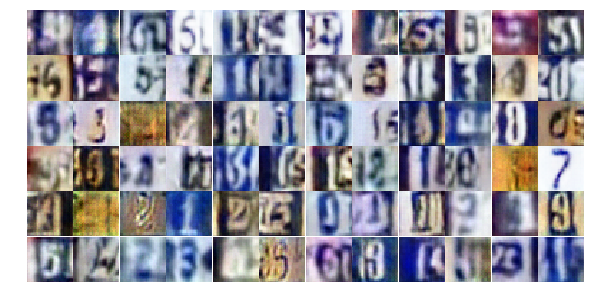

Epoch 11/25... Discriminator Loss: 0.4217... Generator Loss: 1.4984
Epoch 11/25... Discriminator Loss: 1.0221... Generator Loss: 0.6571
Epoch 11/25... Discriminator Loss: 0.3938... Generator Loss: 1.8834
Epoch 11/25... Discriminator Loss: 1.2310... Generator Loss: 0.4891
Epoch 11/25... Discriminator Loss: 0.7473... Generator Loss: 1.2719
Epoch 11/25... Discriminator Loss: 0.4852... Generator Loss: 1.4059
Epoch 11/25... Discriminator Loss: 0.7260... Generator Loss: 1.2733
Epoch 11/25... Discriminator Loss: 0.4129... Generator Loss: 2.1050
Epoch 11/25... Discriminator Loss: 0.8269... Generator Loss: 0.7798
Epoch 11/25... Discriminator Loss: 1.0177... Generator Loss: 0.7008


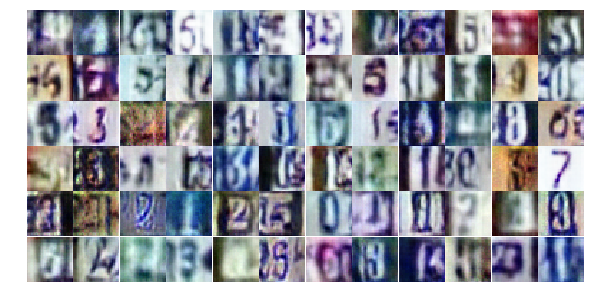

Epoch 11/25... Discriminator Loss: 0.6386... Generator Loss: 1.1801
Epoch 11/25... Discriminator Loss: 0.3373... Generator Loss: 1.9041
Epoch 11/25... Discriminator Loss: 0.9099... Generator Loss: 0.7376
Epoch 11/25... Discriminator Loss: 0.5561... Generator Loss: 1.1796
Epoch 11/25... Discriminator Loss: 0.4176... Generator Loss: 1.6082
Epoch 11/25... Discriminator Loss: 0.3914... Generator Loss: 1.7416
Epoch 11/25... Discriminator Loss: 0.5695... Generator Loss: 1.1041
Epoch 11/25... Discriminator Loss: 1.4066... Generator Loss: 0.3941
Epoch 11/25... Discriminator Loss: 0.4849... Generator Loss: 1.9306
Epoch 11/25... Discriminator Loss: 0.8339... Generator Loss: 0.7773


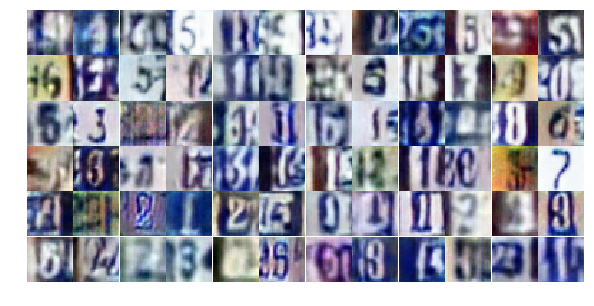

Epoch 11/25... Discriminator Loss: 0.9033... Generator Loss: 0.7328
Epoch 11/25... Discriminator Loss: 0.7727... Generator Loss: 0.9914
Epoch 11/25... Discriminator Loss: 0.8313... Generator Loss: 1.3049
Epoch 11/25... Discriminator Loss: 0.6349... Generator Loss: 1.0362
Epoch 11/25... Discriminator Loss: 0.7853... Generator Loss: 0.8657
Epoch 11/25... Discriminator Loss: 1.1347... Generator Loss: 0.5036
Epoch 11/25... Discriminator Loss: 1.0873... Generator Loss: 0.6123
Epoch 11/25... Discriminator Loss: 1.1945... Generator Loss: 0.5270
Epoch 11/25... Discriminator Loss: 0.6286... Generator Loss: 1.2358
Epoch 11/25... Discriminator Loss: 1.5362... Generator Loss: 0.3080


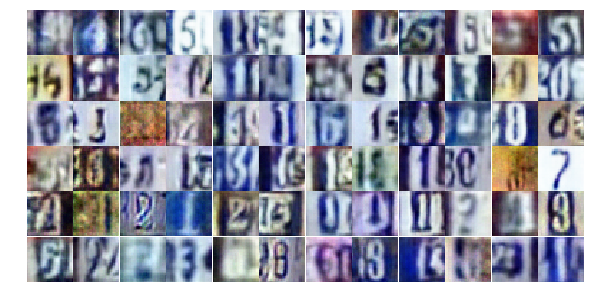

Epoch 11/25... Discriminator Loss: 0.4916... Generator Loss: 1.3733
Epoch 11/25... Discriminator Loss: 0.5725... Generator Loss: 1.1508
Epoch 11/25... Discriminator Loss: 0.7048... Generator Loss: 1.0079
Epoch 11/25... Discriminator Loss: 0.6549... Generator Loss: 1.1660
Epoch 11/25... Discriminator Loss: 0.9054... Generator Loss: 0.6729
Epoch 11/25... Discriminator Loss: 0.5030... Generator Loss: 1.2858
Epoch 11/25... Discriminator Loss: 0.3815... Generator Loss: 1.6082
Epoch 11/25... Discriminator Loss: 0.5540... Generator Loss: 1.1522
Epoch 11/25... Discriminator Loss: 2.2160... Generator Loss: 0.1784
Epoch 11/25... Discriminator Loss: 1.0363... Generator Loss: 0.6824


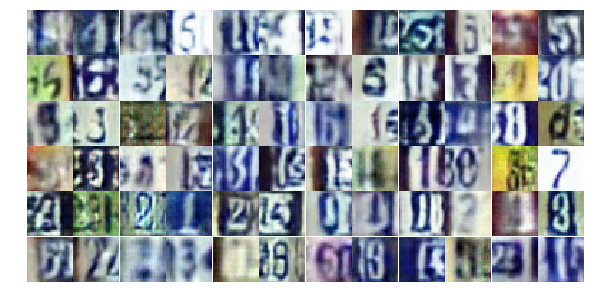

Epoch 11/25... Discriminator Loss: 0.7445... Generator Loss: 0.9278
Epoch 11/25... Discriminator Loss: 0.5126... Generator Loss: 1.4068
Epoch 11/25... Discriminator Loss: 0.6550... Generator Loss: 1.1898
Epoch 11/25... Discriminator Loss: 0.6580... Generator Loss: 0.9836
Epoch 11/25... Discriminator Loss: 0.8616... Generator Loss: 0.7820
Epoch 11/25... Discriminator Loss: 0.6655... Generator Loss: 1.0518
Epoch 11/25... Discriminator Loss: 1.0850... Generator Loss: 0.6126
Epoch 11/25... Discriminator Loss: 0.5281... Generator Loss: 2.2100
Epoch 11/25... Discriminator Loss: 1.3072... Generator Loss: 0.4198
Epoch 11/25... Discriminator Loss: 1.2344... Generator Loss: 0.5469


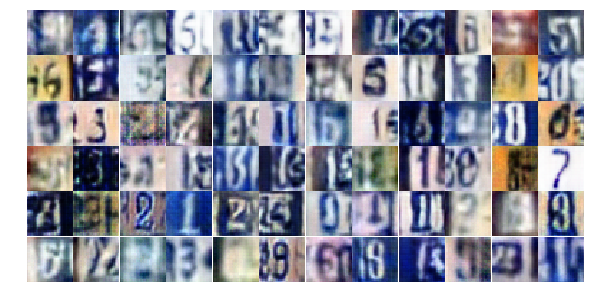

Epoch 12/25... Discriminator Loss: 1.0255... Generator Loss: 3.1712
Epoch 12/25... Discriminator Loss: 0.7511... Generator Loss: 0.9127
Epoch 12/25... Discriminator Loss: 0.8036... Generator Loss: 0.8994
Epoch 12/25... Discriminator Loss: 0.5626... Generator Loss: 1.7045
Epoch 12/25... Discriminator Loss: 0.5476... Generator Loss: 1.3453
Epoch 12/25... Discriminator Loss: 0.7827... Generator Loss: 0.8411
Epoch 12/25... Discriminator Loss: 0.5114... Generator Loss: 1.4215
Epoch 12/25... Discriminator Loss: 0.6490... Generator Loss: 1.5517
Epoch 12/25... Discriminator Loss: 0.7284... Generator Loss: 1.9436
Epoch 12/25... Discriminator Loss: 1.4167... Generator Loss: 0.3984


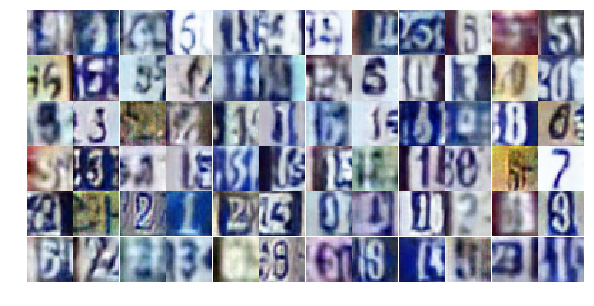

Epoch 12/25... Discriminator Loss: 0.4611... Generator Loss: 1.4067
Epoch 12/25... Discriminator Loss: 1.0487... Generator Loss: 0.5570
Epoch 12/25... Discriminator Loss: 0.5299... Generator Loss: 1.5249
Epoch 12/25... Discriminator Loss: 0.7375... Generator Loss: 1.2752
Epoch 12/25... Discriminator Loss: 0.5938... Generator Loss: 1.6577
Epoch 12/25... Discriminator Loss: 0.8224... Generator Loss: 1.0347
Epoch 12/25... Discriminator Loss: 1.8018... Generator Loss: 0.2415
Epoch 12/25... Discriminator Loss: 0.6059... Generator Loss: 1.6922
Epoch 12/25... Discriminator Loss: 0.6210... Generator Loss: 1.1820
Epoch 12/25... Discriminator Loss: 0.8150... Generator Loss: 0.8730


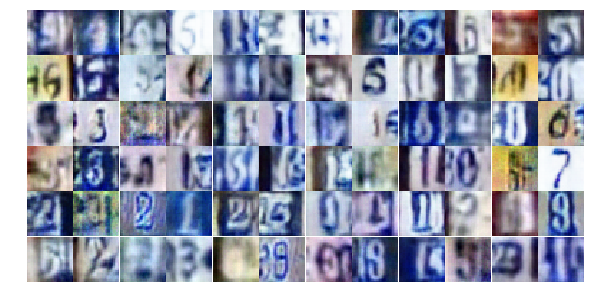

Epoch 12/25... Discriminator Loss: 0.4749... Generator Loss: 1.4564
Epoch 12/25... Discriminator Loss: 0.5832... Generator Loss: 1.5125
Epoch 12/25... Discriminator Loss: 0.7777... Generator Loss: 0.8426
Epoch 12/25... Discriminator Loss: 0.3884... Generator Loss: 2.3786
Epoch 12/25... Discriminator Loss: 0.4352... Generator Loss: 2.5931
Epoch 12/25... Discriminator Loss: 0.5131... Generator Loss: 2.1693
Epoch 12/25... Discriminator Loss: 0.5493... Generator Loss: 1.3029
Epoch 12/25... Discriminator Loss: 0.4638... Generator Loss: 1.5581
Epoch 12/25... Discriminator Loss: 0.7341... Generator Loss: 0.9389
Epoch 12/25... Discriminator Loss: 0.6131... Generator Loss: 1.1742


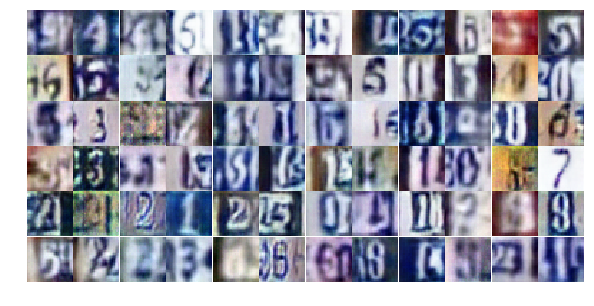

Epoch 12/25... Discriminator Loss: 0.4653... Generator Loss: 1.4154
Epoch 12/25... Discriminator Loss: 1.2463... Generator Loss: 0.5084
Epoch 12/25... Discriminator Loss: 0.7585... Generator Loss: 0.8596
Epoch 12/25... Discriminator Loss: 1.5398... Generator Loss: 0.3525
Epoch 12/25... Discriminator Loss: 0.6322... Generator Loss: 1.9272
Epoch 12/25... Discriminator Loss: 0.8230... Generator Loss: 1.0724
Epoch 12/25... Discriminator Loss: 1.0967... Generator Loss: 0.5494
Epoch 12/25... Discriminator Loss: 0.6243... Generator Loss: 1.1227
Epoch 12/25... Discriminator Loss: 0.6347... Generator Loss: 1.3295
Epoch 12/25... Discriminator Loss: 0.3840... Generator Loss: 1.4995


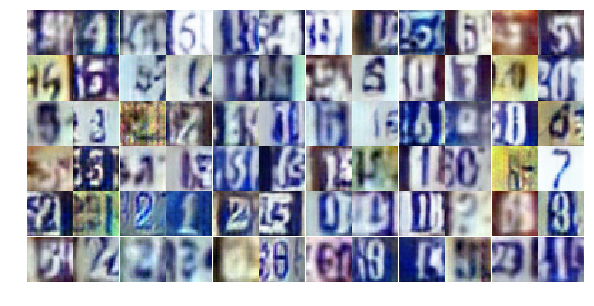

Epoch 12/25... Discriminator Loss: 0.5034... Generator Loss: 1.6314
Epoch 12/25... Discriminator Loss: 0.4426... Generator Loss: 1.4763
Epoch 12/25... Discriminator Loss: 0.5243... Generator Loss: 1.3678
Epoch 12/25... Discriminator Loss: 0.7876... Generator Loss: 0.8795
Epoch 12/25... Discriminator Loss: 1.0624... Generator Loss: 0.5968
Epoch 12/25... Discriminator Loss: 1.2225... Generator Loss: 0.5249
Epoch 12/25... Discriminator Loss: 1.4571... Generator Loss: 0.3350
Epoch 12/25... Discriminator Loss: 0.6788... Generator Loss: 1.3380
Epoch 12/25... Discriminator Loss: 0.5860... Generator Loss: 1.2011
Epoch 12/25... Discriminator Loss: 1.2647... Generator Loss: 0.4819


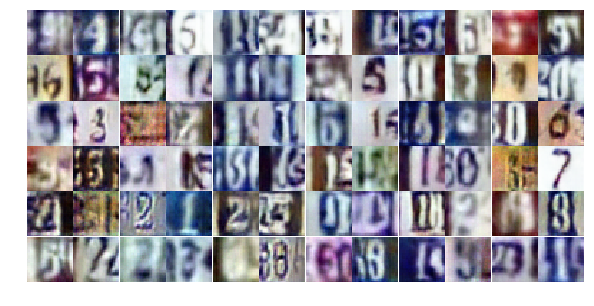

Epoch 12/25... Discriminator Loss: 0.7659... Generator Loss: 0.9058
Epoch 12/25... Discriminator Loss: 0.6258... Generator Loss: 1.0626
Epoch 12/25... Discriminator Loss: 0.5007... Generator Loss: 1.5849
Epoch 12/25... Discriminator Loss: 3.0559... Generator Loss: 0.0831
Epoch 12/25... Discriminator Loss: 0.6924... Generator Loss: 1.0515
Epoch 12/25... Discriminator Loss: 0.6123... Generator Loss: 1.5763
Epoch 12/25... Discriminator Loss: 0.7131... Generator Loss: 1.0318
Epoch 13/25... Discriminator Loss: 0.4719... Generator Loss: 1.4019
Epoch 13/25... Discriminator Loss: 0.5624... Generator Loss: 1.2855
Epoch 13/25... Discriminator Loss: 0.7416... Generator Loss: 1.1464


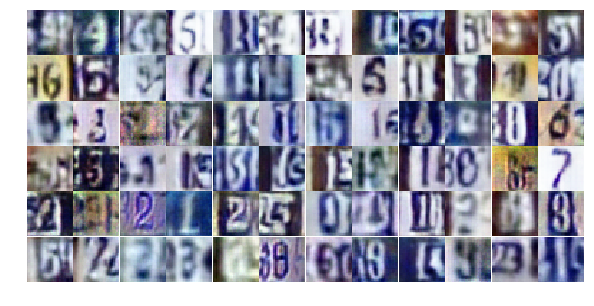

Epoch 13/25... Discriminator Loss: 0.6427... Generator Loss: 1.3770
Epoch 13/25... Discriminator Loss: 0.6349... Generator Loss: 2.3517
Epoch 13/25... Discriminator Loss: 1.3206... Generator Loss: 0.4411
Epoch 13/25... Discriminator Loss: 0.8210... Generator Loss: 0.8596
Epoch 13/25... Discriminator Loss: 0.5816... Generator Loss: 1.1444
Epoch 13/25... Discriminator Loss: 0.5866... Generator Loss: 1.1722
Epoch 13/25... Discriminator Loss: 0.3902... Generator Loss: 1.9676
Epoch 13/25... Discriminator Loss: 0.7476... Generator Loss: 0.9135
Epoch 13/25... Discriminator Loss: 0.6022... Generator Loss: 1.0668
Epoch 13/25... Discriminator Loss: 0.4998... Generator Loss: 1.8407


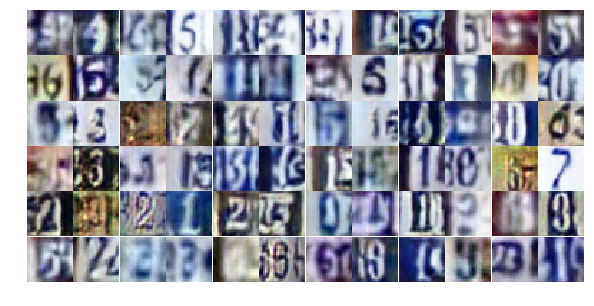

Epoch 13/25... Discriminator Loss: 1.1820... Generator Loss: 2.7969
Epoch 13/25... Discriminator Loss: 0.7270... Generator Loss: 0.8866
Epoch 13/25... Discriminator Loss: 0.8637... Generator Loss: 0.7513
Epoch 13/25... Discriminator Loss: 0.6319... Generator Loss: 1.2199
Epoch 13/25... Discriminator Loss: 0.4059... Generator Loss: 1.7952
Epoch 13/25... Discriminator Loss: 0.7711... Generator Loss: 1.8526
Epoch 13/25... Discriminator Loss: 0.6695... Generator Loss: 1.1138
Epoch 13/25... Discriminator Loss: 1.4831... Generator Loss: 0.3756
Epoch 13/25... Discriminator Loss: 0.8498... Generator Loss: 0.8431
Epoch 13/25... Discriminator Loss: 0.9040... Generator Loss: 0.6785


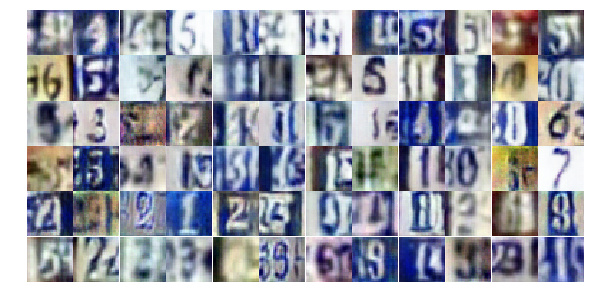

Epoch 13/25... Discriminator Loss: 0.9495... Generator Loss: 0.6710
Epoch 13/25... Discriminator Loss: 0.4775... Generator Loss: 1.5451
Epoch 13/25... Discriminator Loss: 0.5463... Generator Loss: 1.3472
Epoch 13/25... Discriminator Loss: 0.7346... Generator Loss: 0.9606
Epoch 13/25... Discriminator Loss: 0.6093... Generator Loss: 1.1924
Epoch 13/25... Discriminator Loss: 1.0706... Generator Loss: 0.6063
Epoch 13/25... Discriminator Loss: 0.8197... Generator Loss: 1.4574
Epoch 13/25... Discriminator Loss: 0.5327... Generator Loss: 1.3408
Epoch 13/25... Discriminator Loss: 0.6918... Generator Loss: 1.0120
Epoch 13/25... Discriminator Loss: 0.6527... Generator Loss: 1.1097


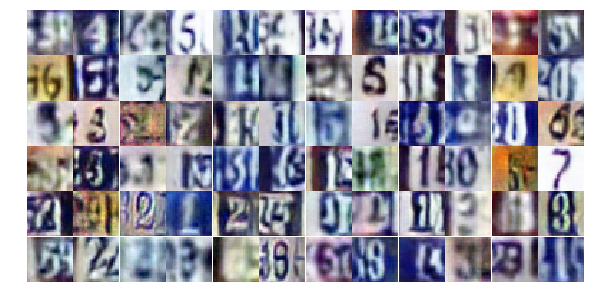

Epoch 13/25... Discriminator Loss: 0.7016... Generator Loss: 0.9340
Epoch 13/25... Discriminator Loss: 2.5623... Generator Loss: 4.2004
Epoch 13/25... Discriminator Loss: 1.5304... Generator Loss: 0.4894
Epoch 13/25... Discriminator Loss: 0.8994... Generator Loss: 0.8452
Epoch 13/25... Discriminator Loss: 0.9049... Generator Loss: 0.7611
Epoch 13/25... Discriminator Loss: 0.5425... Generator Loss: 1.2456
Epoch 13/25... Discriminator Loss: 0.5742... Generator Loss: 1.3566
Epoch 13/25... Discriminator Loss: 1.1292... Generator Loss: 0.6552
Epoch 13/25... Discriminator Loss: 0.7129... Generator Loss: 0.9529
Epoch 13/25... Discriminator Loss: 0.7300... Generator Loss: 1.1110


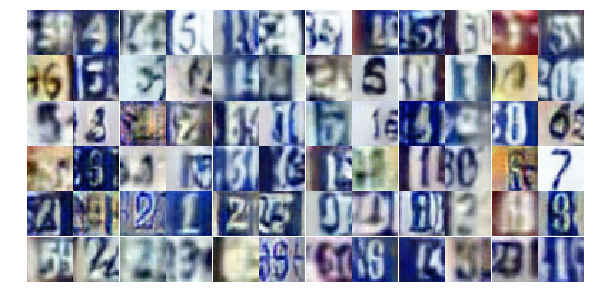

Epoch 13/25... Discriminator Loss: 0.6341... Generator Loss: 1.1930
Epoch 13/25... Discriminator Loss: 1.2497... Generator Loss: 0.9197
Epoch 13/25... Discriminator Loss: 1.1239... Generator Loss: 0.5560
Epoch 13/25... Discriminator Loss: 0.7586... Generator Loss: 0.8779
Epoch 13/25... Discriminator Loss: 1.0098... Generator Loss: 0.6502
Epoch 13/25... Discriminator Loss: 0.5534... Generator Loss: 1.3439
Epoch 13/25... Discriminator Loss: 0.7324... Generator Loss: 0.9550
Epoch 13/25... Discriminator Loss: 0.7342... Generator Loss: 0.9134
Epoch 13/25... Discriminator Loss: 0.9088... Generator Loss: 0.8026
Epoch 13/25... Discriminator Loss: 0.9692... Generator Loss: 0.7461


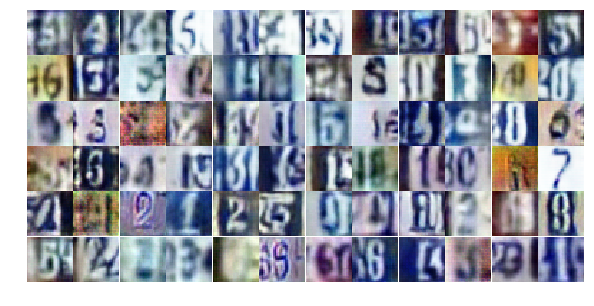

Epoch 13/25... Discriminator Loss: 0.3980... Generator Loss: 2.2474
Epoch 13/25... Discriminator Loss: 1.2963... Generator Loss: 0.4610
Epoch 13/25... Discriminator Loss: 0.7485... Generator Loss: 1.0414
Epoch 13/25... Discriminator Loss: 0.9085... Generator Loss: 0.6998
Epoch 14/25... Discriminator Loss: 0.6652... Generator Loss: 1.1442
Epoch 14/25... Discriminator Loss: 0.8532... Generator Loss: 0.8218
Epoch 14/25... Discriminator Loss: 1.0253... Generator Loss: 0.6799
Epoch 14/25... Discriminator Loss: 0.5815... Generator Loss: 1.7976
Epoch 14/25... Discriminator Loss: 0.5654... Generator Loss: 1.1945
Epoch 14/25... Discriminator Loss: 0.5999... Generator Loss: 1.2288


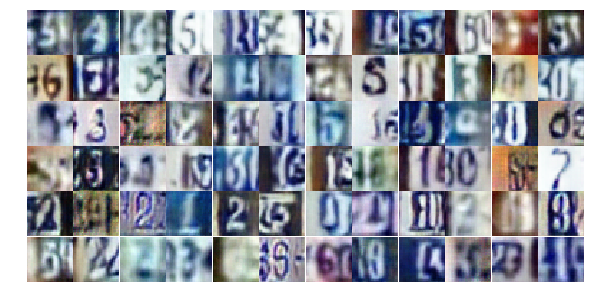

Epoch 14/25... Discriminator Loss: 1.3735... Generator Loss: 3.1441
Epoch 14/25... Discriminator Loss: 0.8784... Generator Loss: 0.7410
Epoch 14/25... Discriminator Loss: 0.7861... Generator Loss: 0.8303
Epoch 14/25... Discriminator Loss: 0.6497... Generator Loss: 1.1380
Epoch 14/25... Discriminator Loss: 0.8393... Generator Loss: 0.7773
Epoch 14/25... Discriminator Loss: 0.3706... Generator Loss: 1.9558
Epoch 14/25... Discriminator Loss: 0.4521... Generator Loss: 1.5250
Epoch 14/25... Discriminator Loss: 1.4740... Generator Loss: 0.3716
Epoch 14/25... Discriminator Loss: 1.4379... Generator Loss: 0.4032
Epoch 14/25... Discriminator Loss: 1.6427... Generator Loss: 0.2980


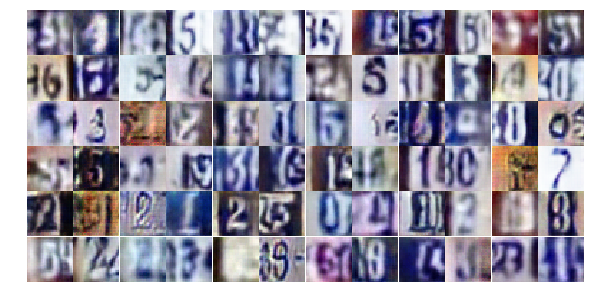

Epoch 14/25... Discriminator Loss: 0.4934... Generator Loss: 1.3105
Epoch 14/25... Discriminator Loss: 1.5698... Generator Loss: 4.0918
Epoch 14/25... Discriminator Loss: 1.6377... Generator Loss: 2.5869
Epoch 14/25... Discriminator Loss: 0.4887... Generator Loss: 1.6836
Epoch 14/25... Discriminator Loss: 0.8261... Generator Loss: 1.3271
Epoch 14/25... Discriminator Loss: 0.7815... Generator Loss: 0.9218
Epoch 14/25... Discriminator Loss: 0.7869... Generator Loss: 0.8742
Epoch 14/25... Discriminator Loss: 0.5906... Generator Loss: 1.1897
Epoch 14/25... Discriminator Loss: 0.5817... Generator Loss: 1.2714
Epoch 14/25... Discriminator Loss: 0.4898... Generator Loss: 1.3733


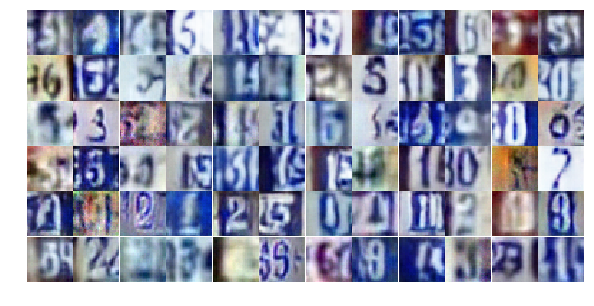

Epoch 14/25... Discriminator Loss: 1.1613... Generator Loss: 0.5363
Epoch 14/25... Discriminator Loss: 0.4860... Generator Loss: 2.0116
Epoch 14/25... Discriminator Loss: 0.6017... Generator Loss: 1.1171
Epoch 14/25... Discriminator Loss: 0.4176... Generator Loss: 1.5334
Epoch 14/25... Discriminator Loss: 0.6954... Generator Loss: 0.9487
Epoch 14/25... Discriminator Loss: 0.8792... Generator Loss: 0.7513
Epoch 14/25... Discriminator Loss: 0.8271... Generator Loss: 0.7984
Epoch 14/25... Discriminator Loss: 0.5062... Generator Loss: 2.2685
Epoch 14/25... Discriminator Loss: 0.4978... Generator Loss: 2.2111
Epoch 14/25... Discriminator Loss: 0.7589... Generator Loss: 1.5880


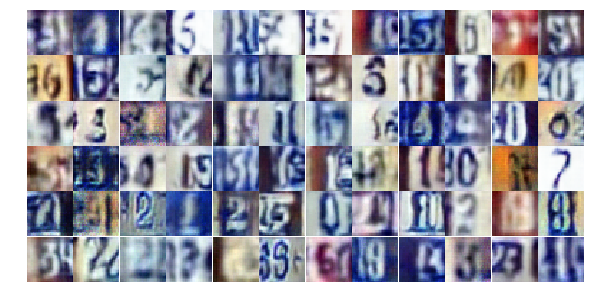

Epoch 14/25... Discriminator Loss: 1.4931... Generator Loss: 0.3840
Epoch 14/25... Discriminator Loss: 0.9692... Generator Loss: 0.6730
Epoch 14/25... Discriminator Loss: 1.2006... Generator Loss: 0.4935
Epoch 14/25... Discriminator Loss: 1.0876... Generator Loss: 0.5769
Epoch 14/25... Discriminator Loss: 0.8765... Generator Loss: 0.7477
Epoch 14/25... Discriminator Loss: 0.8557... Generator Loss: 0.8802
Epoch 14/25... Discriminator Loss: 0.7950... Generator Loss: 1.1118
Epoch 14/25... Discriminator Loss: 0.6217... Generator Loss: 1.4293
Epoch 14/25... Discriminator Loss: 1.6162... Generator Loss: 4.2750
Epoch 14/25... Discriminator Loss: 1.0342... Generator Loss: 0.6810


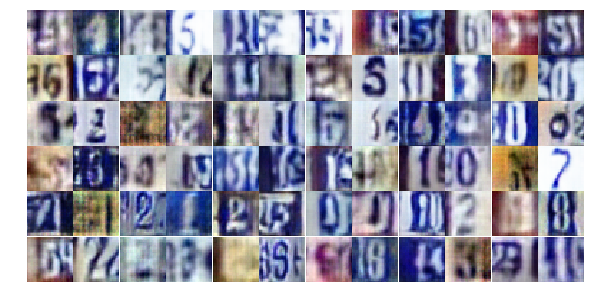

Epoch 14/25... Discriminator Loss: 1.0216... Generator Loss: 1.2178
Epoch 14/25... Discriminator Loss: 1.5465... Generator Loss: 0.3500
Epoch 14/25... Discriminator Loss: 0.7181... Generator Loss: 1.0511
Epoch 14/25... Discriminator Loss: 0.7262... Generator Loss: 1.1063
Epoch 14/25... Discriminator Loss: 0.7427... Generator Loss: 1.0888
Epoch 14/25... Discriminator Loss: 0.8047... Generator Loss: 0.8412
Epoch 14/25... Discriminator Loss: 0.7312... Generator Loss: 1.0879
Epoch 14/25... Discriminator Loss: 0.9089... Generator Loss: 0.7825
Epoch 14/25... Discriminator Loss: 1.3640... Generator Loss: 0.3875
Epoch 14/25... Discriminator Loss: 0.9417... Generator Loss: 0.7041


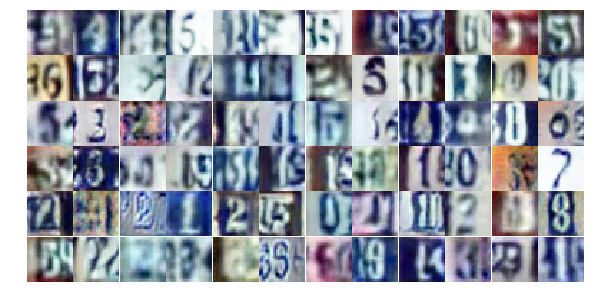

Epoch 14/25... Discriminator Loss: 0.7608... Generator Loss: 1.3023
Epoch 14/25... Discriminator Loss: 0.9432... Generator Loss: 0.9467
Epoch 15/25... Discriminator Loss: 0.6843... Generator Loss: 1.0755
Epoch 15/25... Discriminator Loss: 0.5426... Generator Loss: 1.3505
Epoch 15/25... Discriminator Loss: 0.5565... Generator Loss: 1.2219
Epoch 15/25... Discriminator Loss: 0.8172... Generator Loss: 0.9127
Epoch 15/25... Discriminator Loss: 0.5534... Generator Loss: 1.3073
Epoch 15/25... Discriminator Loss: 0.6399... Generator Loss: 1.0977
Epoch 15/25... Discriminator Loss: 1.3612... Generator Loss: 0.3980
Epoch 15/25... Discriminator Loss: 1.0657... Generator Loss: 0.6261


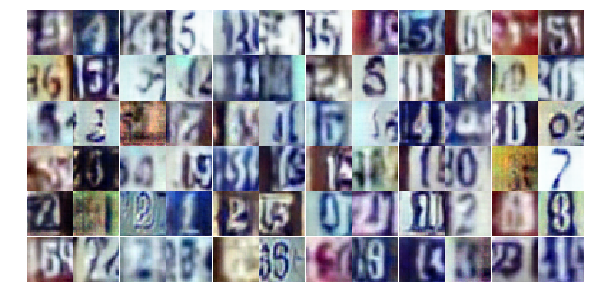

Epoch 15/25... Discriminator Loss: 0.8251... Generator Loss: 0.8512
Epoch 15/25... Discriminator Loss: 0.7744... Generator Loss: 0.9288
Epoch 15/25... Discriminator Loss: 0.8223... Generator Loss: 0.9029
Epoch 15/25... Discriminator Loss: 0.6039... Generator Loss: 1.2569
Epoch 15/25... Discriminator Loss: 1.1266... Generator Loss: 0.5859
Epoch 15/25... Discriminator Loss: 0.6123... Generator Loss: 1.3328
Epoch 15/25... Discriminator Loss: 1.3212... Generator Loss: 0.4333
Epoch 15/25... Discriminator Loss: 0.5876... Generator Loss: 1.9379
Epoch 15/25... Discriminator Loss: 0.6683... Generator Loss: 1.4132
Epoch 15/25... Discriminator Loss: 0.8631... Generator Loss: 0.8986


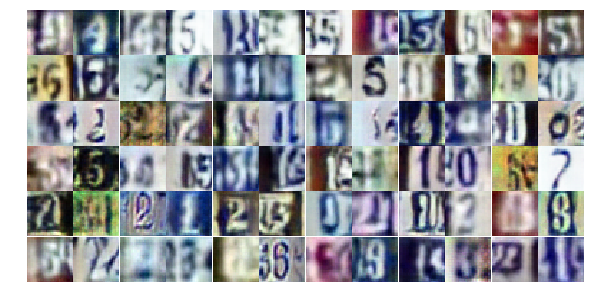

Epoch 15/25... Discriminator Loss: 0.7084... Generator Loss: 1.0204
Epoch 15/25... Discriminator Loss: 0.6657... Generator Loss: 1.0358
Epoch 15/25... Discriminator Loss: 0.5982... Generator Loss: 1.1961
Epoch 15/25... Discriminator Loss: 0.9855... Generator Loss: 0.6587
Epoch 15/25... Discriminator Loss: 1.0533... Generator Loss: 0.6827
Epoch 15/25... Discriminator Loss: 0.8895... Generator Loss: 0.7163
Epoch 15/25... Discriminator Loss: 0.7745... Generator Loss: 1.0465
Epoch 15/25... Discriminator Loss: 0.6182... Generator Loss: 1.1085
Epoch 15/25... Discriminator Loss: 0.6503... Generator Loss: 1.0058
Epoch 15/25... Discriminator Loss: 1.2849... Generator Loss: 0.4460


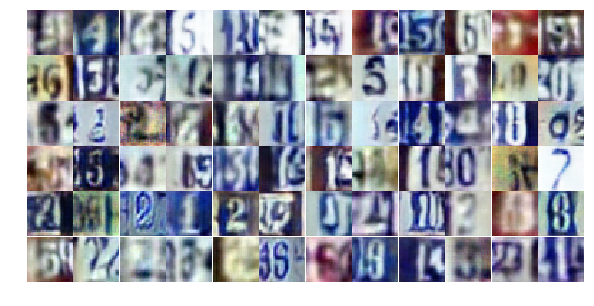

Epoch 15/25... Discriminator Loss: 0.7417... Generator Loss: 0.9939
Epoch 15/25... Discriminator Loss: 0.8572... Generator Loss: 0.8473
Epoch 15/25... Discriminator Loss: 0.3362... Generator Loss: 1.8614
Epoch 15/25... Discriminator Loss: 0.5749... Generator Loss: 1.3578
Epoch 15/25... Discriminator Loss: 0.6101... Generator Loss: 1.0931
Epoch 15/25... Discriminator Loss: 1.0102... Generator Loss: 2.4792
Epoch 15/25... Discriminator Loss: 2.3231... Generator Loss: 2.1207
Epoch 15/25... Discriminator Loss: 0.8279... Generator Loss: 0.8924
Epoch 15/25... Discriminator Loss: 0.8042... Generator Loss: 0.8145
Epoch 15/25... Discriminator Loss: 1.0734... Generator Loss: 0.6629


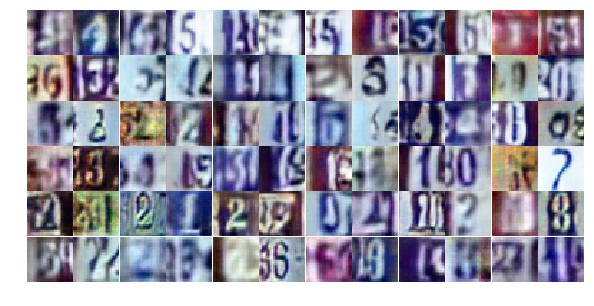

Epoch 15/25... Discriminator Loss: 0.7392... Generator Loss: 0.8737
Epoch 15/25... Discriminator Loss: 1.4587... Generator Loss: 0.3792
Epoch 15/25... Discriminator Loss: 0.6376... Generator Loss: 1.1713
Epoch 15/25... Discriminator Loss: 0.4156... Generator Loss: 1.5440
Epoch 15/25... Discriminator Loss: 0.6910... Generator Loss: 0.9242
Epoch 15/25... Discriminator Loss: 1.5651... Generator Loss: 0.3319
Epoch 15/25... Discriminator Loss: 0.8985... Generator Loss: 2.1007
Epoch 15/25... Discriminator Loss: 0.7469... Generator Loss: 1.2749
Epoch 15/25... Discriminator Loss: 0.8922... Generator Loss: 0.7323
Epoch 15/25... Discriminator Loss: 0.8072... Generator Loss: 0.8528


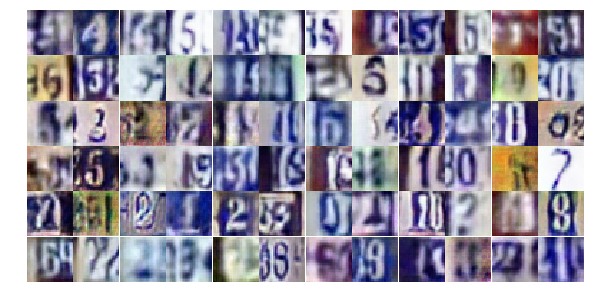

Epoch 15/25... Discriminator Loss: 1.1570... Generator Loss: 0.5730
Epoch 15/25... Discriminator Loss: 0.8443... Generator Loss: 0.7775
Epoch 15/25... Discriminator Loss: 0.5752... Generator Loss: 1.1222
Epoch 15/25... Discriminator Loss: 0.7013... Generator Loss: 1.3221
Epoch 15/25... Discriminator Loss: 0.6367... Generator Loss: 1.0329
Epoch 15/25... Discriminator Loss: 0.9768... Generator Loss: 2.0972
Epoch 15/25... Discriminator Loss: 0.8266... Generator Loss: 0.7889
Epoch 15/25... Discriminator Loss: 0.6368... Generator Loss: 1.1248
Epoch 15/25... Discriminator Loss: 1.3463... Generator Loss: 0.4338
Epoch 16/25... Discriminator Loss: 1.1710... Generator Loss: 0.5580


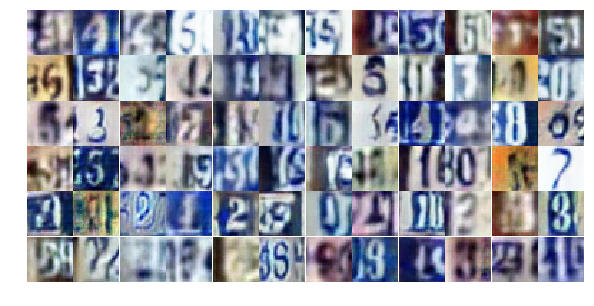

Epoch 16/25... Discriminator Loss: 0.7388... Generator Loss: 1.0001
Epoch 16/25... Discriminator Loss: 0.8996... Generator Loss: 0.8493
Epoch 16/25... Discriminator Loss: 0.9367... Generator Loss: 0.6861
Epoch 16/25... Discriminator Loss: 0.5851... Generator Loss: 1.4463
Epoch 16/25... Discriminator Loss: 0.8026... Generator Loss: 0.9107
Epoch 16/25... Discriminator Loss: 0.9070... Generator Loss: 0.7448
Epoch 16/25... Discriminator Loss: 1.2715... Generator Loss: 0.4602
Epoch 16/25... Discriminator Loss: 0.8900... Generator Loss: 0.7711
Epoch 16/25... Discriminator Loss: 0.6215... Generator Loss: 1.0804
Epoch 16/25... Discriminator Loss: 0.5862... Generator Loss: 1.1347


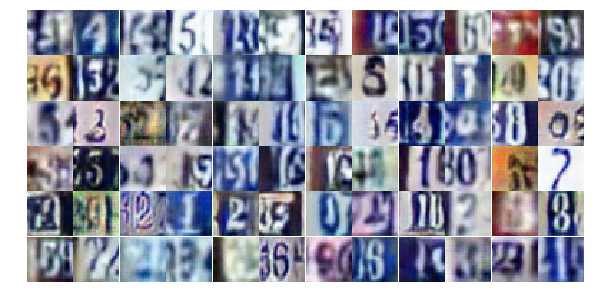

Epoch 16/25... Discriminator Loss: 1.5910... Generator Loss: 0.3628
Epoch 16/25... Discriminator Loss: 0.6235... Generator Loss: 1.1863
Epoch 16/25... Discriminator Loss: 0.7778... Generator Loss: 0.8976
Epoch 16/25... Discriminator Loss: 0.8880... Generator Loss: 0.7670
Epoch 16/25... Discriminator Loss: 0.5155... Generator Loss: 1.5199
Epoch 16/25... Discriminator Loss: 0.6381... Generator Loss: 1.2226
Epoch 16/25... Discriminator Loss: 1.8086... Generator Loss: 0.3475
Epoch 16/25... Discriminator Loss: 0.8316... Generator Loss: 2.1132
Epoch 16/25... Discriminator Loss: 0.5611... Generator Loss: 1.3202
Epoch 16/25... Discriminator Loss: 0.5702... Generator Loss: 1.6595


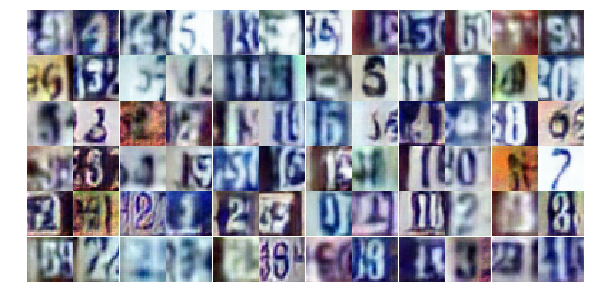

Epoch 16/25... Discriminator Loss: 0.8823... Generator Loss: 0.8732
Epoch 16/25... Discriminator Loss: 0.5927... Generator Loss: 1.2118
Epoch 16/25... Discriminator Loss: 0.8406... Generator Loss: 0.8900
Epoch 16/25... Discriminator Loss: 1.1089... Generator Loss: 0.5470
Epoch 16/25... Discriminator Loss: 0.7043... Generator Loss: 1.0029
Epoch 16/25... Discriminator Loss: 0.8861... Generator Loss: 0.7391
Epoch 16/25... Discriminator Loss: 0.7725... Generator Loss: 0.8937
Epoch 16/25... Discriminator Loss: 0.5989... Generator Loss: 1.4682
Epoch 16/25... Discriminator Loss: 0.7677... Generator Loss: 0.9171
Epoch 16/25... Discriminator Loss: 0.7057... Generator Loss: 0.9531


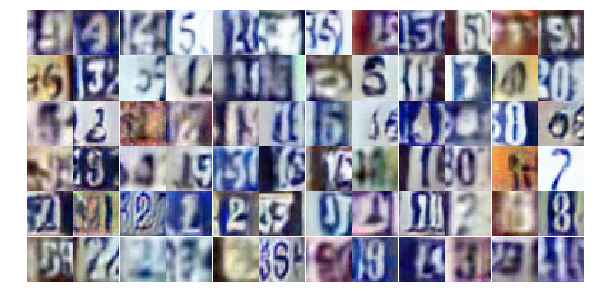

Epoch 16/25... Discriminator Loss: 0.6561... Generator Loss: 0.9538
Epoch 16/25... Discriminator Loss: 0.4463... Generator Loss: 1.4875
Epoch 16/25... Discriminator Loss: 0.6742... Generator Loss: 1.4240
Epoch 16/25... Discriminator Loss: 0.8682... Generator Loss: 0.8040
Epoch 16/25... Discriminator Loss: 1.1487... Generator Loss: 0.5598
Epoch 16/25... Discriminator Loss: 0.4657... Generator Loss: 1.9151
Epoch 16/25... Discriminator Loss: 1.3921... Generator Loss: 0.4402
Epoch 16/25... Discriminator Loss: 1.0342... Generator Loss: 0.6853
Epoch 16/25... Discriminator Loss: 0.8194... Generator Loss: 0.8986
Epoch 16/25... Discriminator Loss: 0.5339... Generator Loss: 1.7981


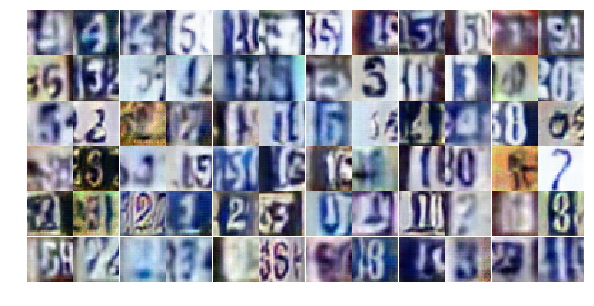

Epoch 16/25... Discriminator Loss: 0.7146... Generator Loss: 1.0271
Epoch 16/25... Discriminator Loss: 0.5757... Generator Loss: 1.2977
Epoch 16/25... Discriminator Loss: 1.5082... Generator Loss: 0.3787
Epoch 16/25... Discriminator Loss: 1.1175... Generator Loss: 0.5991
Epoch 16/25... Discriminator Loss: 0.7418... Generator Loss: 1.0031
Epoch 16/25... Discriminator Loss: 1.4340... Generator Loss: 1.1492
Epoch 16/25... Discriminator Loss: 0.6331... Generator Loss: 1.3040
Epoch 16/25... Discriminator Loss: 0.7415... Generator Loss: 0.9328
Epoch 16/25... Discriminator Loss: 0.6290... Generator Loss: 1.0287
Epoch 16/25... Discriminator Loss: 1.0294... Generator Loss: 0.6799


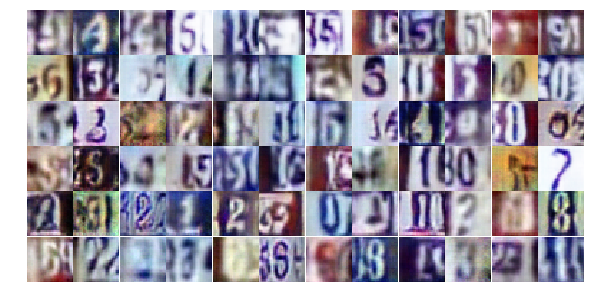

Epoch 16/25... Discriminator Loss: 1.5751... Generator Loss: 0.3157
Epoch 16/25... Discriminator Loss: 0.5404... Generator Loss: 1.4677
Epoch 16/25... Discriminator Loss: 1.2562... Generator Loss: 0.5460
Epoch 16/25... Discriminator Loss: 0.5829... Generator Loss: 2.0055
Epoch 16/25... Discriminator Loss: 0.7969... Generator Loss: 0.8429
Epoch 16/25... Discriminator Loss: 1.1693... Generator Loss: 0.5015
Epoch 17/25... Discriminator Loss: 0.5745... Generator Loss: 1.6475
Epoch 17/25... Discriminator Loss: 1.0112... Generator Loss: 0.6554
Epoch 17/25... Discriminator Loss: 0.6849... Generator Loss: 1.0455
Epoch 17/25... Discriminator Loss: 0.7438... Generator Loss: 0.9801


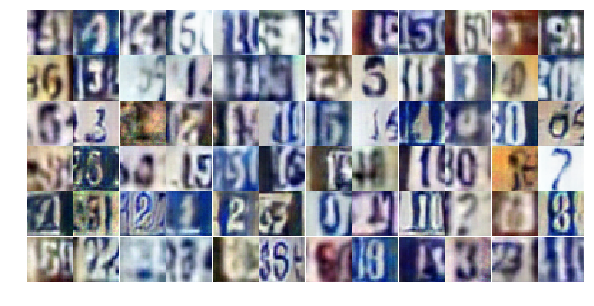

Epoch 17/25... Discriminator Loss: 0.4006... Generator Loss: 1.7481
Epoch 17/25... Discriminator Loss: 0.4946... Generator Loss: 1.6279
Epoch 17/25... Discriminator Loss: 1.0842... Generator Loss: 0.6955
Epoch 17/25... Discriminator Loss: 0.6565... Generator Loss: 1.0160
Epoch 17/25... Discriminator Loss: 1.0450... Generator Loss: 0.6784
Epoch 17/25... Discriminator Loss: 1.0279... Generator Loss: 0.7177
Epoch 17/25... Discriminator Loss: 0.7757... Generator Loss: 0.8844
Epoch 17/25... Discriminator Loss: 0.5287... Generator Loss: 1.1988
Epoch 17/25... Discriminator Loss: 0.3060... Generator Loss: 1.8871
Epoch 17/25... Discriminator Loss: 0.5053... Generator Loss: 1.4305


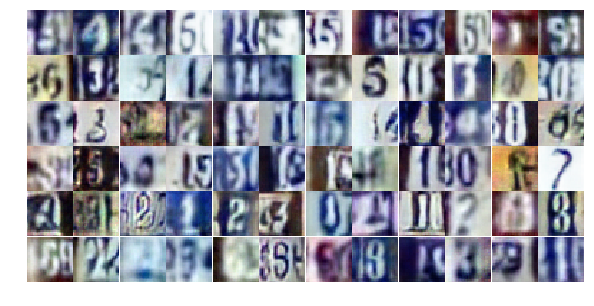

Epoch 17/25... Discriminator Loss: 0.7972... Generator Loss: 1.5879
Epoch 17/25... Discriminator Loss: 0.8380... Generator Loss: 0.7903
Epoch 17/25... Discriminator Loss: 0.6286... Generator Loss: 1.0347
Epoch 17/25... Discriminator Loss: 3.2256... Generator Loss: 0.1297
Epoch 17/25... Discriminator Loss: 1.8066... Generator Loss: 0.4579
Epoch 17/25... Discriminator Loss: 1.0618... Generator Loss: 0.6948
Epoch 17/25... Discriminator Loss: 0.7164... Generator Loss: 1.6247
Epoch 17/25... Discriminator Loss: 0.6841... Generator Loss: 1.1891
Epoch 17/25... Discriminator Loss: 0.7322... Generator Loss: 1.8514
Epoch 17/25... Discriminator Loss: 0.6826... Generator Loss: 0.9858


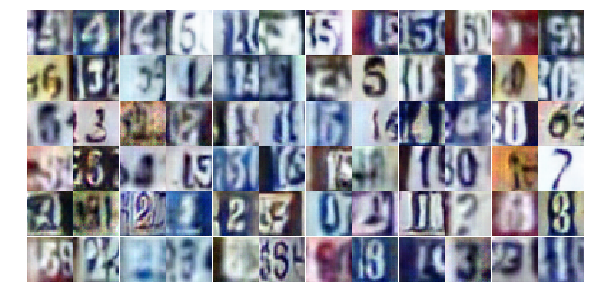

Epoch 17/25... Discriminator Loss: 1.1498... Generator Loss: 0.5657
Epoch 17/25... Discriminator Loss: 0.3561... Generator Loss: 1.8871
Epoch 17/25... Discriminator Loss: 0.5242... Generator Loss: 1.5231
Epoch 17/25... Discriminator Loss: 1.1729... Generator Loss: 0.5173
Epoch 17/25... Discriminator Loss: 1.1252... Generator Loss: 0.6508
Epoch 17/25... Discriminator Loss: 0.5833... Generator Loss: 1.1259
Epoch 17/25... Discriminator Loss: 1.0335... Generator Loss: 0.6572
Epoch 17/25... Discriminator Loss: 0.7535... Generator Loss: 0.9738
Epoch 17/25... Discriminator Loss: 0.8382... Generator Loss: 0.9171
Epoch 17/25... Discriminator Loss: 0.4759... Generator Loss: 1.6169


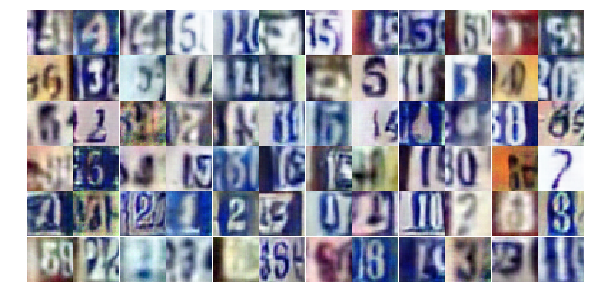

Epoch 17/25... Discriminator Loss: 0.5899... Generator Loss: 1.5830
Epoch 17/25... Discriminator Loss: 1.4591... Generator Loss: 0.4098
Epoch 17/25... Discriminator Loss: 0.5424... Generator Loss: 1.3237
Epoch 17/25... Discriminator Loss: 0.9174... Generator Loss: 0.8056
Epoch 17/25... Discriminator Loss: 0.7888... Generator Loss: 0.8597
Epoch 17/25... Discriminator Loss: 0.7424... Generator Loss: 0.9056
Epoch 17/25... Discriminator Loss: 0.7134... Generator Loss: 1.3149
Epoch 17/25... Discriminator Loss: 0.5201... Generator Loss: 1.4762
Epoch 17/25... Discriminator Loss: 0.5695... Generator Loss: 1.1175
Epoch 17/25... Discriminator Loss: 1.1366... Generator Loss: 0.5314


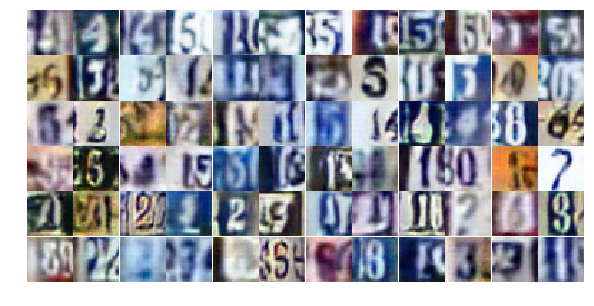

Epoch 17/25... Discriminator Loss: 1.6125... Generator Loss: 0.7109
Epoch 17/25... Discriminator Loss: 0.4119... Generator Loss: 1.9502
Epoch 17/25... Discriminator Loss: 0.7559... Generator Loss: 1.2661
Epoch 17/25... Discriminator Loss: 0.5268... Generator Loss: 1.2350
Epoch 17/25... Discriminator Loss: 0.7848... Generator Loss: 0.9235
Epoch 17/25... Discriminator Loss: 0.8153... Generator Loss: 0.9238
Epoch 17/25... Discriminator Loss: 0.9103... Generator Loss: 0.7335
Epoch 17/25... Discriminator Loss: 0.7157... Generator Loss: 0.9693
Epoch 17/25... Discriminator Loss: 0.7464... Generator Loss: 0.9334
Epoch 17/25... Discriminator Loss: 1.8106... Generator Loss: 0.2989


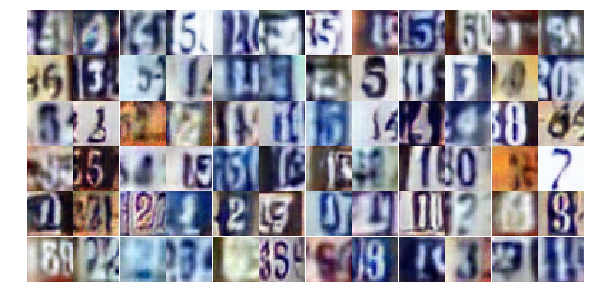

Epoch 17/25... Discriminator Loss: 0.7645... Generator Loss: 1.2598
Epoch 17/25... Discriminator Loss: 0.9955... Generator Loss: 0.9064
Epoch 17/25... Discriminator Loss: 0.7576... Generator Loss: 0.9422
Epoch 17/25... Discriminator Loss: 0.5958... Generator Loss: 1.6655
Epoch 18/25... Discriminator Loss: 0.9736... Generator Loss: 0.7540
Epoch 18/25... Discriminator Loss: 0.7705... Generator Loss: 0.9134
Epoch 18/25... Discriminator Loss: 0.7296... Generator Loss: 1.0928
Epoch 18/25... Discriminator Loss: 0.7143... Generator Loss: 0.9658
Epoch 18/25... Discriminator Loss: 0.7904... Generator Loss: 0.8616
Epoch 18/25... Discriminator Loss: 0.7098... Generator Loss: 1.1817


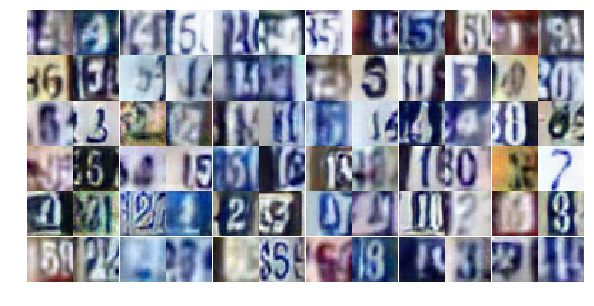

Epoch 18/25... Discriminator Loss: 0.4086... Generator Loss: 1.6638
Epoch 18/25... Discriminator Loss: 1.3709... Generator Loss: 0.4250
Epoch 18/25... Discriminator Loss: 0.9997... Generator Loss: 0.6090
Epoch 18/25... Discriminator Loss: 0.3675... Generator Loss: 1.9710
Epoch 18/25... Discriminator Loss: 0.7462... Generator Loss: 0.8948
Epoch 18/25... Discriminator Loss: 0.8992... Generator Loss: 0.7691
Epoch 18/25... Discriminator Loss: 0.6011... Generator Loss: 1.1234
Epoch 18/25... Discriminator Loss: 1.0306... Generator Loss: 0.6549
Epoch 18/25... Discriminator Loss: 1.9262... Generator Loss: 4.1576
Epoch 18/25... Discriminator Loss: 0.3677... Generator Loss: 1.9074


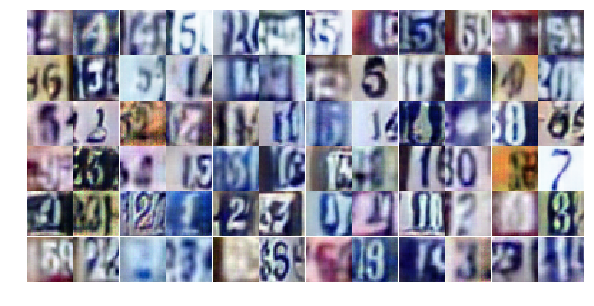

Epoch 18/25... Discriminator Loss: 0.6535... Generator Loss: 1.5544
Epoch 18/25... Discriminator Loss: 0.6901... Generator Loss: 1.0139
Epoch 18/25... Discriminator Loss: 1.1161... Generator Loss: 0.6388
Epoch 18/25... Discriminator Loss: 0.5641... Generator Loss: 1.3992
Epoch 18/25... Discriminator Loss: 1.0084... Generator Loss: 0.6556
Epoch 18/25... Discriminator Loss: 1.0779... Generator Loss: 0.5764
Epoch 18/25... Discriminator Loss: 0.8677... Generator Loss: 0.9365
Epoch 18/25... Discriminator Loss: 1.0868... Generator Loss: 0.5575
Epoch 18/25... Discriminator Loss: 0.6845... Generator Loss: 1.1260
Epoch 18/25... Discriminator Loss: 0.4902... Generator Loss: 1.5748


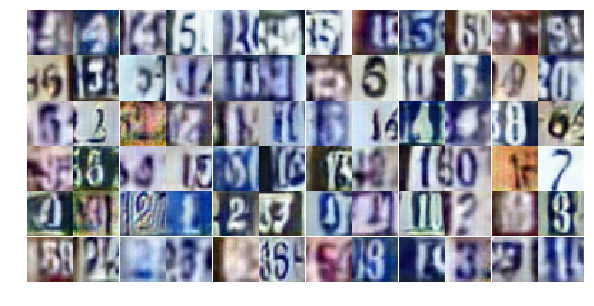

Epoch 18/25... Discriminator Loss: 0.5287... Generator Loss: 1.1948
Epoch 18/25... Discriminator Loss: 0.7499... Generator Loss: 0.9940
Epoch 18/25... Discriminator Loss: 1.0199... Generator Loss: 0.6577
Epoch 18/25... Discriminator Loss: 0.5140... Generator Loss: 1.7605
Epoch 18/25... Discriminator Loss: 1.0824... Generator Loss: 0.5546
Epoch 18/25... Discriminator Loss: 0.5428... Generator Loss: 1.2035
Epoch 18/25... Discriminator Loss: 0.7113... Generator Loss: 1.0881
Epoch 18/25... Discriminator Loss: 0.6466... Generator Loss: 1.0636
Epoch 18/25... Discriminator Loss: 1.1677... Generator Loss: 2.4302
Epoch 18/25... Discriminator Loss: 1.8467... Generator Loss: 0.2572


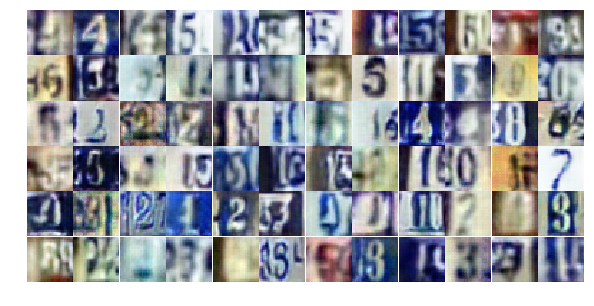

Epoch 18/25... Discriminator Loss: 0.7164... Generator Loss: 1.0253
Epoch 18/25... Discriminator Loss: 0.7447... Generator Loss: 1.1482
Epoch 18/25... Discriminator Loss: 0.7280... Generator Loss: 0.9478
Epoch 18/25... Discriminator Loss: 0.7284... Generator Loss: 0.8933
Epoch 18/25... Discriminator Loss: 1.0073... Generator Loss: 0.6674
Epoch 18/25... Discriminator Loss: 0.4143... Generator Loss: 1.4621
Epoch 18/25... Discriminator Loss: 0.7110... Generator Loss: 1.0731
Epoch 18/25... Discriminator Loss: 1.3401... Generator Loss: 3.1443
Epoch 18/25... Discriminator Loss: 0.9844... Generator Loss: 0.6751
Epoch 18/25... Discriminator Loss: 0.3928... Generator Loss: 1.8274


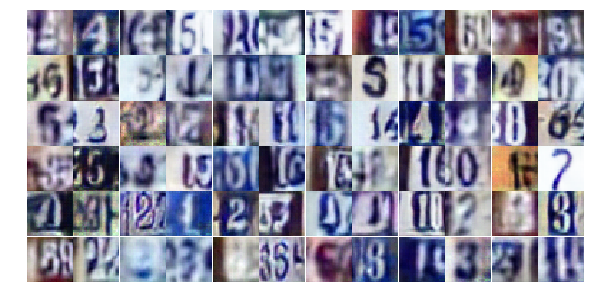

Epoch 18/25... Discriminator Loss: 0.6388... Generator Loss: 1.0348
Epoch 18/25... Discriminator Loss: 0.6999... Generator Loss: 1.1074
Epoch 18/25... Discriminator Loss: 0.8026... Generator Loss: 0.8282
Epoch 18/25... Discriminator Loss: 1.0676... Generator Loss: 0.6171
Epoch 18/25... Discriminator Loss: 0.6328... Generator Loss: 1.2225
Epoch 18/25... Discriminator Loss: 0.6734... Generator Loss: 1.7572
Epoch 18/25... Discriminator Loss: 1.1926... Generator Loss: 0.5787
Epoch 18/25... Discriminator Loss: 0.5659... Generator Loss: 1.7507
Epoch 18/25... Discriminator Loss: 1.0067... Generator Loss: 0.6843
Epoch 18/25... Discriminator Loss: 0.9630... Generator Loss: 0.6599


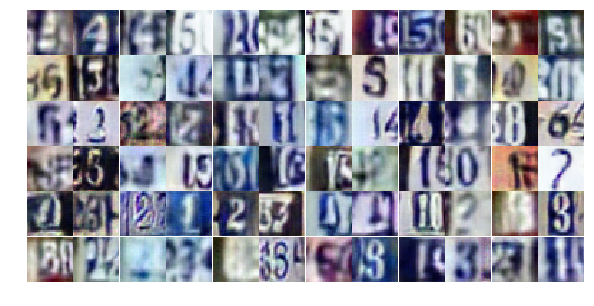

Epoch 18/25... Discriminator Loss: 0.9557... Generator Loss: 1.9249
Epoch 19/25... Discriminator Loss: 0.9419... Generator Loss: 0.9217
Epoch 19/25... Discriminator Loss: 1.0585... Generator Loss: 0.6072
Epoch 19/25... Discriminator Loss: 1.0493... Generator Loss: 0.6510
Epoch 19/25... Discriminator Loss: 0.6627... Generator Loss: 1.2395
Epoch 19/25... Discriminator Loss: 1.2256... Generator Loss: 0.5351
Epoch 19/25... Discriminator Loss: 0.6396... Generator Loss: 1.1768
Epoch 19/25... Discriminator Loss: 0.9288... Generator Loss: 0.7394
Epoch 19/25... Discriminator Loss: 0.9060... Generator Loss: 0.7212
Epoch 19/25... Discriminator Loss: 1.0011... Generator Loss: 0.6549


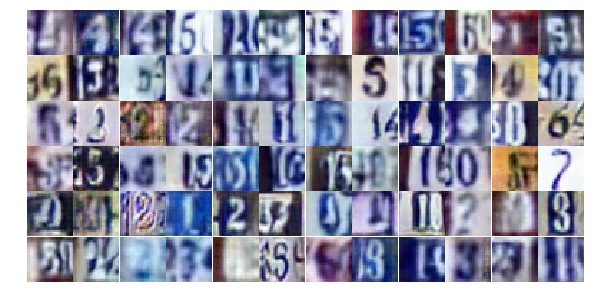

Epoch 19/25... Discriminator Loss: 0.8184... Generator Loss: 0.8170
Epoch 19/25... Discriminator Loss: 1.1730... Generator Loss: 0.5408
Epoch 19/25... Discriminator Loss: 1.1511... Generator Loss: 0.5848
Epoch 19/25... Discriminator Loss: 1.3250... Generator Loss: 0.4496
Epoch 19/25... Discriminator Loss: 0.7083... Generator Loss: 0.9770
Epoch 19/25... Discriminator Loss: 0.5732... Generator Loss: 1.2841
Epoch 19/25... Discriminator Loss: 1.0053... Generator Loss: 0.6731
Epoch 19/25... Discriminator Loss: 0.5012... Generator Loss: 1.4741
Epoch 19/25... Discriminator Loss: 0.8318... Generator Loss: 2.7271
Epoch 19/25... Discriminator Loss: 0.8897... Generator Loss: 0.8176


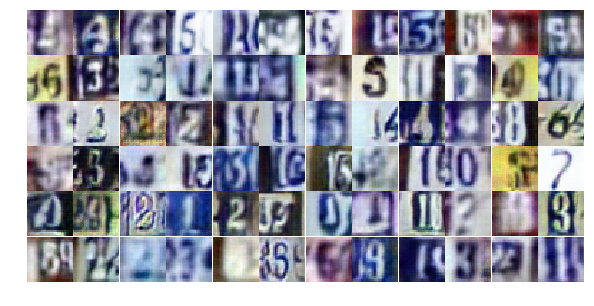

Epoch 19/25... Discriminator Loss: 0.9413... Generator Loss: 0.7245
Epoch 19/25... Discriminator Loss: 1.1588... Generator Loss: 0.6953
Epoch 19/25... Discriminator Loss: 1.2332... Generator Loss: 0.4582
Epoch 19/25... Discriminator Loss: 0.8717... Generator Loss: 0.7743
Epoch 19/25... Discriminator Loss: 1.6708... Generator Loss: 0.3766
Epoch 19/25... Discriminator Loss: 0.7736... Generator Loss: 0.9960
Epoch 19/25... Discriminator Loss: 1.0759... Generator Loss: 0.6598
Epoch 19/25... Discriminator Loss: 0.4973... Generator Loss: 1.8478
Epoch 19/25... Discriminator Loss: 1.3443... Generator Loss: 0.4658
Epoch 19/25... Discriminator Loss: 1.2594... Generator Loss: 0.5704


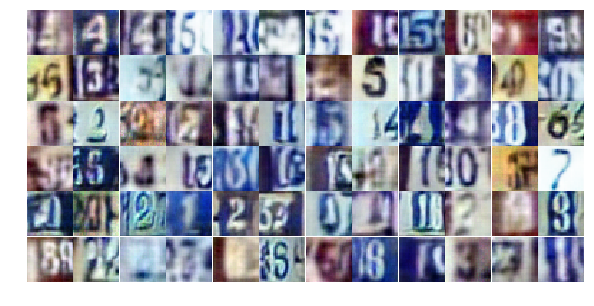

Epoch 19/25... Discriminator Loss: 0.8540... Generator Loss: 0.9428
Epoch 19/25... Discriminator Loss: 0.7225... Generator Loss: 0.9298
Epoch 19/25... Discriminator Loss: 1.0042... Generator Loss: 0.6805
Epoch 19/25... Discriminator Loss: 0.6652... Generator Loss: 1.0795
Epoch 19/25... Discriminator Loss: 0.7952... Generator Loss: 0.8601
Epoch 19/25... Discriminator Loss: 1.3545... Generator Loss: 0.4030
Epoch 19/25... Discriminator Loss: 0.8336... Generator Loss: 1.7066
Epoch 19/25... Discriminator Loss: 0.7452... Generator Loss: 0.9302
Epoch 19/25... Discriminator Loss: 1.0314... Generator Loss: 1.9838
Epoch 19/25... Discriminator Loss: 0.5873... Generator Loss: 1.1239


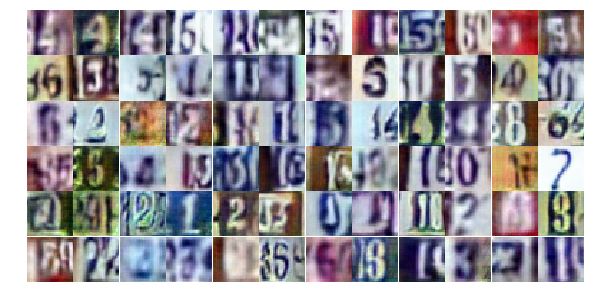

Epoch 19/25... Discriminator Loss: 0.5077... Generator Loss: 1.5678
Epoch 19/25... Discriminator Loss: 1.3272... Generator Loss: 0.4304
Epoch 19/25... Discriminator Loss: 0.6991... Generator Loss: 0.9463
Epoch 19/25... Discriminator Loss: 0.8161... Generator Loss: 0.8170
Epoch 19/25... Discriminator Loss: 0.7963... Generator Loss: 0.9977
Epoch 19/25... Discriminator Loss: 0.9091... Generator Loss: 0.9024
Epoch 19/25... Discriminator Loss: 0.6743... Generator Loss: 1.0598
Epoch 19/25... Discriminator Loss: 0.3977... Generator Loss: 2.2938
Epoch 19/25... Discriminator Loss: 0.8780... Generator Loss: 0.8699
Epoch 19/25... Discriminator Loss: 0.7658... Generator Loss: 0.9622


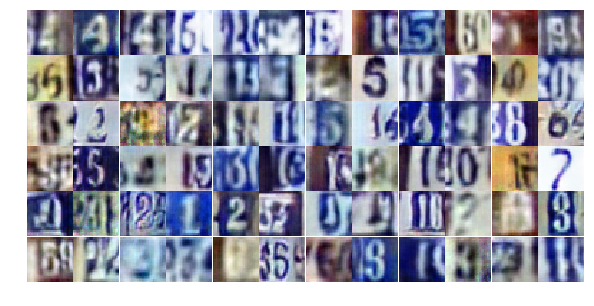

Epoch 19/25... Discriminator Loss: 0.7867... Generator Loss: 0.8697
Epoch 19/25... Discriminator Loss: 0.8388... Generator Loss: 0.8546
Epoch 19/25... Discriminator Loss: 0.6401... Generator Loss: 1.1860
Epoch 19/25... Discriminator Loss: 0.7096... Generator Loss: 1.0492
Epoch 19/25... Discriminator Loss: 0.9090... Generator Loss: 2.2908
Epoch 19/25... Discriminator Loss: 0.9253... Generator Loss: 0.7619
Epoch 19/25... Discriminator Loss: 1.9602... Generator Loss: 0.2916
Epoch 19/25... Discriminator Loss: 7.1409... Generator Loss: 0.0033
Epoch 20/25... Discriminator Loss: 1.0676... Generator Loss: 1.0591
Epoch 20/25... Discriminator Loss: 0.9759... Generator Loss: 1.1316


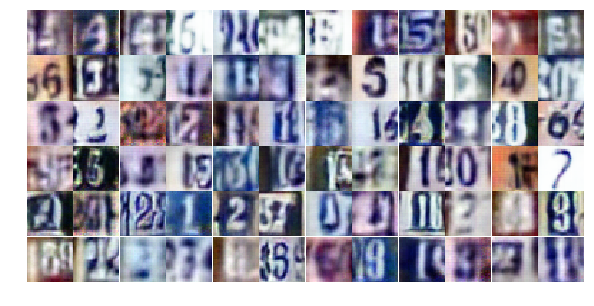

Epoch 20/25... Discriminator Loss: 0.9362... Generator Loss: 1.2014
Epoch 20/25... Discriminator Loss: 1.0793... Generator Loss: 0.6127
Epoch 20/25... Discriminator Loss: 1.2109... Generator Loss: 0.5291
Epoch 20/25... Discriminator Loss: 1.2019... Generator Loss: 0.4971
Epoch 20/25... Discriminator Loss: 0.7198... Generator Loss: 1.0107
Epoch 20/25... Discriminator Loss: 0.7459... Generator Loss: 1.0549
Epoch 20/25... Discriminator Loss: 0.7640... Generator Loss: 0.9456
Epoch 20/25... Discriminator Loss: 0.7385... Generator Loss: 0.9946
Epoch 20/25... Discriminator Loss: 0.8651... Generator Loss: 0.9371
Epoch 20/25... Discriminator Loss: 0.8199... Generator Loss: 0.7999


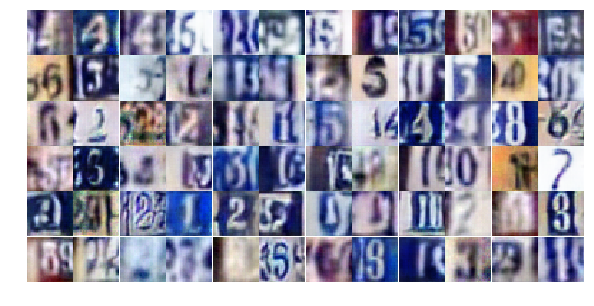

Epoch 20/25... Discriminator Loss: 1.1349... Generator Loss: 0.5831
Epoch 20/25... Discriminator Loss: 1.0165... Generator Loss: 0.6490
Epoch 20/25... Discriminator Loss: 0.6437... Generator Loss: 1.1264
Epoch 20/25... Discriminator Loss: 0.6891... Generator Loss: 1.0336
Epoch 20/25... Discriminator Loss: 0.8349... Generator Loss: 0.8112
Epoch 20/25... Discriminator Loss: 1.1777... Generator Loss: 0.5127
Epoch 20/25... Discriminator Loss: 0.9336... Generator Loss: 0.7777
Epoch 20/25... Discriminator Loss: 0.9391... Generator Loss: 0.7521
Epoch 20/25... Discriminator Loss: 0.9833... Generator Loss: 0.6777
Epoch 20/25... Discriminator Loss: 0.7905... Generator Loss: 1.0210


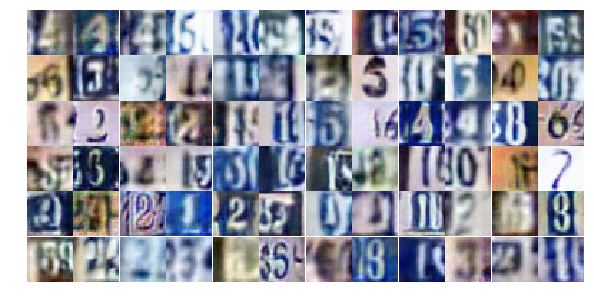

Epoch 20/25... Discriminator Loss: 0.7204... Generator Loss: 0.8885
Epoch 20/25... Discriminator Loss: 0.6654... Generator Loss: 1.1290
Epoch 20/25... Discriminator Loss: 0.3223... Generator Loss: 1.8459
Epoch 20/25... Discriminator Loss: 1.1863... Generator Loss: 0.5518
Epoch 20/25... Discriminator Loss: 0.9194... Generator Loss: 0.7708
Epoch 20/25... Discriminator Loss: 0.5873... Generator Loss: 1.1464
Epoch 20/25... Discriminator Loss: 0.4718... Generator Loss: 1.7925
Epoch 20/25... Discriminator Loss: 1.5205... Generator Loss: 0.4050
Epoch 20/25... Discriminator Loss: 0.8576... Generator Loss: 0.7518
Epoch 20/25... Discriminator Loss: 0.5121... Generator Loss: 1.2661


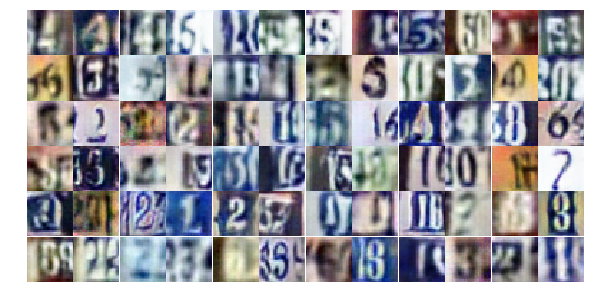

Epoch 20/25... Discriminator Loss: 0.9459... Generator Loss: 0.8610
Epoch 20/25... Discriminator Loss: 0.7447... Generator Loss: 0.8833
Epoch 20/25... Discriminator Loss: 1.1303... Generator Loss: 0.5775
Epoch 20/25... Discriminator Loss: 0.5598... Generator Loss: 1.2481
Epoch 20/25... Discriminator Loss: 1.2251... Generator Loss: 0.5188
Epoch 20/25... Discriminator Loss: 0.6095... Generator Loss: 1.1405
Epoch 20/25... Discriminator Loss: 0.9197... Generator Loss: 1.8112
Epoch 20/25... Discriminator Loss: 0.7110... Generator Loss: 1.1705
Epoch 20/25... Discriminator Loss: 0.9959... Generator Loss: 0.6677
Epoch 20/25... Discriminator Loss: 0.9289... Generator Loss: 0.7215


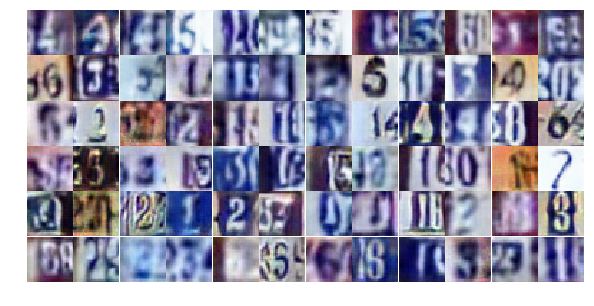

Epoch 20/25... Discriminator Loss: 0.7108... Generator Loss: 0.9662
Epoch 20/25... Discriminator Loss: 1.3944... Generator Loss: 0.3912
Epoch 20/25... Discriminator Loss: 1.0123... Generator Loss: 3.3321
Epoch 20/25... Discriminator Loss: 0.8806... Generator Loss: 0.8876
Epoch 20/25... Discriminator Loss: 1.0575... Generator Loss: 0.6707
Epoch 20/25... Discriminator Loss: 1.4271... Generator Loss: 0.4200
Epoch 20/25... Discriminator Loss: 1.0468... Generator Loss: 0.6290
Epoch 20/25... Discriminator Loss: 0.5457... Generator Loss: 1.2920
Epoch 20/25... Discriminator Loss: 0.7940... Generator Loss: 1.1455
Epoch 20/25... Discriminator Loss: 0.7264... Generator Loss: 1.0321


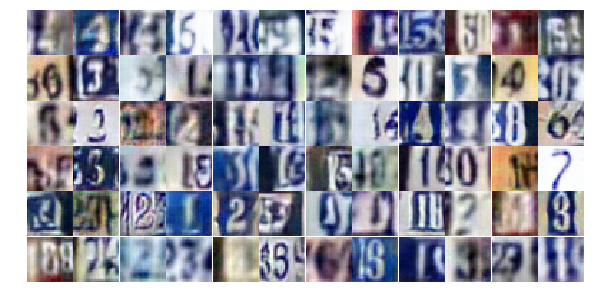

Epoch 20/25... Discriminator Loss: 0.5936... Generator Loss: 1.2146
Epoch 20/25... Discriminator Loss: 0.8988... Generator Loss: 0.8385
Epoch 20/25... Discriminator Loss: 0.5194... Generator Loss: 1.4744
Epoch 20/25... Discriminator Loss: 0.9952... Generator Loss: 0.7478
Epoch 20/25... Discriminator Loss: 0.5745... Generator Loss: 1.3836
Epoch 20/25... Discriminator Loss: 0.5187... Generator Loss: 1.5164
Epoch 21/25... Discriminator Loss: 0.8834... Generator Loss: 0.8132
Epoch 21/25... Discriminator Loss: 0.8120... Generator Loss: 0.7881
Epoch 21/25... Discriminator Loss: 1.0907... Generator Loss: 0.6767
Epoch 21/25... Discriminator Loss: 0.9160... Generator Loss: 0.7800


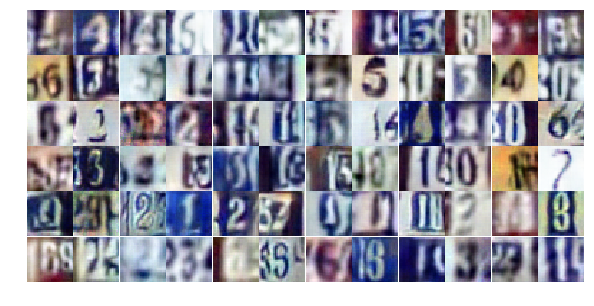

Epoch 21/25... Discriminator Loss: 1.2316... Generator Loss: 0.5355
Epoch 21/25... Discriminator Loss: 1.6752... Generator Loss: 0.3216
Epoch 21/25... Discriminator Loss: 0.8450... Generator Loss: 0.8539
Epoch 21/25... Discriminator Loss: 0.5406... Generator Loss: 1.4737
Epoch 21/25... Discriminator Loss: 0.9087... Generator Loss: 0.7162
Epoch 21/25... Discriminator Loss: 0.4274... Generator Loss: 1.4038
Epoch 21/25... Discriminator Loss: 1.2281... Generator Loss: 0.5385
Epoch 21/25... Discriminator Loss: 1.0650... Generator Loss: 2.4306
Epoch 21/25... Discriminator Loss: 0.6781... Generator Loss: 1.0247
Epoch 21/25... Discriminator Loss: 1.1390... Generator Loss: 0.5968


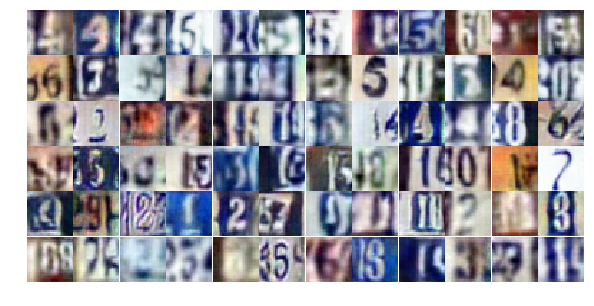

Epoch 21/25... Discriminator Loss: 0.3067... Generator Loss: 1.8934
Epoch 21/25... Discriminator Loss: 1.2800... Generator Loss: 0.4451
Epoch 21/25... Discriminator Loss: 1.9575... Generator Loss: 0.2433
Epoch 21/25... Discriminator Loss: 1.6048... Generator Loss: 0.4611
Epoch 21/25... Discriminator Loss: 0.5106... Generator Loss: 1.3916
Epoch 21/25... Discriminator Loss: 0.8437... Generator Loss: 0.8845
Epoch 21/25... Discriminator Loss: 0.9434... Generator Loss: 0.7033
Epoch 21/25... Discriminator Loss: 0.3826... Generator Loss: 1.8559
Epoch 21/25... Discriminator Loss: 0.6409... Generator Loss: 1.1809
Epoch 21/25... Discriminator Loss: 0.6879... Generator Loss: 1.1870


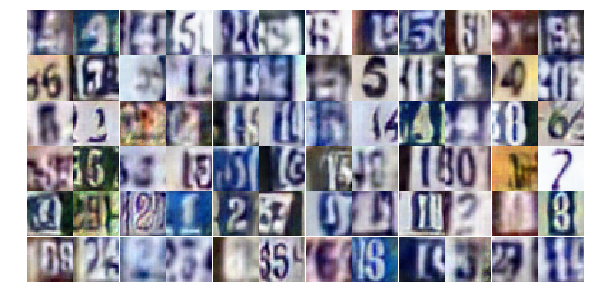

Epoch 21/25... Discriminator Loss: 1.0501... Generator Loss: 0.6784
Epoch 21/25... Discriminator Loss: 0.5734... Generator Loss: 1.2174
Epoch 21/25... Discriminator Loss: 1.1963... Generator Loss: 0.5272
Epoch 21/25... Discriminator Loss: 1.1767... Generator Loss: 0.5326
Epoch 21/25... Discriminator Loss: 0.8534... Generator Loss: 0.9324
Epoch 21/25... Discriminator Loss: 1.3615... Generator Loss: 0.4262
Epoch 21/25... Discriminator Loss: 0.3936... Generator Loss: 1.7647
Epoch 21/25... Discriminator Loss: 1.0356... Generator Loss: 0.6601
Epoch 21/25... Discriminator Loss: 1.0298... Generator Loss: 0.6185
Epoch 21/25... Discriminator Loss: 1.8172... Generator Loss: 0.2964


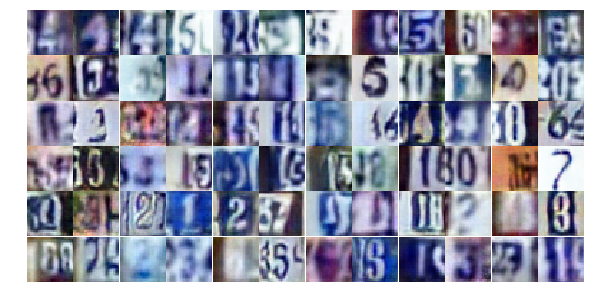

Epoch 21/25... Discriminator Loss: 1.7339... Generator Loss: 0.2811
Epoch 21/25... Discriminator Loss: 0.8716... Generator Loss: 0.9847
Epoch 21/25... Discriminator Loss: 1.0165... Generator Loss: 0.6565
Epoch 21/25... Discriminator Loss: 0.5722... Generator Loss: 1.1236
Epoch 21/25... Discriminator Loss: 0.6081... Generator Loss: 1.0769
Epoch 21/25... Discriminator Loss: 0.7223... Generator Loss: 1.0856
Epoch 21/25... Discriminator Loss: 1.4070... Generator Loss: 0.4139
Epoch 21/25... Discriminator Loss: 1.3123... Generator Loss: 0.4360
Epoch 21/25... Discriminator Loss: 0.7343... Generator Loss: 1.0975
Epoch 21/25... Discriminator Loss: 0.3483... Generator Loss: 2.2322


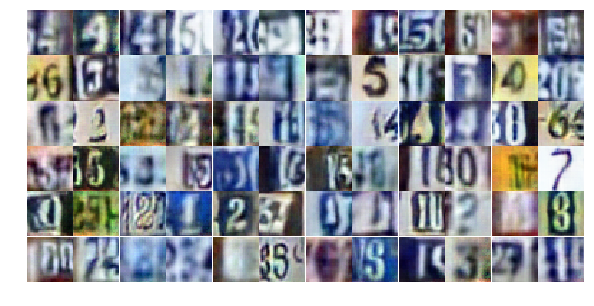

Epoch 21/25... Discriminator Loss: 0.6019... Generator Loss: 2.0795
Epoch 21/25... Discriminator Loss: 0.9342... Generator Loss: 0.7615
Epoch 21/25... Discriminator Loss: 0.9323... Generator Loss: 0.6443
Epoch 21/25... Discriminator Loss: 1.5417... Generator Loss: 0.3937
Epoch 21/25... Discriminator Loss: 0.3804... Generator Loss: 2.1701
Epoch 21/25... Discriminator Loss: 0.4853... Generator Loss: 2.0869
Epoch 21/25... Discriminator Loss: 0.9155... Generator Loss: 0.7496
Epoch 21/25... Discriminator Loss: 1.0539... Generator Loss: 0.7709
Epoch 21/25... Discriminator Loss: 0.8706... Generator Loss: 0.7555
Epoch 21/25... Discriminator Loss: 0.7626... Generator Loss: 0.9633


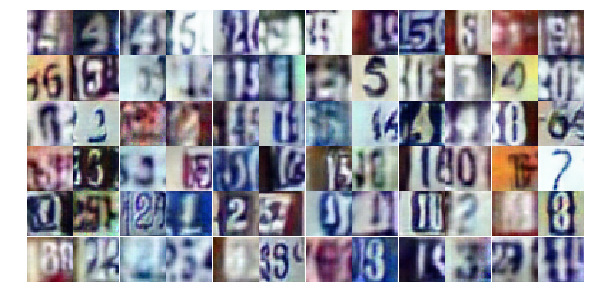

Epoch 21/25... Discriminator Loss: 0.7058... Generator Loss: 1.1385
Epoch 21/25... Discriminator Loss: 1.4492... Generator Loss: 0.3816
Epoch 21/25... Discriminator Loss: 0.8193... Generator Loss: 1.0276
Epoch 22/25... Discriminator Loss: 0.5752... Generator Loss: 1.3478
Epoch 22/25... Discriminator Loss: 1.0608... Generator Loss: 0.6947
Epoch 22/25... Discriminator Loss: 0.8556... Generator Loss: 0.8427
Epoch 22/25... Discriminator Loss: 0.5703... Generator Loss: 1.2208
Epoch 22/25... Discriminator Loss: 0.4729... Generator Loss: 1.4806
Epoch 22/25... Discriminator Loss: 1.5636... Generator Loss: 0.3714
Epoch 22/25... Discriminator Loss: 1.1938... Generator Loss: 0.5061


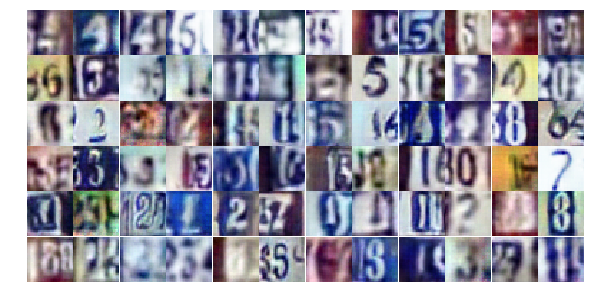

Epoch 22/25... Discriminator Loss: 0.8972... Generator Loss: 0.7866
Epoch 22/25... Discriminator Loss: 0.7848... Generator Loss: 1.4288
Epoch 22/25... Discriminator Loss: 1.4753... Generator Loss: 0.3808
Epoch 22/25... Discriminator Loss: 0.6911... Generator Loss: 1.1013
Epoch 22/25... Discriminator Loss: 0.8666... Generator Loss: 0.8167
Epoch 22/25... Discriminator Loss: 0.7453... Generator Loss: 0.8883
Epoch 22/25... Discriminator Loss: 0.9367... Generator Loss: 0.6858
Epoch 22/25... Discriminator Loss: 0.5469... Generator Loss: 1.1370
Epoch 22/25... Discriminator Loss: 0.9700... Generator Loss: 0.7335
Epoch 22/25... Discriminator Loss: 1.8584... Generator Loss: 0.3096


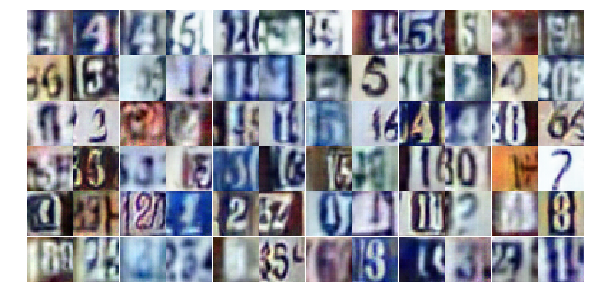

Epoch 22/25... Discriminator Loss: 1.1984... Generator Loss: 0.7815
Epoch 22/25... Discriminator Loss: 1.0307... Generator Loss: 2.4220
Epoch 22/25... Discriminator Loss: 1.2112... Generator Loss: 0.5393
Epoch 22/25... Discriminator Loss: 0.5680... Generator Loss: 1.1973
Epoch 22/25... Discriminator Loss: 0.4765... Generator Loss: 1.9718
Epoch 22/25... Discriminator Loss: 1.1244... Generator Loss: 0.5887
Epoch 22/25... Discriminator Loss: 0.5768... Generator Loss: 1.1028
Epoch 22/25... Discriminator Loss: 0.4295... Generator Loss: 1.5720
Epoch 22/25... Discriminator Loss: 0.9009... Generator Loss: 0.7147
Epoch 22/25... Discriminator Loss: 0.9896... Generator Loss: 0.7097


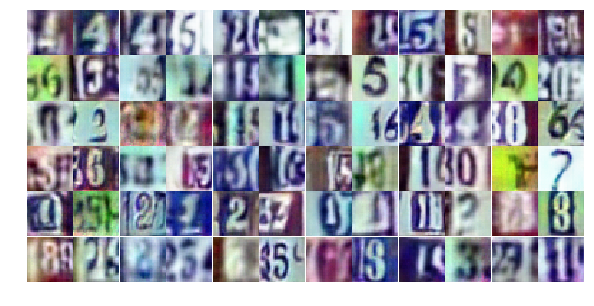

Epoch 22/25... Discriminator Loss: 0.4261... Generator Loss: 1.6180
Epoch 22/25... Discriminator Loss: 0.6613... Generator Loss: 0.9475
Epoch 22/25... Discriminator Loss: 0.9279... Generator Loss: 0.7449
Epoch 22/25... Discriminator Loss: 0.9604... Generator Loss: 0.7196
Epoch 22/25... Discriminator Loss: 0.7515... Generator Loss: 1.1065
Epoch 22/25... Discriminator Loss: 1.0678... Generator Loss: 0.6279
Epoch 22/25... Discriminator Loss: 1.6042... Generator Loss: 0.3087
Epoch 22/25... Discriminator Loss: 0.9480... Generator Loss: 2.6348
Epoch 22/25... Discriminator Loss: 0.8450... Generator Loss: 1.1566
Epoch 22/25... Discriminator Loss: 0.6837... Generator Loss: 1.3208


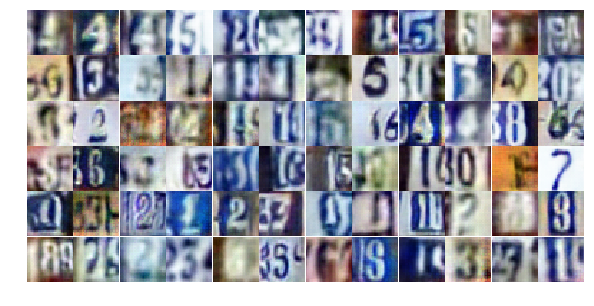

Epoch 22/25... Discriminator Loss: 0.8300... Generator Loss: 0.9292
Epoch 22/25... Discriminator Loss: 0.7832... Generator Loss: 0.9175
Epoch 22/25... Discriminator Loss: 0.4742... Generator Loss: 1.5341
Epoch 22/25... Discriminator Loss: 0.6223... Generator Loss: 1.2035
Epoch 22/25... Discriminator Loss: 0.6377... Generator Loss: 1.0567
Epoch 22/25... Discriminator Loss: 0.6030... Generator Loss: 1.1588
Epoch 22/25... Discriminator Loss: 0.7630... Generator Loss: 1.0555
Epoch 22/25... Discriminator Loss: 0.8872... Generator Loss: 0.8146
Epoch 22/25... Discriminator Loss: 1.3054... Generator Loss: 0.5243
Epoch 22/25... Discriminator Loss: 0.6304... Generator Loss: 1.2049


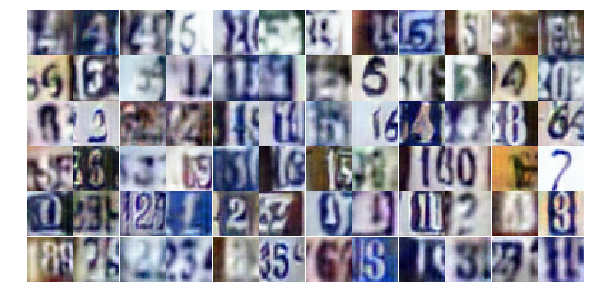

Epoch 22/25... Discriminator Loss: 1.2562... Generator Loss: 0.4626
Epoch 22/25... Discriminator Loss: 0.5836... Generator Loss: 1.0880
Epoch 22/25... Discriminator Loss: 0.8560... Generator Loss: 0.7997
Epoch 22/25... Discriminator Loss: 0.7098... Generator Loss: 1.0057
Epoch 22/25... Discriminator Loss: 1.2254... Generator Loss: 0.6205
Epoch 22/25... Discriminator Loss: 0.7744... Generator Loss: 1.3728
Epoch 22/25... Discriminator Loss: 0.9830... Generator Loss: 0.7371
Epoch 22/25... Discriminator Loss: 0.5834... Generator Loss: 1.1973
Epoch 22/25... Discriminator Loss: 0.7271... Generator Loss: 1.2946
Epoch 22/25... Discriminator Loss: 0.6976... Generator Loss: 1.0068


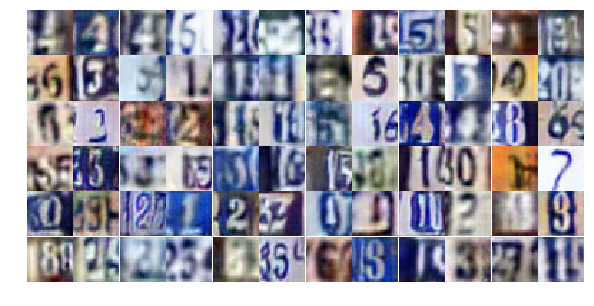

Epoch 23/25... Discriminator Loss: 0.5919... Generator Loss: 1.2685
Epoch 23/25... Discriminator Loss: 0.4959... Generator Loss: 1.3869
Epoch 23/25... Discriminator Loss: 0.9804... Generator Loss: 0.6392
Epoch 23/25... Discriminator Loss: 0.7020... Generator Loss: 0.9901
Epoch 23/25... Discriminator Loss: 0.8408... Generator Loss: 0.8516
Epoch 23/25... Discriminator Loss: 1.1941... Generator Loss: 0.4912
Epoch 23/25... Discriminator Loss: 1.3889... Generator Loss: 0.4152
Epoch 23/25... Discriminator Loss: 0.8543... Generator Loss: 0.8135
Epoch 23/25... Discriminator Loss: 0.6343... Generator Loss: 1.5370
Epoch 23/25... Discriminator Loss: 0.4014... Generator Loss: 1.8430


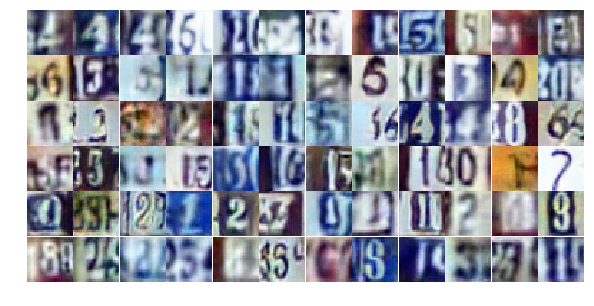

Epoch 23/25... Discriminator Loss: 0.5443... Generator Loss: 1.2527
Epoch 23/25... Discriminator Loss: 0.5860... Generator Loss: 1.3352
Epoch 23/25... Discriminator Loss: 0.7251... Generator Loss: 2.2334
Epoch 23/25... Discriminator Loss: 1.4532... Generator Loss: 0.4361
Epoch 23/25... Discriminator Loss: 0.7711... Generator Loss: 0.8944
Epoch 23/25... Discriminator Loss: 1.1772... Generator Loss: 0.5313
Epoch 23/25... Discriminator Loss: 1.2572... Generator Loss: 0.5121
Epoch 23/25... Discriminator Loss: 0.6085... Generator Loss: 1.8146
Epoch 23/25... Discriminator Loss: 1.1070... Generator Loss: 0.5693
Epoch 23/25... Discriminator Loss: 0.7761... Generator Loss: 0.9787


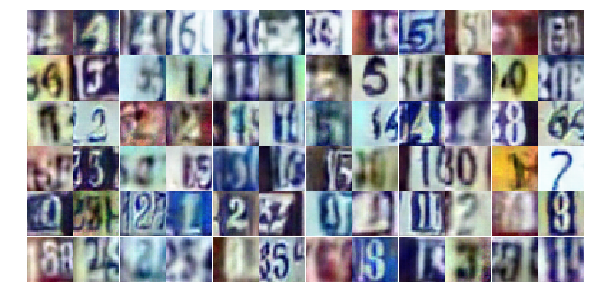

Epoch 23/25... Discriminator Loss: 1.2583... Generator Loss: 0.5428
Epoch 23/25... Discriminator Loss: 0.8327... Generator Loss: 0.9532
Epoch 23/25... Discriminator Loss: 1.0752... Generator Loss: 0.5512
Epoch 23/25... Discriminator Loss: 0.8362... Generator Loss: 0.8229
Epoch 23/25... Discriminator Loss: 0.6384... Generator Loss: 1.2854
Epoch 23/25... Discriminator Loss: 0.5958... Generator Loss: 1.2707
Epoch 23/25... Discriminator Loss: 0.8243... Generator Loss: 0.8243
Epoch 23/25... Discriminator Loss: 0.7900... Generator Loss: 0.9074
Epoch 23/25... Discriminator Loss: 0.8159... Generator Loss: 0.8283
Epoch 23/25... Discriminator Loss: 1.0399... Generator Loss: 0.6969


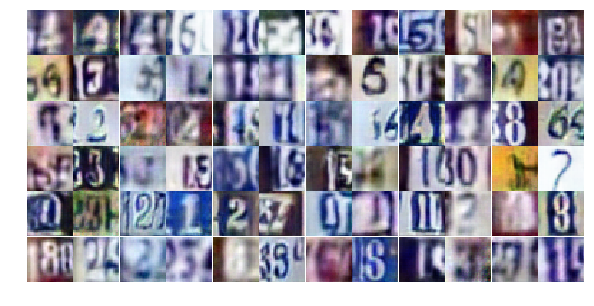

Epoch 23/25... Discriminator Loss: 0.5714... Generator Loss: 1.1333
Epoch 23/25... Discriminator Loss: 0.7470... Generator Loss: 1.0261
Epoch 23/25... Discriminator Loss: 0.6213... Generator Loss: 1.2038
Epoch 23/25... Discriminator Loss: 1.2497... Generator Loss: 0.5259
Epoch 23/25... Discriminator Loss: 0.6700... Generator Loss: 1.2383
Epoch 23/25... Discriminator Loss: 0.9422... Generator Loss: 0.7331
Epoch 23/25... Discriminator Loss: 1.7344... Generator Loss: 0.3101
Epoch 23/25... Discriminator Loss: 0.6519... Generator Loss: 1.0748
Epoch 23/25... Discriminator Loss: 0.5907... Generator Loss: 1.1774
Epoch 23/25... Discriminator Loss: 0.5908... Generator Loss: 1.2900


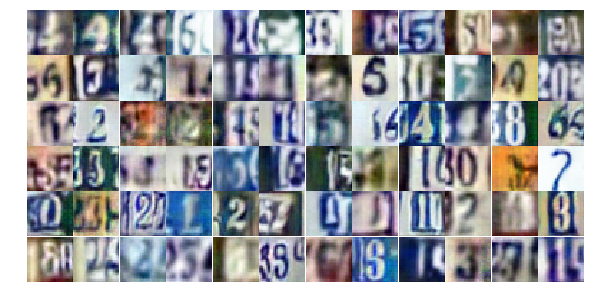

Epoch 23/25... Discriminator Loss: 0.7829... Generator Loss: 1.0192
Epoch 23/25... Discriminator Loss: 1.1072... Generator Loss: 0.5869
Epoch 23/25... Discriminator Loss: 0.4729... Generator Loss: 1.9121
Epoch 23/25... Discriminator Loss: 0.8167... Generator Loss: 1.4037
Epoch 23/25... Discriminator Loss: 0.7173... Generator Loss: 1.0672
Epoch 23/25... Discriminator Loss: 1.5465... Generator Loss: 0.3666
Epoch 23/25... Discriminator Loss: 0.9409... Generator Loss: 0.7941
Epoch 23/25... Discriminator Loss: 0.9862... Generator Loss: 0.7911
Epoch 23/25... Discriminator Loss: 0.8287... Generator Loss: 0.9041
Epoch 23/25... Discriminator Loss: 1.0634... Generator Loss: 0.7389


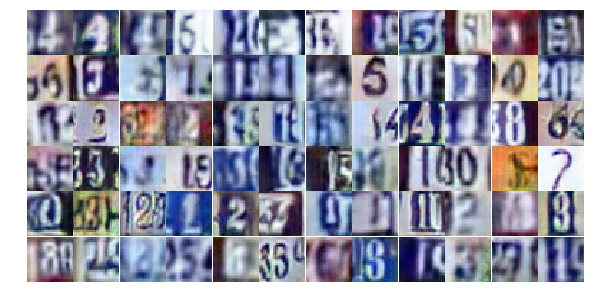

Epoch 23/25... Discriminator Loss: 0.8324... Generator Loss: 0.8240
Epoch 23/25... Discriminator Loss: 1.4547... Generator Loss: 0.4153
Epoch 23/25... Discriminator Loss: 1.0811... Generator Loss: 0.6182
Epoch 23/25... Discriminator Loss: 0.2940... Generator Loss: 2.3655
Epoch 23/25... Discriminator Loss: 1.6583... Generator Loss: 2.5444
Epoch 23/25... Discriminator Loss: 0.7912... Generator Loss: 1.5946
Epoch 23/25... Discriminator Loss: 1.2340... Generator Loss: 0.5741
Epoch 24/25... Discriminator Loss: 0.5682... Generator Loss: 1.4044
Epoch 24/25... Discriminator Loss: 0.9752... Generator Loss: 0.7377
Epoch 24/25... Discriminator Loss: 0.9306... Generator Loss: 0.8993


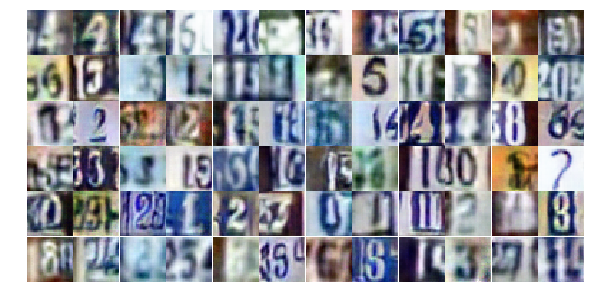

Epoch 24/25... Discriminator Loss: 0.7385... Generator Loss: 1.1065
Epoch 24/25... Discriminator Loss: 1.0346... Generator Loss: 0.9132
Epoch 24/25... Discriminator Loss: 0.7795... Generator Loss: 0.9229
Epoch 24/25... Discriminator Loss: 0.9843... Generator Loss: 1.3793
Epoch 24/25... Discriminator Loss: 0.8073... Generator Loss: 0.7928
Epoch 24/25... Discriminator Loss: 0.5982... Generator Loss: 1.2387
Epoch 24/25... Discriminator Loss: 0.5425... Generator Loss: 1.3348
Epoch 24/25... Discriminator Loss: 1.3180... Generator Loss: 0.4480
Epoch 24/25... Discriminator Loss: 0.4458... Generator Loss: 1.2941
Epoch 24/25... Discriminator Loss: 0.6102... Generator Loss: 1.2432


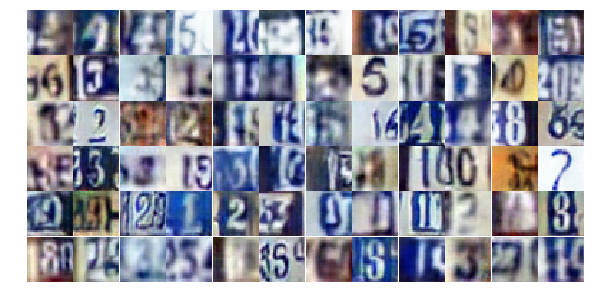

Epoch 24/25... Discriminator Loss: 1.2026... Generator Loss: 0.6472
Epoch 24/25... Discriminator Loss: 0.9741... Generator Loss: 0.6798
Epoch 24/25... Discriminator Loss: 1.4195... Generator Loss: 0.4234
Epoch 24/25... Discriminator Loss: 0.8221... Generator Loss: 0.7723
Epoch 24/25... Discriminator Loss: 0.4917... Generator Loss: 1.6974
Epoch 24/25... Discriminator Loss: 0.9561... Generator Loss: 0.7985
Epoch 24/25... Discriminator Loss: 0.5764... Generator Loss: 1.0977
Epoch 24/25... Discriminator Loss: 1.1533... Generator Loss: 0.5263
Epoch 24/25... Discriminator Loss: 0.6880... Generator Loss: 1.2260
Epoch 24/25... Discriminator Loss: 1.2285... Generator Loss: 0.5228


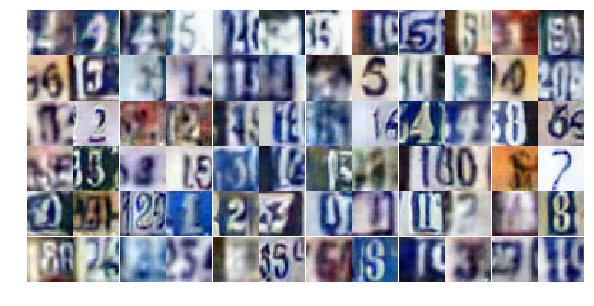

Epoch 24/25... Discriminator Loss: 1.2744... Generator Loss: 0.5728
Epoch 24/25... Discriminator Loss: 0.6140... Generator Loss: 1.1490
Epoch 24/25... Discriminator Loss: 0.6076... Generator Loss: 1.6606
Epoch 24/25... Discriminator Loss: 1.5935... Generator Loss: 0.3598
Epoch 24/25... Discriminator Loss: 0.7537... Generator Loss: 0.9298
Epoch 24/25... Discriminator Loss: 0.5750... Generator Loss: 1.2284
Epoch 24/25... Discriminator Loss: 0.5229... Generator Loss: 1.2626
Epoch 24/25... Discriminator Loss: 0.6110... Generator Loss: 1.3911
Epoch 24/25... Discriminator Loss: 0.6684... Generator Loss: 1.1109
Epoch 24/25... Discriminator Loss: 0.7485... Generator Loss: 1.0547


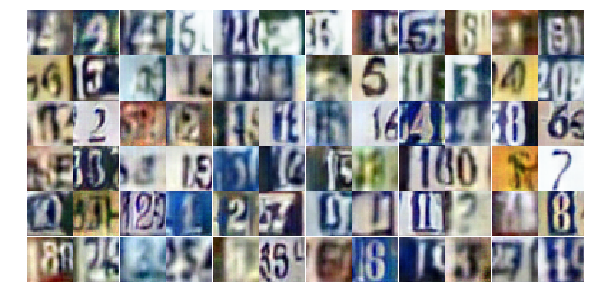

Epoch 24/25... Discriminator Loss: 0.6016... Generator Loss: 1.3250
Epoch 24/25... Discriminator Loss: 0.6156... Generator Loss: 0.9858
Epoch 24/25... Discriminator Loss: 0.9042... Generator Loss: 1.2055
Epoch 24/25... Discriminator Loss: 1.6031... Generator Loss: 0.3816
Epoch 24/25... Discriminator Loss: 0.8873... Generator Loss: 0.8621
Epoch 24/25... Discriminator Loss: 0.8893... Generator Loss: 0.8690
Epoch 24/25... Discriminator Loss: 1.1552... Generator Loss: 0.5663
Epoch 24/25... Discriminator Loss: 1.4417... Generator Loss: 0.3990
Epoch 24/25... Discriminator Loss: 1.0672... Generator Loss: 0.6622
Epoch 24/25... Discriminator Loss: 1.2136... Generator Loss: 0.5137


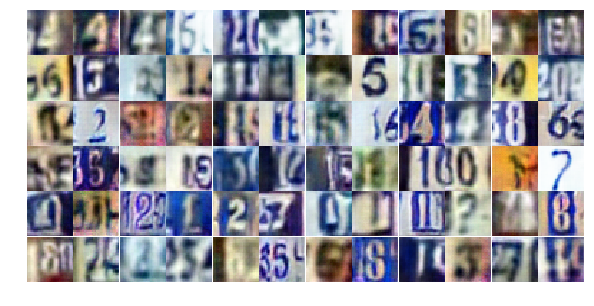

Epoch 24/25... Discriminator Loss: 1.1352... Generator Loss: 0.5911
Epoch 24/25... Discriminator Loss: 1.9461... Generator Loss: 0.2848
Epoch 24/25... Discriminator Loss: 3.3834... Generator Loss: 0.0687
Epoch 24/25... Discriminator Loss: 2.5304... Generator Loss: 3.9721
Epoch 24/25... Discriminator Loss: 1.4688... Generator Loss: 0.5076
Epoch 24/25... Discriminator Loss: 0.7072... Generator Loss: 1.1722
Epoch 24/25... Discriminator Loss: 1.1731... Generator Loss: 0.5733
Epoch 24/25... Discriminator Loss: 0.6394... Generator Loss: 1.2394
Epoch 24/25... Discriminator Loss: 1.0909... Generator Loss: 0.6304
Epoch 24/25... Discriminator Loss: 0.8250... Generator Loss: 1.1155


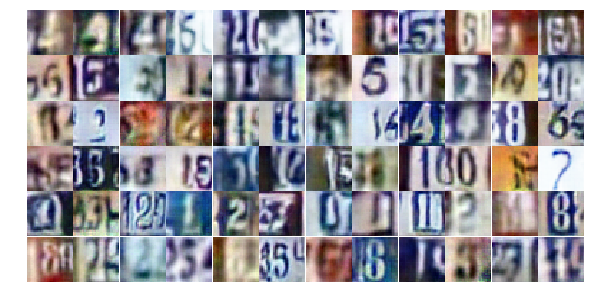

Epoch 24/25... Discriminator Loss: 0.8543... Generator Loss: 0.8134
Epoch 24/25... Discriminator Loss: 1.0907... Generator Loss: 0.5909
Epoch 24/25... Discriminator Loss: 0.7694... Generator Loss: 1.0048
Epoch 24/25... Discriminator Loss: 0.9550... Generator Loss: 0.7881
Epoch 24/25... Discriminator Loss: 1.1615... Generator Loss: 0.5045
Epoch 25/25... Discriminator Loss: 1.0026... Generator Loss: 0.7423
Epoch 25/25... Discriminator Loss: 0.6770... Generator Loss: 1.1176
Epoch 25/25... Discriminator Loss: 0.8612... Generator Loss: 0.7826
Epoch 25/25... Discriminator Loss: 0.4996... Generator Loss: 1.2561
Epoch 25/25... Discriminator Loss: 0.7286... Generator Loss: 0.9607


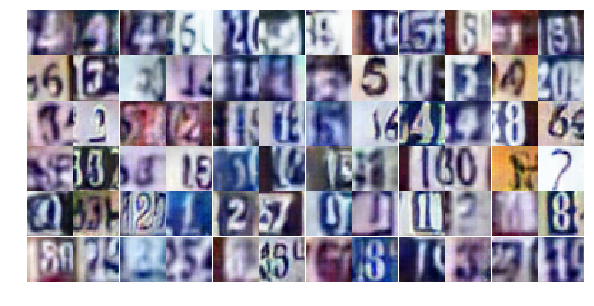

Epoch 25/25... Discriminator Loss: 0.9909... Generator Loss: 0.7068
Epoch 25/25... Discriminator Loss: 0.8943... Generator Loss: 0.8441
Epoch 25/25... Discriminator Loss: 0.8788... Generator Loss: 0.7058
Epoch 25/25... Discriminator Loss: 0.8968... Generator Loss: 0.7479
Epoch 25/25... Discriminator Loss: 0.6606... Generator Loss: 1.3887
Epoch 25/25... Discriminator Loss: 0.9342... Generator Loss: 0.6913
Epoch 25/25... Discriminator Loss: 1.0859... Generator Loss: 0.5617
Epoch 25/25... Discriminator Loss: 0.6993... Generator Loss: 1.2898
Epoch 25/25... Discriminator Loss: 0.4624... Generator Loss: 1.3930
Epoch 25/25... Discriminator Loss: 1.6130... Generator Loss: 0.3654


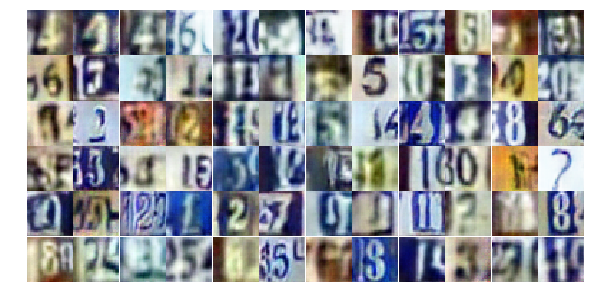

Epoch 25/25... Discriminator Loss: 0.7226... Generator Loss: 1.4392
Epoch 25/25... Discriminator Loss: 0.5476... Generator Loss: 1.7137
Epoch 25/25... Discriminator Loss: 1.2610... Generator Loss: 0.5359
Epoch 25/25... Discriminator Loss: 0.7169... Generator Loss: 1.1267
Epoch 25/25... Discriminator Loss: 0.7302... Generator Loss: 1.2104
Epoch 25/25... Discriminator Loss: 0.6035... Generator Loss: 1.2018
Epoch 25/25... Discriminator Loss: 0.6647... Generator Loss: 1.2251
Epoch 25/25... Discriminator Loss: 1.0818... Generator Loss: 0.7126
Epoch 25/25... Discriminator Loss: 0.7541... Generator Loss: 1.3070
Epoch 25/25... Discriminator Loss: 1.3745... Generator Loss: 0.4933


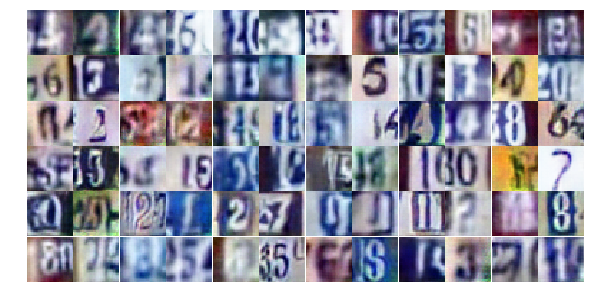

Epoch 25/25... Discriminator Loss: 0.8458... Generator Loss: 0.7482
Epoch 25/25... Discriminator Loss: 0.6647... Generator Loss: 0.9909
Epoch 25/25... Discriminator Loss: 1.7657... Generator Loss: 0.3626
Epoch 25/25... Discriminator Loss: 0.6909... Generator Loss: 1.0058
Epoch 25/25... Discriminator Loss: 0.9881... Generator Loss: 0.7355
Epoch 25/25... Discriminator Loss: 0.6321... Generator Loss: 1.0435
Epoch 25/25... Discriminator Loss: 1.2682... Generator Loss: 0.5045
Epoch 25/25... Discriminator Loss: 0.7453... Generator Loss: 0.9600
Epoch 25/25... Discriminator Loss: 0.8872... Generator Loss: 1.1399
Epoch 25/25... Discriminator Loss: 0.4644... Generator Loss: 1.4980


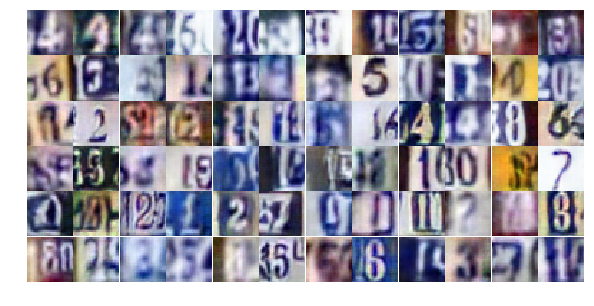

Epoch 25/25... Discriminator Loss: 1.0753... Generator Loss: 0.7113
Epoch 25/25... Discriminator Loss: 0.4990... Generator Loss: 1.2958
Epoch 25/25... Discriminator Loss: 0.9655... Generator Loss: 0.7702
Epoch 25/25... Discriminator Loss: 0.7959... Generator Loss: 0.8543
Epoch 25/25... Discriminator Loss: 1.0779... Generator Loss: 0.6067
Epoch 25/25... Discriminator Loss: 0.6067... Generator Loss: 1.5240
Epoch 25/25... Discriminator Loss: 0.6601... Generator Loss: 1.0048
Epoch 25/25... Discriminator Loss: 0.6878... Generator Loss: 1.8433
Epoch 25/25... Discriminator Loss: 2.2268... Generator Loss: 0.1916
Epoch 25/25... Discriminator Loss: 0.7073... Generator Loss: 1.0628


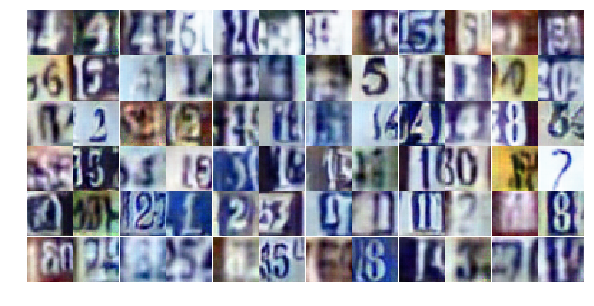

Epoch 25/25... Discriminator Loss: 0.8398... Generator Loss: 0.8375
Epoch 25/25... Discriminator Loss: 0.8436... Generator Loss: 0.8784
Epoch 25/25... Discriminator Loss: 0.9750... Generator Loss: 1.3677
Epoch 25/25... Discriminator Loss: 0.8019... Generator Loss: 0.9303
Epoch 25/25... Discriminator Loss: 1.2310... Generator Loss: 0.5096
Epoch 25/25... Discriminator Loss: 0.8770... Generator Loss: 0.7951
Epoch 25/25... Discriminator Loss: 0.9588... Generator Loss: 0.7220
Epoch 25/25... Discriminator Loss: 0.5487... Generator Loss: 2.0687
Epoch 25/25... Discriminator Loss: 0.6618... Generator Loss: 1.2348
Epoch 25/25... Discriminator Loss: 0.8552... Generator Loss: 0.9416


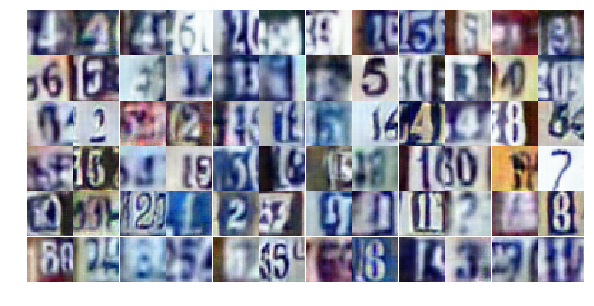

Epoch 25/25... Discriminator Loss: 0.4532... Generator Loss: 2.2290
Epoch 25/25... Discriminator Loss: 1.5748... Generator Loss: 0.3726


In [107]:
# Load the data and train the network here
dataset = Dataset(trainset, testset)
losses, samples = train(net, dataset, epochs, batch_size, figsize=(10,5))

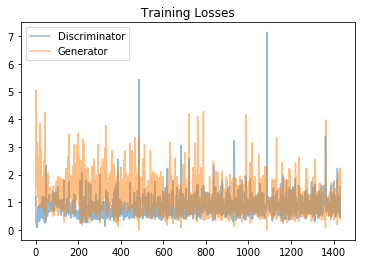

In [108]:
fig, ax = plt.subplots()
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminator', alpha=0.5)
plt.plot(losses.T[1], label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()

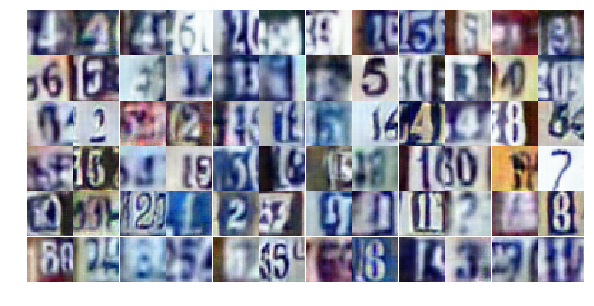

In [109]:
_ = view_samples(-1, samples, 6, 12, figsize=(10,5))